# Problem Statement

A large company named XYZ, employs, at any given point of time, around 4000 employees. However, every year, around 15% of its employees leave the company and need to be replaced with the talent pool available in the job market. The management believes that this level of attrition (employees leaving, either on their own or because they got fired) is bad for the company, because of the following reasons -

The former employees’ projects get delayed, which makes it difficult to meet timelines, resulting in a reputation loss among consumers and partners
A sizeable department has to be maintained, for the purposes of recruiting new talent
More often than not, the new employees have to be trained for the job and/or given time to acclimatise themselves to the company
Hence, the management has contracted an HR analytics firm to understand what factors they should focus on, in order to curb attrition. In other words, they want to know what changes they should make to their workplace, in order to get most of their employees to stay. Also, they want to know which of these variables is most important and needs to be addressed right away.

# Goal of the case study

We are required to model the probability of attrition using a logistic regression. The results thus obtained will be used by the management to understand what changes they should make to their workplace, in order to get most of their employees to stay.

## Step 1: Reading and Understanding the Data

###   Importing Necessary Libraries

In [426]:
# Suppressing Warnings
import warnings
warnings.filterwarnings('ignore')

import numpy as np
import pandas as pd
pd.set_option('display.max_columns', None)

from pandas.api.types import is_object_dtype


import matplotlib.pyplot as plt
plt.style.use('seaborn-white')
import seaborn as sns



try:
    from pandas_profiling import ProfileReport
except:
    !pip install pandas-profiling
    from pandas_profiling import ProfileReport
    
try:
    import sweetviz as sv
except:
    !pip install sweetviz
    import sweetviz as sv


try:
    from autoviz.AutoViz_Class import AutoViz_Class
except:
    !pip install autoviz
    from autoviz.AutoViz_Class import AutoViz_Class  


try:
    import dtale
except:
    !pip install dtale
    import dtale


from scipy.stats import chi2_contingency
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import RobustScaler
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.feature_selection import RFECV,RFE
import sklearn.linear_model as lm
from sklearn.model_selection import cross_val_score
import statsmodels.api as sm
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_recall_curve

### Read Raw Datasets

In [427]:
in_time              = pd.read_csv('in_time.csv')
manager_survey_data  = pd.read_csv('manager_survey_data.csv')
employee_survey_data = pd.read_csv('employee_survey_data.csv')
out_time             = pd.read_csv('out_time.csv')
general_data         = pd.read_csv('general_data.csv')

### Analyzing in_time dataset

In [428]:
profile = ProfileReport(in_time, minimal=True)
profile

In [429]:
in_time.head()

,Unnamed: 0,2015-01-01,2015-01-02,2015-01-05,2015-01-06,2015-01-07,2015-01-08,2015-01-09,2015-01-12,2015-01-13,2015-01-14,2015-01-15,2015-01-16,2015-01-19,2015-01-20,2015-01-21,2015-01-22,2015-01-23,2015-01-26,2015-01-27,2015-01-28,2015-01-29,2015-01-30,2015-02-02,2015-02-03,2015-02-04,2015-02-05,2015-02-06,2015-02-09,2015-02-10,2015-02-11,2015-02-12,2015-02-13,2015-02-16,2015-02-17,2015-02-18,2015-02-19,2015-02-20,2015-02-23,2015-02-24,2015-02-25,2015-02-26,2015-02-27,2015-03-02,2015-03-03,2015-03-04,2015-03-05,2015-03-06,2015-03-09,2015-03-10,2015-03-11,2015-03-12,2015-03-13,2015-03-16,2015-03-17,2015-03-18,2015-03-19,2015-03-20,2015-03-23,2015-03-24,2015-03-25,2015-03-26,2015-03-27,2015-03-30,2015-03-31,2015-04-01,2015-04-02,2015-04-03,2015-04-06,2015-04-07,2015-04-08,2015-04-09,2015-04-10,2015-04-13,2015-04-14,2015-04-15,2015-04-16,2015-04-17,2015-04-20,2015-04-21,2015-04-22,2015-04-23,2015-04-24,2015-04-27,2015-04-28,2015-04-29,2015-04-30,2015-05-01,2015-05-04,2015-05-05,2015-05-06,2015-05-07,2015-05-08,2015-05-11,2015-05-12,2015-05-13,2015-05-14,2015-05-15,2015-05-18,2015-05-19,2015-05-20,2015-05-21,2015-05-22,2015-05-25,2015-05-26,2015-05-27,2015-05-28,2015-05-29,2015-06-01,2015-06-02,2015-06-03,2015-06-04,2015-06-05,2015-06-08,2015-06-09,2015-06-10,2015-06-11,2015-06-12,2015-06-15,2015-06-16,2015-06-17,2015-06-18,2015-06-19,2015-06-22,2015-06-23,2015-06-24,2015-06-25,2015-06-26,2015-06-29,2015-06-30,2015-07-01,2015-07-02,2015-07-03,2015-07-06,2015-07-07,2015-07-08,2015-07-09,2015-07-10,2015-07-13,2015-07-14,2015-07-15,2015-07-16,2015-07-17,2015-07-20,2015-07-21,2015-07-22,2015-07-23,2015-07-24,2015-07-27,2015-07-28,2015-07-29,2015-07-30,2015-07-31,2015-08-03,2015-08-04,2015-08-05,2015-08-06,2015-08-07,2015-08-10,2015-08-11,2015-08-12,2015-08-13,2015-08-14,2015-08-17,2015-08-18,2015-08-19,2015-08-20,2015-08-21,2015-08-24,2015-08-25,2015-08-26,2015-08-27,2015-08-28,2015-08-31,2015-09-01,2015-09-02,2015-09-03,2015-09-04,2015-09-07,2015-09-08,2015-09-09,2015-09-10,2015-09-11,2015-09-14,2015-09-15,2015-09-16,2015-09-17,2015-09-18,2015-09-21,2015-09-22,2015-09-23,2015-09-24,2015-09-25,2015-09-28,2015-09-29,2015-09-30,2015-10-01,2015-10-02,2015-10-05,2015-10-06,2015-10-07,2015-10-08,2015-10-09,2015-10-12,2015-10-13,2015-10-14,2015-10-15,2015-10-16,2015-10-19,2015-10-20,2015-10-21,2015-10-22,2015-10-23,2015-10-26,2015-10-27,2015-10-28,2015-10-29,2015-10-30,2015-11-02,2015-11-03,2015-11-04,2015-11-05,2015-11-06,2015-11-09,2015-11-10,2015-11-11,2015-11-12,2015-11-13,2015-11-16,2015-11-17,2015-11-18,2015-11-19,2015-11-20,2015-11-23,2015-11-24,2015-11-25,2015-11-26,2015-11-27,2015-11-30,2015-12-01,2015-12-02,2015-12-03,2015-12-04,2015-12-07,2015-12-08,2015-12-09,2015-12-10,2015-12-11,2015-12-14,2015-12-15,2015-12-16,2015-12-17,2015-12-18,2015-12-21,2015-12-22,2015-12-23,2015-12-24,2015-12-25,2015-12-28,2015-12-29,2015-12-30,2015-12-31
0,1,NaN,2015-01-02 09:43:45,2015-01-05 10:08:48,2015-01-06 09:54:26,2015-01-07 09:34:31,2015-01-08 09:51:09,2015-01-09 10:09:25,2015-01-12 09:42:53,2015-01-13 10:13:06,NaN,2015-01-15 10:01:24,2015-01-16 10:19:08,NaN,2015-01-20 09:50:34,2015-01-21 09:49:42,2015-01-22 09:47:45,2015-01-23 09:23:44,NaN,2015-01-27 09:50:37,2015-01-28 09:56:13,2015-01-29 09:53:47,2015-01-30 10:09:26,2015-02-02 09:38:43,2015-02-03 10:23:38,2015-02-04 09:48:37,2015-02-05 09:52:36,2015-02-06 09:53:23,2015-02-09 10:01:45,2015-02-10 10:14:18,2015-02-11 10:18:44,2015-02-12 10:10:35,2015-02-13 09:13:07,2015-02-16 10:14:02,2015-02-17 10:03:08,2015-02-18 10:23:06,NaN,2015-02-20 09:54:56,2015-02-23 09:46:59,2015-02-24 10:11:18,2015-02-25 09:52:36,2015-02-26 09:56:33,2015-02-27 09:58:46,2015-03-02 10:19:43,2015-03-03 10:08:37,2015-03-04 10:05:38,NaN,2015-03-06 09:55:53,2015-03-09 10:28:34,2015-03-10 09:47:30,2015-03-11 09:48:59,2015-03-12 10:10:51,2015-03-13 10:07:18,NaN,2015-03-17 10:05:22,2015-03-18 10:28:21,2015-03-19 10:01:52,2015-03-20 10:37:49,2015-03-23 10:11:19,2015-03-24 10:33:19,2015-03-25 09:41:35,NaN,2015-03-27 09:47:30,2

In [430]:
in_time=in_time.replace(np.nan,0)
in_time.head()

,Unnamed: 0,2015-01-01,2015-01-02,2015-01-05,2015-01-06,2015-01-07,2015-01-08,2015-01-09,2015-01-12,2015-01-13,2015-01-14,2015-01-15,2015-01-16,2015-01-19,2015-01-20,2015-01-21,2015-01-22,2015-01-23,2015-01-26,2015-01-27,2015-01-28,2015-01-29,2015-01-30,2015-02-02,2015-02-03,2015-02-04,2015-02-05,2015-02-06,2015-02-09,2015-02-10,2015-02-11,2015-02-12,2015-02-13,2015-02-16,2015-02-17,2015-02-18,2015-02-19,2015-02-20,2015-02-23,2015-02-24,2015-02-25,2015-02-26,2015-02-27,2015-03-02,2015-03-03,2015-03-04,2015-03-05,2015-03-06,2015-03-09,2015-03-10,2015-03-11,2015-03-12,2015-03-13,2015-03-16,2015-03-17,2015-03-18,2015-03-19,2015-03-20,2015-03-23,2015-03-24,2015-03-25,2015-03-26,2015-03-27,2015-03-30,2015-03-31,2015-04-01,2015-04-02,2015-04-03,2015-04-06,2015-04-07,2015-04-08,2015-04-09,2015-04-10,2015-04-13,2015-04-14,2015-04-15,2015-04-16,2015-04-17,2015-04-20,2015-04-21,2015-04-22,2015-04-23,2015-04-24,2015-04-27,2015-04-28,2015-04-29,2015-04-30,2015-05-01,2015-05-04,2015-05-05,2015-05-06,2015-05-07,2015-05-08,2015-05-11,2015-05-12,2015-05-13,2015-05-14,2015-05-15,2015-05-18,2015-05-19,2015-05-20,2015-05-21,2015-05-22,2015-05-25,2015-05-26,2015-05-27,2015-05-28,2015-05-29,2015-06-01,2015-06-02,2015-06-03,2015-06-04,2015-06-05,2015-06-08,2015-06-09,2015-06-10,2015-06-11,2015-06-12,2015-06-15,2015-06-16,2015-06-17,2015-06-18,2015-06-19,2015-06-22,2015-06-23,2015-06-24,2015-06-25,2015-06-26,2015-06-29,2015-06-30,2015-07-01,2015-07-02,2015-07-03,2015-07-06,2015-07-07,2015-07-08,2015-07-09,2015-07-10,2015-07-13,2015-07-14,2015-07-15,2015-07-16,2015-07-17,2015-07-20,2015-07-21,2015-07-22,2015-07-23,2015-07-24,2015-07-27,2015-07-28,2015-07-29,2015-07-30,2015-07-31,2015-08-03,2015-08-04,2015-08-05,2015-08-06,2015-08-07,2015-08-10,2015-08-11,2015-08-12,2015-08-13,2015-08-14,2015-08-17,2015-08-18,2015-08-19,2015-08-20,2015-08-21,2015-08-24,2015-08-25,2015-08-26,2015-08-27,2015-08-28,2015-08-31,2015-09-01,2015-09-02,2015-09-03,2015-09-04,2015-09-07,2015-09-08,2015-09-09,2015-09-10,2015-09-11,2015-09-14,2015-09-15,2015-09-16,2015-09-17,2015-09-18,2015-09-21,2015-09-22,2015-09-23,2015-09-24,2015-09-25,2015-09-28,2015-09-29,2015-09-30,2015-10-01,2015-10-02,2015-10-05,2015-10-06,2015-10-07,2015-10-08,2015-10-09,2015-10-12,2015-10-13,2015-10-14,2015-10-15,2015-10-16,2015-10-19,2015-10-20,2015-10-21,2015-10-22,2015-10-23,2015-10-26,2015-10-27,2015-10-28,2015-10-29,2015-10-30,2015-11-02,2015-11-03,2015-11-04,2015-11-05,2015-11-06,2015-11-09,2015-11-10,2015-11-11,2015-11-12,2015-11-13,2015-11-16,2015-11-17,2015-11-18,2015-11-19,2015-11-20,2015-11-23,2015-11-24,2015-11-25,2015-11-26,2015-11-27,2015-11-30,2015-12-01,2015-12-02,2015-12-03,2015-12-04,2015-12-07,2015-12-08,2015-12-09,2015-12-10,2015-12-11,2015-12-14,2015-12-15,2015-12-16,2015-12-17,2015-12-18,2015-12-21,2015-12-22,2015-12-23,2015-12-24,2015-12-25,2015-12-28,2015-12-29,2015-12-30,2015-12-31
0,1,0.0,2015-01-02 09:43:45,2015-01-05 10:08:48,2015-01-06 09:54:26,2015-01-07 09:34:31,2015-01-08 09:51:09,2015-01-09 10:09:25,2015-01-12 09:42:53,2015-01-13 10:13:06,0.0,2015-01-15 10:01:24,2015-01-16 10:19:08,0,2015-01-20 09:50:34,2015-01-21 09:49:42,2015-01-22 09:47:45,2015-01-23 09:23:44,0.0,2015-01-27 09:50:37,2015-01-28 09:56:13,2015-01-29 09:53:47,2015-01-30 10:09:26,2015-02-02 09:38:43,2015-02-03 10:23:38,2015-02-04 09:48:37,2015-02-05 09:52:36,2015-02-06 09:53:23,2015-02-09 10:01:45,2015-02-10 10:14:18,2015-02-11 10:18:44,2015-02-12 10:10:35,2015-02-13 09:13:07,2015-02-16 10:14:02,2015-02-17 10:03:08,2015-02-18 10:23:06,0,2015-02-20 09:54:56,2015-02-23 09:46:59,2015-02-24 10:11:18,2015-02-25 09:52:36,2015-02-26 09:56:33,2015-02-27 09:58:46,2015-03-02 10:19:43,2015-03-03 10:08:37,2015-03-04 10:05:38,0.0,2015-03-06 09:55:53,2015-03-09 10:28:34,2015-03-10 09:47:30,2015-03-11 09:48:59,2015-03-12 10:10:51,2015-03-13 10:07:18,0,2015-03-17 10:05:22,2015-03-18 10:28:21,2015-03-19 10:01:52,2015-03-20 10:37:49,2015-03-23 10:11:19,2015-03-24 10:33:19,2015-03-25 09:41:35,0,2015-03-27 09:47:30,2015-03-3

In [431]:
in_time.iloc[:, 1:] = in_time.iloc[:, 1:].apply(pd.to_datetime, errors='coerce')

In [432]:
in_time.head()

,Unnamed: 0,2015-01-01,2015-01-02,2015-01-05,2015-01-06,2015-01-07,2015-01-08,2015-01-09,2015-01-12,2015-01-13,2015-01-14,2015-01-15,2015-01-16,2015-01-19,2015-01-20,2015-01-21,2015-01-22,2015-01-23,2015-01-26,2015-01-27,2015-01-28,2015-01-29,2015-01-30,2015-02-02,2015-02-03,2015-02-04,2015-02-05,2015-02-06,2015-02-09,2015-02-10,2015-02-11,2015-02-12,2015-02-13,2015-02-16,2015-02-17,2015-02-18,2015-02-19,2015-02-20,2015-02-23,2015-02-24,2015-02-25,2015-02-26,2015-02-27,2015-03-02,2015-03-03,2015-03-04,2015-03-05,2015-03-06,2015-03-09,2015-03-10,2015-03-11,2015-03-12,2015-03-13,2015-03-16,2015-03-17,2015-03-18,2015-03-19,2015-03-20,2015-03-23,2015-03-24,2015-03-25,2015-03-26,2015-03-27,2015-03-30,2015-03-31,2015-04-01,2015-04-02,2015-04-03,2015-04-06,2015-04-07,2015-04-08,2015-04-09,2015-04-10,2015-04-13,2015-04-14,2015-04-15,2015-04-16,2015-04-17,2015-04-20,2015-04-21,2015-04-22,2015-04-23,2015-04-24,2015-04-27,2015-04-28,2015-04-29,2015-04-30,2015-05-01,2015-05-04,2015-05-05,2015-05-06,2015-05-07,2015-05-08,2015-05-11,2015-05-12,2015-05-13,2015-05-14,2015-05-15,2015-05-18,2015-05-19,2015-05-20,2015-05-21,2015-05-22,2015-05-25,2015-05-26,2015-05-27,2015-05-28,2015-05-29,2015-06-01,2015-06-02,2015-06-03,2015-06-04,2015-06-05,2015-06-08,2015-06-09,2015-06-10,2015-06-11,2015-06-12,2015-06-15,2015-06-16,2015-06-17,2015-06-18,2015-06-19,2015-06-22,2015-06-23,2015-06-24,2015-06-25,2015-06-26,2015-06-29,2015-06-30,2015-07-01,2015-07-02,2015-07-03,2015-07-06,2015-07-07,2015-07-08,2015-07-09,2015-07-10,2015-07-13,2015-07-14,2015-07-15,2015-07-16,2015-07-17,2015-07-20,2015-07-21,2015-07-22,2015-07-23,2015-07-24,2015-07-27,2015-07-28,2015-07-29,2015-07-30,2015-07-31,2015-08-03,2015-08-04,2015-08-05,2015-08-06,2015-08-07,2015-08-10,2015-08-11,2015-08-12,2015-08-13,2015-08-14,2015-08-17,2015-08-18,2015-08-19,2015-08-20,2015-08-21,2015-08-24,2015-08-25,2015-08-26,2015-08-27,2015-08-28,2015-08-31,2015-09-01,2015-09-02,2015-09-03,2015-09-04,2015-09-07,2015-09-08,2015-09-09,2015-09-10,2015-09-11,2015-09-14,2015-09-15,2015-09-16,2015-09-17,2015-09-18,2015-09-21,2015-09-22,2015-09-23,2015-09-24,2015-09-25,2015-09-28,2015-09-29,2015-09-30,2015-10-01,2015-10-02,2015-10-05,2015-10-06,2015-10-07,2015-10-08,2015-10-09,2015-10-12,2015-10-13,2015-10-14,2015-10-15,2015-10-16,2015-10-19,2015-10-20,2015-10-21,2015-10-22,2015-10-23,2015-10-26,2015-10-27,2015-10-28,2015-10-29,2015-10-30,2015-11-02,2015-11-03,2015-11-04,2015-11-05,2015-11-06,2015-11-09,2015-11-10,2015-11-11,2015-11-12,2015-11-13,2015-11-16,2015-11-17,2015-11-18,2015-11-19,2015-11-20,2015-11-23,2015-11-24,2015-11-25,2015-11-26,2015-11-27,2015-11-30,2015-12-01,2015-12-02,2015-12-03,2015-12-04,2015-12-07,2015-12-08,2015-12-09,2015-12-10,2015-12-11,2015-12-14,2015-12-15,2015-12-16,2015-12-17,2015-12-18,2015-12-21,2015-12-22,2015-12-23,2015-12-24,2015-12-25,2015-12-28,2015-12-29,2015-12-30,2015-12-31
0,1,1970-01-01,2015-01-02 09:43:45,2015-01-05 10:08:48,2015-01-06 09:54:26,2015-01-07 09:34:31,2015-01-08 09:51:09,2015-01-09 10:09:25,2015-01-12 09:42:53,2015-01-13 10:13:06,1970-01-01,2015-01-15 10:01:24,2015-01-16 10:19:08,1970-01-01 00:00:00,2015-01-20 09:50:34,2015-01-21 09:49:42,2015-01-22 09:47:45,2015-01-23 09:23:44,1970-01-01,2015-01-27 09:50:37,2015-01-28 09:56:13,2015-01-29 09:53:47,2015-01-30 10:09:26,2015-02-02 09:38:43,2015-02-03 10:23:38,2015-02-04 09:48:37,2015-02-05 09:52:36,2015-02-06 09:53:23,2015-02-09 10:01:45,2015-02-10 10:14:18,2015-02-11 10:18:44,2015-02-12 10:10:35,2015-02-13 09:13:07,2015-02-16 10:14:02,2015-02-17 10:03:08,2015-02-18 10:23:06,1970-01-01 00:00:00,2015-02-20 09:54:56,2015-02-23 09:46:59,2015-02-24 10:11:18,2015-02-25 09:52:36,2015-02-26 09:56:33,2015-02-27 09:58:46,2015-03-02 10:19:43,2015-03-03 10:08:37,2015-03-04 10:05:38,1970-01-01,2015-03-06 09:55:53,2015-03-09 10:28:34,2015-03-10 09:47:30,2015-03-11 09:48:59,2015-03-12 10:10:51,2015-03-13 10:07:18,1970-01-01 00:00:00,2015-03-17 10:05:22,2015-03-18 10:28:21,2015-03-19 10:01:52,2015-03-20 10:37:49,2015-03-2

### Analyzing out_time dataset

In [433]:
profile = ProfileReport(out_time, minimal=True)
profile

In [434]:
out_time=out_time.replace(np.nan,0)
out_time.head()

,Unnamed: 0,2015-01-01,2015-01-02,2015-01-05,2015-01-06,2015-01-07,2015-01-08,2015-01-09,2015-01-12,2015-01-13,2015-01-14,2015-01-15,2015-01-16,2015-01-19,2015-01-20,2015-01-21,2015-01-22,2015-01-23,2015-01-26,2015-01-27,2015-01-28,2015-01-29,2015-01-30,2015-02-02,2015-02-03,2015-02-04,2015-02-05,2015-02-06,2015-02-09,2015-02-10,2015-02-11,2015-02-12,2015-02-13,2015-02-16,2015-02-17,2015-02-18,2015-02-19,2015-02-20,2015-02-23,2015-02-24,2015-02-25,2015-02-26,2015-02-27,2015-03-02,2015-03-03,2015-03-04,2015-03-05,2015-03-06,2015-03-09,2015-03-10,2015-03-11,2015-03-12,2015-03-13,2015-03-16,2015-03-17,2015-03-18,2015-03-19,2015-03-20,2015-03-23,2015-03-24,2015-03-25,2015-03-26,2015-03-27,2015-03-30,2015-03-31,2015-04-01,2015-04-02,2015-04-03,2015-04-06,2015-04-07,2015-04-08,2015-04-09,2015-04-10,2015-04-13,2015-04-14,2015-04-15,2015-04-16,2015-04-17,2015-04-20,2015-04-21,2015-04-22,2015-04-23,2015-04-24,2015-04-27,2015-04-28,2015-04-29,2015-04-30,2015-05-01,2015-05-04,2015-05-05,2015-05-06,2015-05-07,2015-05-08,2015-05-11,2015-05-12,2015-05-13,2015-05-14,2015-05-15,2015-05-18,2015-05-19,2015-05-20,2015-05-21,2015-05-22,2015-05-25,2015-05-26,2015-05-27,2015-05-28,2015-05-29,2015-06-01,2015-06-02,2015-06-03,2015-06-04,2015-06-05,2015-06-08,2015-06-09,2015-06-10,2015-06-11,2015-06-12,2015-06-15,2015-06-16,2015-06-17,2015-06-18,2015-06-19,2015-06-22,2015-06-23,2015-06-24,2015-06-25,2015-06-26,2015-06-29,2015-06-30,2015-07-01,2015-07-02,2015-07-03,2015-07-06,2015-07-07,2015-07-08,2015-07-09,2015-07-10,2015-07-13,2015-07-14,2015-07-15,2015-07-16,2015-07-17,2015-07-20,2015-07-21,2015-07-22,2015-07-23,2015-07-24,2015-07-27,2015-07-28,2015-07-29,2015-07-30,2015-07-31,2015-08-03,2015-08-04,2015-08-05,2015-08-06,2015-08-07,2015-08-10,2015-08-11,2015-08-12,2015-08-13,2015-08-14,2015-08-17,2015-08-18,2015-08-19,2015-08-20,2015-08-21,2015-08-24,2015-08-25,2015-08-26,2015-08-27,2015-08-28,2015-08-31,2015-09-01,2015-09-02,2015-09-03,2015-09-04,2015-09-07,2015-09-08,2015-09-09,2015-09-10,2015-09-11,2015-09-14,2015-09-15,2015-09-16,2015-09-17,2015-09-18,2015-09-21,2015-09-22,2015-09-23,2015-09-24,2015-09-25,2015-09-28,2015-09-29,2015-09-30,2015-10-01,2015-10-02,2015-10-05,2015-10-06,2015-10-07,2015-10-08,2015-10-09,2015-10-12,2015-10-13,2015-10-14,2015-10-15,2015-10-16,2015-10-19,2015-10-20,2015-10-21,2015-10-22,2015-10-23,2015-10-26,2015-10-27,2015-10-28,2015-10-29,2015-10-30,2015-11-02,2015-11-03,2015-11-04,2015-11-05,2015-11-06,2015-11-09,2015-11-10,2015-11-11,2015-11-12,2015-11-13,2015-11-16,2015-11-17,2015-11-18,2015-11-19,2015-11-20,2015-11-23,2015-11-24,2015-11-25,2015-11-26,2015-11-27,2015-11-30,2015-12-01,2015-12-02,2015-12-03,2015-12-04,2015-12-07,2015-12-08,2015-12-09,2015-12-10,2015-12-11,2015-12-14,2015-12-15,2015-12-16,2015-12-17,2015-12-18,2015-12-21,2015-12-22,2015-12-23,2015-12-24,2015-12-25,2015-12-28,2015-12-29,2015-12-30,2015-12-31
0,1,0.0,2015-01-02 16:56:15,2015-01-05 17:20:11,2015-01-06 17:19:05,2015-01-07 16:34:55,2015-01-08 17:08:32,2015-01-09 17:38:29,2015-01-12 16:58:39,2015-01-13 18:02:58,0.0,2015-01-15 17:22:13,2015-01-16 17:35:11,0,2015-01-20 16:37:07,2015-01-21 16:55:24,2015-01-22 16:50:47,2015-01-23 17:00:01,0.0,2015-01-27 17:28:22,2015-01-28 17:03:21,2015-01-29 17:18:36,2015-01-30 17:00:25,2015-02-02 16:32:49,2015-02-03 17:35:49,2015-02-04 17:24:56,2015-02-05 17:26:31,2015-02-06 17:21:35,2015-02-09 17:37:50,2015-02-10 17:30:20,2015-02-11 17:30:19,2015-02-12 17:36:42,2015-02-13 16:25:26,2015-02-16 17:50:23,2015-02-17 17:28:06,2015-02-18 18:13:29,0,2015-02-20 17:44:52,2015-02-23 17:13:27,2015-02-24 17:24:48,2015-02-25 17:27:37,2015-02-26 17:08:36,2015-02-27 17:21:55,2015-03-02 17:29:08,2015-03-03 16:54:12,2015-03-04 17:50:18,0.0,2015-03-06 17:44:47,2015-03-09 17:53:05,2015-03-10 16:42:53,2015-03-11 16:58:39,2015-03-12 17:15:39,2015-03-13 17:25:55,0,2015-03-17 17:00:16,2015-03-18 17:40:13,2015-03-19 17:52:44,2015-03-20 17:47:34,2015-03-23 17:48:18,2015-03-24 17:48:26,2015-03-25 17:08:19,0,2015-03-27 17:20:51,2015-03-3

In [435]:
out_time.iloc[:, 1:] = out_time.iloc[:, 1:].apply(pd.to_datetime, errors='coerce')

In [436]:
out_time.head()

,Unnamed: 0,2015-01-01,2015-01-02,2015-01-05,2015-01-06,2015-01-07,2015-01-08,2015-01-09,2015-01-12,2015-01-13,2015-01-14,2015-01-15,2015-01-16,2015-01-19,2015-01-20,2015-01-21,2015-01-22,2015-01-23,2015-01-26,2015-01-27,2015-01-28,2015-01-29,2015-01-30,2015-02-02,2015-02-03,2015-02-04,2015-02-05,2015-02-06,2015-02-09,2015-02-10,2015-02-11,2015-02-12,2015-02-13,2015-02-16,2015-02-17,2015-02-18,2015-02-19,2015-02-20,2015-02-23,2015-02-24,2015-02-25,2015-02-26,2015-02-27,2015-03-02,2015-03-03,2015-03-04,2015-03-05,2015-03-06,2015-03-09,2015-03-10,2015-03-11,2015-03-12,2015-03-13,2015-03-16,2015-03-17,2015-03-18,2015-03-19,2015-03-20,2015-03-23,2015-03-24,2015-03-25,2015-03-26,2015-03-27,2015-03-30,2015-03-31,2015-04-01,2015-04-02,2015-04-03,2015-04-06,2015-04-07,2015-04-08,2015-04-09,2015-04-10,2015-04-13,2015-04-14,2015-04-15,2015-04-16,2015-04-17,2015-04-20,2015-04-21,2015-04-22,2015-04-23,2015-04-24,2015-04-27,2015-04-28,2015-04-29,2015-04-30,2015-05-01,2015-05-04,2015-05-05,2015-05-06,2015-05-07,2015-05-08,2015-05-11,2015-05-12,2015-05-13,2015-05-14,2015-05-15,2015-05-18,2015-05-19,2015-05-20,2015-05-21,2015-05-22,2015-05-25,2015-05-26,2015-05-27,2015-05-28,2015-05-29,2015-06-01,2015-06-02,2015-06-03,2015-06-04,2015-06-05,2015-06-08,2015-06-09,2015-06-10,2015-06-11,2015-06-12,2015-06-15,2015-06-16,2015-06-17,2015-06-18,2015-06-19,2015-06-22,2015-06-23,2015-06-24,2015-06-25,2015-06-26,2015-06-29,2015-06-30,2015-07-01,2015-07-02,2015-07-03,2015-07-06,2015-07-07,2015-07-08,2015-07-09,2015-07-10,2015-07-13,2015-07-14,2015-07-15,2015-07-16,2015-07-17,2015-07-20,2015-07-21,2015-07-22,2015-07-23,2015-07-24,2015-07-27,2015-07-28,2015-07-29,2015-07-30,2015-07-31,2015-08-03,2015-08-04,2015-08-05,2015-08-06,2015-08-07,2015-08-10,2015-08-11,2015-08-12,2015-08-13,2015-08-14,2015-08-17,2015-08-18,2015-08-19,2015-08-20,2015-08-21,2015-08-24,2015-08-25,2015-08-26,2015-08-27,2015-08-28,2015-08-31,2015-09-01,2015-09-02,2015-09-03,2015-09-04,2015-09-07,2015-09-08,2015-09-09,2015-09-10,2015-09-11,2015-09-14,2015-09-15,2015-09-16,2015-09-17,2015-09-18,2015-09-21,2015-09-22,2015-09-23,2015-09-24,2015-09-25,2015-09-28,2015-09-29,2015-09-30,2015-10-01,2015-10-02,2015-10-05,2015-10-06,2015-10-07,2015-10-08,2015-10-09,2015-10-12,2015-10-13,2015-10-14,2015-10-15,2015-10-16,2015-10-19,2015-10-20,2015-10-21,2015-10-22,2015-10-23,2015-10-26,2015-10-27,2015-10-28,2015-10-29,2015-10-30,2015-11-02,2015-11-03,2015-11-04,2015-11-05,2015-11-06,2015-11-09,2015-11-10,2015-11-11,2015-11-12,2015-11-13,2015-11-16,2015-11-17,2015-11-18,2015-11-19,2015-11-20,2015-11-23,2015-11-24,2015-11-25,2015-11-26,2015-11-27,2015-11-30,2015-12-01,2015-12-02,2015-12-03,2015-12-04,2015-12-07,2015-12-08,2015-12-09,2015-12-10,2015-12-11,2015-12-14,2015-12-15,2015-12-16,2015-12-17,2015-12-18,2015-12-21,2015-12-22,2015-12-23,2015-12-24,2015-12-25,2015-12-28,2015-12-29,2015-12-30,2015-12-31
0,1,1970-01-01,2015-01-02 16:56:15,2015-01-05 17:20:11,2015-01-06 17:19:05,2015-01-07 16:34:55,2015-01-08 17:08:32,2015-01-09 17:38:29,2015-01-12 16:58:39,2015-01-13 18:02:58,1970-01-01,2015-01-15 17:22:13,2015-01-16 17:35:11,1970-01-01 00:00:00,2015-01-20 16:37:07,2015-01-21 16:55:24,2015-01-22 16:50:47,2015-01-23 17:00:01,1970-01-01,2015-01-27 17:28:22,2015-01-28 17:03:21,2015-01-29 17:18:36,2015-01-30 17:00:25,2015-02-02 16:32:49,2015-02-03 17:35:49,2015-02-04 17:24:56,2015-02-05 17:26:31,2015-02-06 17:21:35,2015-02-09 17:37:50,2015-02-10 17:30:20,2015-02-11 17:30:19,2015-02-12 17:36:42,2015-02-13 16:25:26,2015-02-16 17:50:23,2015-02-17 17:28:06,2015-02-18 18:13:29,1970-01-01 00:00:00,2015-02-20 17:44:52,2015-02-23 17:13:27,2015-02-24 17:24:48,2015-02-25 17:27:37,2015-02-26 17:08:36,2015-02-27 17:21:55,2015-03-02 17:29:08,2015-03-03 16:54:12,2015-03-04 17:50:18,1970-01-01,2015-03-06 17:44:47,2015-03-09 17:53:05,2015-03-10 16:42:53,2015-03-11 16:58:39,2015-03-12 17:15:39,2015-03-13 17:25:55,1970-01-01 00:00:00,2015-03-17 17:00:16,2015-03-18 17:40:13,2015-03-19 17:52:44,2015-03-20 17:47:34,2015-03-2

### Merging in_time and out_time datasets`

In [437]:
time=in_time.append(out_time) # the out time dataset will append below the in time dataset

In [438]:
time.head()

,Unnamed: 0,2015-01-01,2015-01-02,2015-01-05,2015-01-06,2015-01-07,2015-01-08,2015-01-09,2015-01-12,2015-01-13,2015-01-14,2015-01-15,2015-01-16,2015-01-19,2015-01-20,2015-01-21,2015-01-22,2015-01-23,2015-01-26,2015-01-27,2015-01-28,2015-01-29,2015-01-30,2015-02-02,2015-02-03,2015-02-04,2015-02-05,2015-02-06,2015-02-09,2015-02-10,2015-02-11,2015-02-12,2015-02-13,2015-02-16,2015-02-17,2015-02-18,2015-02-19,2015-02-20,2015-02-23,2015-02-24,2015-02-25,2015-02-26,2015-02-27,2015-03-02,2015-03-03,2015-03-04,2015-03-05,2015-03-06,2015-03-09,2015-03-10,2015-03-11,2015-03-12,2015-03-13,2015-03-16,2015-03-17,2015-03-18,2015-03-19,2015-03-20,2015-03-23,2015-03-24,2015-03-25,2015-03-26,2015-03-27,2015-03-30,2015-03-31,2015-04-01,2015-04-02,2015-04-03,2015-04-06,2015-04-07,2015-04-08,2015-04-09,2015-04-10,2015-04-13,2015-04-14,2015-04-15,2015-04-16,2015-04-17,2015-04-20,2015-04-21,2015-04-22,2015-04-23,2015-04-24,2015-04-27,2015-04-28,2015-04-29,2015-04-30,2015-05-01,2015-05-04,2015-05-05,2015-05-06,2015-05-07,2015-05-08,2015-05-11,2015-05-12,2015-05-13,2015-05-14,2015-05-15,2015-05-18,2015-05-19,2015-05-20,2015-05-21,2015-05-22,2015-05-25,2015-05-26,2015-05-27,2015-05-28,2015-05-29,2015-06-01,2015-06-02,2015-06-03,2015-06-04,2015-06-05,2015-06-08,2015-06-09,2015-06-10,2015-06-11,2015-06-12,2015-06-15,2015-06-16,2015-06-17,2015-06-18,2015-06-19,2015-06-22,2015-06-23,2015-06-24,2015-06-25,2015-06-26,2015-06-29,2015-06-30,2015-07-01,2015-07-02,2015-07-03,2015-07-06,2015-07-07,2015-07-08,2015-07-09,2015-07-10,2015-07-13,2015-07-14,2015-07-15,2015-07-16,2015-07-17,2015-07-20,2015-07-21,2015-07-22,2015-07-23,2015-07-24,2015-07-27,2015-07-28,2015-07-29,2015-07-30,2015-07-31,2015-08-03,2015-08-04,2015-08-05,2015-08-06,2015-08-07,2015-08-10,2015-08-11,2015-08-12,2015-08-13,2015-08-14,2015-08-17,2015-08-18,2015-08-19,2015-08-20,2015-08-21,2015-08-24,2015-08-25,2015-08-26,2015-08-27,2015-08-28,2015-08-31,2015-09-01,2015-09-02,2015-09-03,2015-09-04,2015-09-07,2015-09-08,2015-09-09,2015-09-10,2015-09-11,2015-09-14,2015-09-15,2015-09-16,2015-09-17,2015-09-18,2015-09-21,2015-09-22,2015-09-23,2015-09-24,2015-09-25,2015-09-28,2015-09-29,2015-09-30,2015-10-01,2015-10-02,2015-10-05,2015-10-06,2015-10-07,2015-10-08,2015-10-09,2015-10-12,2015-10-13,2015-10-14,2015-10-15,2015-10-16,2015-10-19,2015-10-20,2015-10-21,2015-10-22,2015-10-23,2015-10-26,2015-10-27,2015-10-28,2015-10-29,2015-10-30,2015-11-02,2015-11-03,2015-11-04,2015-11-05,2015-11-06,2015-11-09,2015-11-10,2015-11-11,2015-11-12,2015-11-13,2015-11-16,2015-11-17,2015-11-18,2015-11-19,2015-11-20,2015-11-23,2015-11-24,2015-11-25,2015-11-26,2015-11-27,2015-11-30,2015-12-01,2015-12-02,2015-12-03,2015-12-04,2015-12-07,2015-12-08,2015-12-09,2015-12-10,2015-12-11,2015-12-14,2015-12-15,2015-12-16,2015-12-17,2015-12-18,2015-12-21,2015-12-22,2015-12-23,2015-12-24,2015-12-25,2015-12-28,2015-12-29,2015-12-30,2015-12-31
0,1,1970-01-01,2015-01-02 09:43:45,2015-01-05 10:08:48,2015-01-06 09:54:26,2015-01-07 09:34:31,2015-01-08 09:51:09,2015-01-09 10:09:25,2015-01-12 09:42:53,2015-01-13 10:13:06,1970-01-01,2015-01-15 10:01:24,2015-01-16 10:19:08,1970-01-01 00:00:00,2015-01-20 09:50:34,2015-01-21 09:49:42,2015-01-22 09:47:45,2015-01-23 09:23:44,1970-01-01,2015-01-27 09:50:37,2015-01-28 09:56:13,2015-01-29 09:53:47,2015-01-30 10:09:26,2015-02-02 09:38:43,2015-02-03 10:23:38,2015-02-04 09:48:37,2015-02-05 09:52:36,2015-02-06 09:53:23,2015-02-09 10:01:45,2015-02-10 10:14:18,2015-02-11 10:18:44,2015-02-12 10:10:35,2015-02-13 09:13:07,2015-02-16 10:14:02,2015-02-17 10:03:08,2015-02-18 10:23:06,1970-01-01 00:00:00,2015-02-20 09:54:56,2015-02-23 09:46:59,2015-02-24 10:11:18,2015-02-25 09:52:36,2015-02-26 09:56:33,2015-02-27 09:58:46,2015-03-02 10:19:43,2015-03-03 10:08:37,2015-03-04 10:05:38,1970-01-01,2015-03-06 09:55:53,2015-03-09 10:28:34,2015-03-10 09:47:30,2015-03-11 09:48:59,2015-03-12 10:10:51,2015-03-13 10:07:18,1970-01-01 00:00:00,2015-03-17 10:05:22,2015-03-18 10:28:21,2015-03-19 10:01:52,2015-03-20 10:37:49,2015-03-2

In [439]:
time=time.diff(periods=4410)#It will have 4410 Nans
time=time.iloc[4410:]  # it will have difference of intime and outtime which is actual hrs worked in each day by each person
time.reset_index(inplace=True)
time.head()

,index,Unnamed: 0,2015-01-01,2015-01-02,2015-01-05,2015-01-06,2015-01-07,2015-01-08,2015-01-09,2015-01-12,2015-01-13,2015-01-14,2015-01-15,2015-01-16,2015-01-19,2015-01-20,2015-01-21,2015-01-22,2015-01-23,2015-01-26,2015-01-27,2015-01-28,2015-01-29,2015-01-30,2015-02-02,2015-02-03,2015-02-04,2015-02-05,2015-02-06,2015-02-09,2015-02-10,2015-02-11,2015-02-12,2015-02-13,2015-02-16,2015-02-17,2015-02-18,2015-02-19,2015-02-20,2015-02-23,2015-02-24,2015-02-25,2015-02-26,2015-02-27,2015-03-02,2015-03-03,2015-03-04,2015-03-05,2015-03-06,2015-03-09,2015-03-10,2015-03-11,2015-03-12,2015-03-13,2015-03-16,2015-03-17,2015-03-18,2015-03-19,2015-03-20,2015-03-23,2015-03-24,2015-03-25,2015-03-26,2015-03-27,2015-03-30,2015-03-31,2015-04-01,2015-04-02,2015-04-03,2015-04-06,2015-04-07,2015-04-08,2015-04-09,2015-04-10,2015-04-13,2015-04-14,2015-04-15,2015-04-16,2015-04-17,2015-04-20,2015-04-21,2015-04-22,2015-04-23,2015-04-24,2015-04-27,2015-04-28,2015-04-29,2015-04-30,2015-05-01,2015-05-04,2015-05-05,2015-05-06,2015-05-07,2015-05-08,2015-05-11,2015-05-12,2015-05-13,2015-05-14,2015-05-15,2015-05-18,2015-05-19,2015-05-20,2015-05-21,2015-05-22,2015-05-25,2015-05-26,2015-05-27,2015-05-28,2015-05-29,2015-06-01,2015-06-02,2015-06-03,2015-06-04,2015-06-05,2015-06-08,2015-06-09,2015-06-10,2015-06-11,2015-06-12,2015-06-15,2015-06-16,2015-06-17,2015-06-18,2015-06-19,2015-06-22,2015-06-23,2015-06-24,2015-06-25,2015-06-26,2015-06-29,2015-06-30,2015-07-01,2015-07-02,2015-07-03,2015-07-06,2015-07-07,2015-07-08,2015-07-09,2015-07-10,2015-07-13,2015-07-14,2015-07-15,2015-07-16,2015-07-17,2015-07-20,2015-07-21,2015-07-22,2015-07-23,2015-07-24,2015-07-27,2015-07-28,2015-07-29,2015-07-30,2015-07-31,2015-08-03,2015-08-04,2015-08-05,2015-08-06,2015-08-07,2015-08-10,2015-08-11,2015-08-12,2015-08-13,2015-08-14,2015-08-17,2015-08-18,2015-08-19,2015-08-20,2015-08-21,2015-08-24,2015-08-25,2015-08-26,2015-08-27,2015-08-28,2015-08-31,2015-09-01,2015-09-02,2015-09-03,2015-09-04,2015-09-07,2015-09-08,2015-09-09,2015-09-10,2015-09-11,2015-09-14,2015-09-15,2015-09-16,2015-09-17,2015-09-18,2015-09-21,2015-09-22,2015-09-23,2015-09-24,2015-09-25,2015-09-28,2015-09-29,2015-09-30,2015-10-01,2015-10-02,2015-10-05,2015-10-06,2015-10-07,2015-10-08,2015-10-09,2015-10-12,2015-10-13,2015-10-14,2015-10-15,2015-10-16,2015-10-19,2015-10-20,2015-10-21,2015-10-22,2015-10-23,2015-10-26,2015-10-27,2015-10-28,2015-10-29,2015-10-30,2015-11-02,2015-11-03,2015-11-04,2015-11-05,2015-11-06,2015-11-09,2015-11-10,2015-11-11,2015-11-12,2015-11-13,2015-11-16,2015-11-17,2015-11-18,2015-11-19,2015-11-20,2015-11-23,2015-11-24,2015-11-25,2015-11-26,2015-11-27,2015-11-30,2015-12-01,2015-12-02,2015-12-03,2015-12-04,2015-12-07,2015-12-08,2015-12-09,2015-12-10,2015-12-11,2015-12-14,2015-12-15,2015-12-16,2015-12-17,2015-12-18,2015-12-21,2015-12-22,2015-12-23,2015-12-24,2015-12-25,2015-12-28,2015-12-29,2015-12-30,2015-12-31
0,0,0.0,0 days,0 days 07:12:30,0 days 07:11:23,0 days 07:24:39,0 days 07:00:24,0 days 07:17:23,0 days 07:29:04,0 days 07:15:46,0 days 07:49:52,0 days,0 days 07:20:49,0 days 07:16:03,0 days 00:00:00,0 days 06:46:33,0 days 07:05:42,0 days 07:03:02,0 days 07:36:17,0 days,0 days 07:37:45,0 days 07:07:08,0 days 07:24:49,0 days 06:50:59,0 days 06:54:06,0 days 07:12:11,0 days 07:36:19,0 days 07:33:55,0 days 07:28:12,0 days 07:36:05,0 days 07:16:02,0 days 07:11:35,0 days 07:26:07,0 days 07:12:19,0 days 07:36:21,0 days 07:24:58,0 days 07:50:23,0 days 00:00:00,0 days 07:49:56,0 days 07:26:28,0 days 07:13:30,0 days 07:35:01,0 days 07:12:03,0 days 07:23:09,0 days 07:09:25,0 days 06:45:35,0 days 07:44:40,0 days,0 days 07:48:54,0 days 07:24:31,0 days 06:55:23,0 days 07:09:40,0 days 07:04:48,0 days 07:18:37,0 days 00:00:00,0 days 06:54:54,0 days 07:11:52,0 days 07:50:52,0 days 07:09:45,0 days 07:36:59,0 days 07:15:07,0 days 07:26:44,0 days 00:00:00,0 days 07:33:21,0 days 07:21:25,0 days 07:51:54,0 days 07:20:13,0 days 07:39:31,0 days 07:11:16,0 days 07:02:27,0 days 07:38:24,0 days 07:25:38,0 days 07:48:11,0 d

In [440]:
time.drop(columns=['index','Unnamed: 0'],axis=1,inplace=True)

In [441]:
time.drop(['2015-01-01', '2015-01-14','2015-01-26','2015-03-05',
             '2015-05-01','2015-07-17','2015-09-17','2015-10-02',
              '2015-11-09','2015-11-10','2015-11-11','2015-12-25'
             ], axis = 1,inplace=True) 

In [442]:
time =time/np.timedelta64(1,'h')

In [443]:
time_summary = pd.DataFrame()
time_summary['Q2 Time']=time.quantile(0.50, axis=1) 

In [444]:
time_summary['EmployeeID']=in_time['Unnamed: 0']
time_summary.head()

,Q2 Time,EmployeeID
0,7.365000,1
1,7.703611,2
2,6.977500,3
3,7.157222,4
4,7.953611,5


### Analyzing general_data dataset

In [445]:
general_data.head()

,Age,Attrition,BusinessTravel,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeID,Gender,JobLevel,JobRole,MaritalStatus,MonthlyIncome,NumCompaniesWorked,Over18,PercentSalaryHike,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,YearsAtCompany,YearsSinceLastPromotion,YearsWithCurrManager
0,51,No,Travel_Rarely,Sales,6,2,Life Sciences,1,1,Female,1,Healthcare Representative,Married,131160,1.0,Y,11,8,0,1.0,6,1,0,0
1,31,Yes,Travel_Frequently,Research & Development,10,1,Life Sciences,1,2,Female,1,Research Scientist,Single,41890,0.0,Y,23,8,1,6.0,3,5,1,4
2,32,No,Travel_Frequently,Research & Development,17,4,Other,1,3,Male,4,Sales Executive,Married,193280,1.0,Y,15,8,3,5.0,2,5,0,3
3,38,No,Non-Travel,Research & Development,2,5,Life Sciences,1,4,Male,3,Human Resources,Married,83210,3.0,Y,11,8,3,13.0,5,8,7,5
4,32,No,Travel_Rarely,Research & Development,10,1,Medical,1,5,Male,1,Sales Executive,Single,23420,4.0,Y,12,8,2,9.0,2,6,0,4


In [446]:
profile = ProfileReport(general_data)
profile

### Analyzing employee_survey_data dataset

In [447]:
employee_survey_data.head()

,EmployeeID,EnvironmentSatisfaction,JobSatisfaction,WorkLifeBalance
0,1,3.0,4.0,2.0
1,2,3.0,2.0,4.0
2,3,2.0,2.0,1.0
3,4,4.0,4.0,3.0
4,5,4.0,1.0,3.0


In [448]:
profile = ProfileReport(employee_survey_data)
profile

### Analyzing manager_survey_data dataset

In [449]:
manager_survey_data.head()

,EmployeeID,JobInvolvement,PerformanceRating
0,1,3,3
1,2,2,4
2,3,3,3
3,4,2,3
4,5,3,3


In [450]:
profile = ProfileReport(manager_survey_data)
profile

### Combining all data files into one consolidated dataframe

In [451]:
hr = pd.merge( general_data, employee_survey_data, how='inner', on='EmployeeID')
hr = pd.merge( hr, manager_survey_data, how='inner', on='EmployeeID')
hr = pd.merge(hr, time_summary, how='inner', on='EmployeeID')
hr.head()

,Age,Attrition,BusinessTravel,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeID,Gender,JobLevel,JobRole,MaritalStatus,MonthlyIncome,NumCompaniesWorked,Over18,PercentSalaryHike,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,YearsAtCompany,YearsSinceLastPromotion,YearsWithCurrManager,EnvironmentSatisfaction,JobSatisfaction,WorkLifeBalance,JobInvolvement,PerformanceRating,Q2 Time
0,51,No,Travel_Rarely,Sales,6,2,Life Sciences,1,1,Female,1,Healthcare Representative,Married,131160,1.0,Y,11,8,0,1.0,6,1,0,0,3.0,4.0,2.0,3,3,7.365000
1,31,Yes,Travel_Frequently,Research & Development,10,1,Life Sciences,1,2,Female,1,Research Scientist,Single,41890,0.0,Y,23,8,1,6.0,3,5,1,4,3.0,2.0,4.0,2,4,7.703611
2,32,No,Travel_Frequently,Research & Development,17,4,Other,1,3,Male,4,Sales Executive,Married,193280,1.0,Y,15,8,3,5.0,2,5,0,3,2.0,2.0,1.0,3,3,6.977500
3,38,No,Non-Travel,Research & Development,2,5,Life Sciences,1,4,Male,3,Human Resources,Married,83210,3.0,Y,11,8,3,13.0,5,8,7,5,4.0,4.0,3.0,2,3,7.157222
4,32,No,Travel_Rarely,Research & Development,10,1,Medical,1,5,Male,1,Sales Executive,Single,23420,4.0,Y,12,8,2,9.0,2,6,0,4,4.0,1.0,3.0,3,3,7.953611


In [452]:
hr.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4410 entries, 0 to 4409
Data columns (total 30 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Age                      4410 non-null   int64  
 1   Attrition                4410 non-null   object 
 2   BusinessTravel           4410 non-null   object 
 3   Department               4410 non-null   object 
 4   DistanceFromHome         4410 non-null   int64  
 5   Education                4410 non-null   int64  
 6   EducationField           4410 non-null   object 
 7   EmployeeCount            4410 non-null   int64  
 8   EmployeeID               4410 non-null   int64  
 9   Gender                   4410 non-null   object 
 10  JobLevel                 4410 non-null   int64  
 11  JobRole                  4410 non-null   object 
 12  MaritalStatus            4410 non-null   object 
 13  MonthlyIncome            4410 non-null   int64  
 14  NumCompaniesWorked      

### Correcting Datatype for the variable `JobLevel`

In [453]:
hr['JobLevel']=hr['JobLevel'].astype('object')

In [454]:
hr['Education']     = hr['Education'].replace({ 1 : 'Below College', 2: 'College',3: 'Bachelor',4: 'Master',5 : 'Doctor'})
hr['EnvironmentSatisfaction'] = hr['EnvironmentSatisfaction'].replace({ 1 : 'Low', 2: 'Medium',3: 'High',4: 'Very High'})
hr['JobInvolvement']          = hr['JobInvolvement'].replace({ 1 : 'Low', 2: 'Medium',3: 'High',4: 'Very High'})
hr['JobSatisfaction']         = hr['JobSatisfaction'].replace({ 1 : 'Low', 2: 'Medium',3: 'High',4: 'Very High'})
hr['PerformanceRating']       = hr['PerformanceRating'].replace({ 1 : 'Low', 2: 'Good',3: 'Excellent',4: 'Outstanding'})
hr['WorkLifeBalance']         = hr['WorkLifeBalance'].replace({ 1 : 'Bad', 2: 'Good',3: 'Better',4: 'Best'})
hr['JobLevel']   = hr['JobLevel'].replace({1:'Level_1',2:'Level_2',3:'Level_3',4:'Level_4', 5:'Level_5'})

In [455]:
hr.head()

,Age,Attrition,BusinessTravel,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeID,Gender,JobLevel,JobRole,MaritalStatus,MonthlyIncome,NumCompaniesWorked,Over18,PercentSalaryHike,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,YearsAtCompany,YearsSinceLastPromotion,YearsWithCurrManager,EnvironmentSatisfaction,JobSatisfaction,WorkLifeBalance,JobInvolvement,PerformanceRating,Q2 Time
0,51,No,Travel_Rarely,Sales,6,College,Life Sciences,1,1,Female,Level_1,Healthcare Representative,Married,131160,1.0,Y,11,8,0,1.0,6,1,0,0,High,Very High,Good,High,Excellent,7.365000
1,31,Yes,Travel_Frequently,Research & Development,10,Below College,Life Sciences,1,2,Female,Level_1,Research Scientist,Single,41890,0.0,Y,23,8,1,6.0,3,5,1,4,High,Medium,Best,Medium,Outstanding,7.703611
2,32,No,Travel_Frequently,Research & Development,17,Master,Other,1,3,Male,Level_4,Sales Executive,Married,193280,1.0,Y,15,8,3,5.0,2,5,0,3,Medium,Medium,Bad,High,Excellent,6.977500
3,38,No,Non-Travel,Research & Development,2,Doctor,Life Sciences,1,4,Male,Level_3,Human Resources,Married,83210,3.0,Y,11,8,3,13.0,5,8,7,5,Very High,Very High,Better,Medium,Excellent,7.157222
4,32,No,Travel_Rarely,Research & Development,10,Below College,Medical,1,5,Male,Level_1,Sales Executive,Single,23420,4.0,Y,12,8,2,9.0,2,6,0,4,Very High,Low,Better,High,Excellent,7.953611


- From the above profile reports, we can see that the variables `EmployeeCount` , `Over18` and `StandardHours` are just constant columns with one variable. 

In [456]:
hr['EmployeeCount'].value_counts(ascending=False)

1    4410
Name: EmployeeCount, dtype: int64

In [457]:
hr['Over18'].value_counts(ascending=False)

Y    4410
Name: Over18, dtype: int64

In [458]:
hr['StandardHours'].value_counts(ascending=False)

8    4410
Name: StandardHours, dtype: int64

### Drop Columns which are not useful for modelling

In [459]:
hr.drop(['EmployeeID', 'EmployeeCount','StandardHours','Over18'], axis = 1,inplace=True) 

In [460]:
hr.head()


,Age,Attrition,BusinessTravel,Department,DistanceFromHome,Education,EducationField,Gender,JobLevel,JobRole,MaritalStatus,MonthlyIncome,NumCompaniesWorked,PercentSalaryHike,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,YearsAtCompany,YearsSinceLastPromotion,YearsWithCurrManager,EnvironmentSatisfaction,JobSatisfaction,WorkLifeBalance,JobInvolvement,PerformanceRating,Q2 Time
0,51,No,Travel_Rarely,Sales,6,College,Life Sciences,Female,Level_1,Healthcare Representative,Married,131160,1.0,11,0,1.0,6,1,0,0,High,Very High,Good,High,Excellent,7.365000
1,31,Yes,Travel_Frequently,Research & Development,10,Below College,Life Sciences,Female,Level_1,Research Scientist,Single,41890,0.0,23,1,6.0,3,5,1,4,High,Medium,Best,Medium,Outstanding,7.703611
2,32,No,Travel_Frequently,Research & Development,17,Master,Other,Male,Level_4,Sales Executive,Married,193280,1.0,15,3,5.0,2,5,0,3,Medium,Medium,Bad,High,Excellent,6.977500
3,38,No,Non-Travel,Research & Development,2,Doctor,Life Sciences,Male,Level_3,Human Resources,Married,83210,3.0,11,3,13.0,5,8,7,5,Very High,Very High,Better,Medium,Excellent,7.157222
4,32,No,Travel_Rarely,Research & Development,10,Below College,Medical,Male,Level_1,Sales Executive,Single,23420,4.0,12,2,9.0,2,6,0,4,Very High,Low,Better,High,Excellent,7.953611


In [461]:
hr.shape

(4410, 26)

In [462]:
hr.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4410 entries, 0 to 4409
Data columns (total 26 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Age                      4410 non-null   int64  
 1   Attrition                4410 non-null   object 
 2   BusinessTravel           4410 non-null   object 
 3   Department               4410 non-null   object 
 4   DistanceFromHome         4410 non-null   int64  
 5   Education                4410 non-null   object 
 6   EducationField           4410 non-null   object 
 7   Gender                   4410 non-null   object 
 8   JobLevel                 4410 non-null   object 
 9   JobRole                  4410 non-null   object 
 10  MaritalStatus            4410 non-null   object 
 11  MonthlyIncome            4410 non-null   int64  
 12  NumCompaniesWorked       4391 non-null   float64
 13  PercentSalaryHike        4410 non-null   int64  
 14  StockOptionLevel        

## Missing values treatment

In [463]:
hr['EnvironmentSatisfaction'].value_counts(ascending=False)

High         1350
Very High    1334
Medium        856
Low           845
Name: EnvironmentSatisfaction, dtype: int64

In [464]:
hr['EnvironmentSatisfaction'] = hr['EnvironmentSatisfaction'].fillna('High')
hr['EnvironmentSatisfaction'].isnull().sum()

0

In [465]:
hr['JobSatisfaction'].value_counts(ascending=False)

Very High    1367
High         1323
Low           860
Medium        840
Name: JobSatisfaction, dtype: int64

In [466]:
hr['JobSatisfaction'] = hr['JobSatisfaction'].fillna('High')
hr['JobSatisfaction'].isnull().sum()


0

In [467]:
hr['WorkLifeBalance'].value_counts(ascending=False)

Better    2660
Good      1019
Best       454
Bad        239
Name: WorkLifeBalance, dtype: int64

In [468]:
hr['WorkLifeBalance'] = hr['WorkLifeBalance'].fillna('Better')
hr['WorkLifeBalance'].isnull().sum()

0

In [469]:
hr['NumCompaniesWorked'].value_counts(ascending=False)

1.0    1558
0.0     586
3.0     474
2.0     438
4.0     415
7.0     222
6.0     208
5.0     187
9.0     156
8.0     147
Name: NumCompaniesWorked, dtype: int64

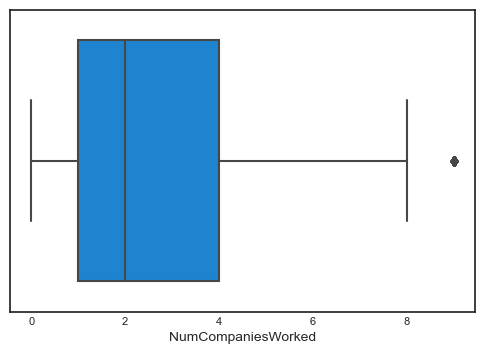

In [470]:
sns.boxplot(x='NumCompaniesWorked',data=hr);

In [471]:
hr['NumCompaniesWorked'] = hr['NumCompaniesWorked'].fillna(2) # From the above graph number of companies worked 
                                                              # has a median value of 2
hr['NumCompaniesWorked'].isnull().sum()

0

In [472]:
hr['TotalWorkingYears'].value_counts(ascending=False)

10.0    605
6.0     375
8.0     307
9.0     287
5.0     264
7.0     243
1.0     242
4.0     189
12.0    144
3.0     126
15.0    120
16.0    111
13.0    108
11.0    106
21.0    102
17.0     99
2.0      93
14.0     93
20.0     89
18.0     81
23.0     66
19.0     66
22.0     62
24.0     54
26.0     42
28.0     42
25.0     42
0.0      33
29.0     30
32.0     27
31.0     27
33.0     21
27.0     21
30.0     21
36.0     18
34.0     15
37.0     12
35.0      9
40.0      6
38.0      3
Name: TotalWorkingYears, dtype: int64

<AxesSubplot:xlabel='TotalWorkingYears'>

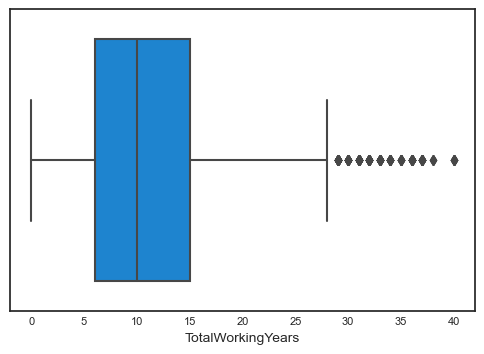

In [473]:
sns.boxplot(x='TotalWorkingYears',data=hr)

In [474]:
hr['TotalWorkingYears'] = hr['TotalWorkingYears'].fillna(2)
hr['TotalWorkingYears'].isnull().sum()

0

In [475]:
hr.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4410 entries, 0 to 4409
Data columns (total 26 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Age                      4410 non-null   int64  
 1   Attrition                4410 non-null   object 
 2   BusinessTravel           4410 non-null   object 
 3   Department               4410 non-null   object 
 4   DistanceFromHome         4410 non-null   int64  
 5   Education                4410 non-null   object 
 6   EducationField           4410 non-null   object 
 7   Gender                   4410 non-null   object 
 8   JobLevel                 4410 non-null   object 
 9   JobRole                  4410 non-null   object 
 10  MaritalStatus            4410 non-null   object 
 11  MonthlyIncome            4410 non-null   int64  
 12  NumCompaniesWorked       4410 non-null   float64
 13  PercentSalaryHike        4410 non-null   int64  
 14  StockOptionLevel        

## Step 2: Visualising the Data

- If there is some obvious multicollinearity going on, this is the first place to catch it
- Here's where we'll also identify if some predictors directly have a strong association with the outcome variable

We'll visualise our data using `matplotlib` and `seaborn`.

In [476]:
hr.to_csv("hr_for_data_viz.csv")

In [477]:
sv_report = sv.analyze(hr, target_feat="Attrition")
sv_report.show_html() # Default arguments will generate to "SWEETVIZ_REPORT.html"


Report SWEETVIZ_REPORT.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


In [478]:
AV = AutoViz_Class()

Shape of your Data Set loaded: (4410, 27)
############## C L A S S I F Y I N G  V A R I A B L E S  ####################
Classifying variables in data set...
Data Set Shape: 4410 rows, 26 cols
Data Set columns info:
* Unnamed: 0: 0 nulls, 4410 unique vals, most common: {2047: 1, 2632: 1}
* Age: 0 nulls, 43 unique vals, most common: {35: 234, 34: 231}
* BusinessTravel: 0 nulls, 3 unique vals, most common: {'Travel_Rarely': 3129, 'Travel_Frequently': 831}
* Department: 0 nulls, 3 unique vals, most common: {'Research & Development': 2883, 'Sales': 1338}
* DistanceFromHome: 0 nulls, 29 unique vals, most common: {2: 633, 1: 624}
* Education: 0 nulls, 5 unique vals, most common: {'Bachelor': 1716, 'Master': 1194}
* EducationField: 0 nulls, 6 unique vals, most common: {'Life Sciences': 1818, 'Medical': 1392}
* Gender: 0 nulls, 2 unique vals, most common: {'Male': 2646, 'Female': 1764}
* JobLevel: 0 nulls, 5 unique vals, most common: {'Level_1': 1629, 'Level_2': 1602}
* JobRole: 0 nulls, 9 uniq

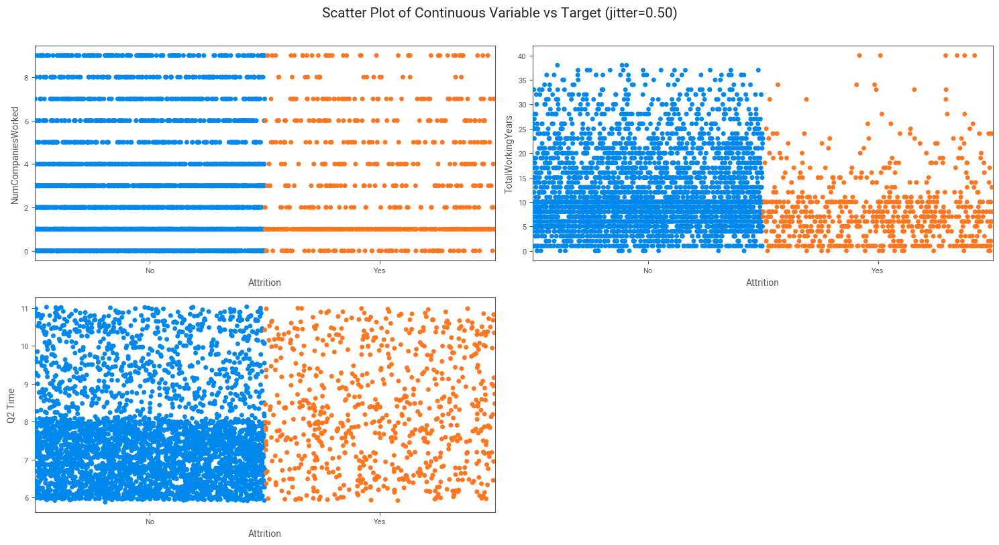

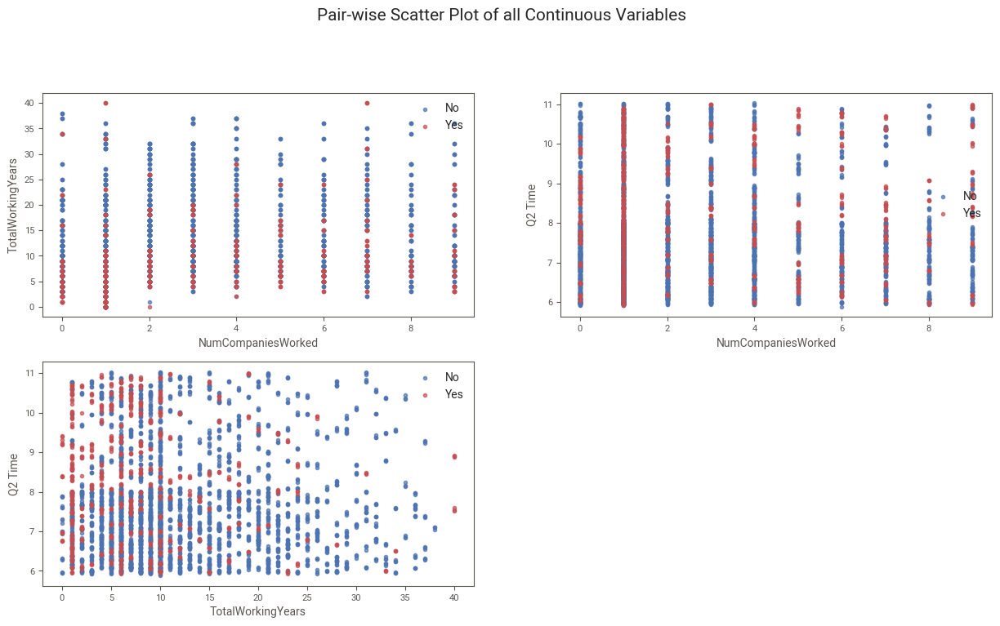

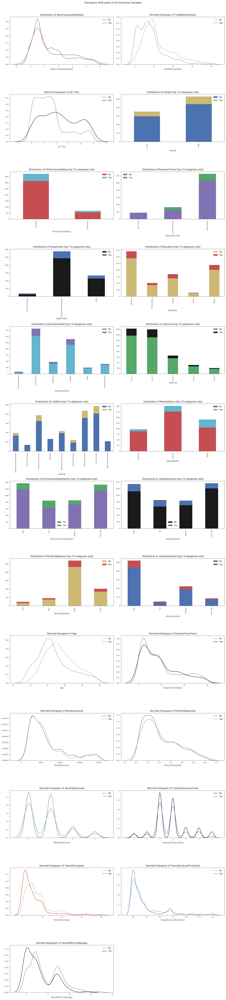

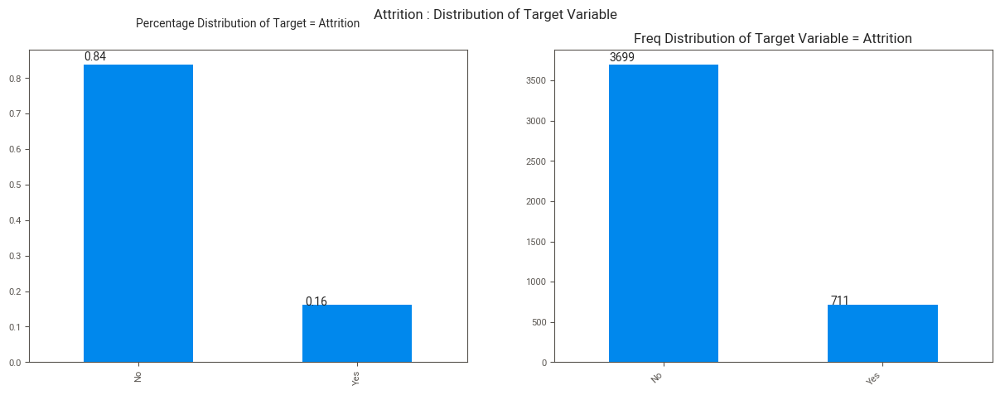

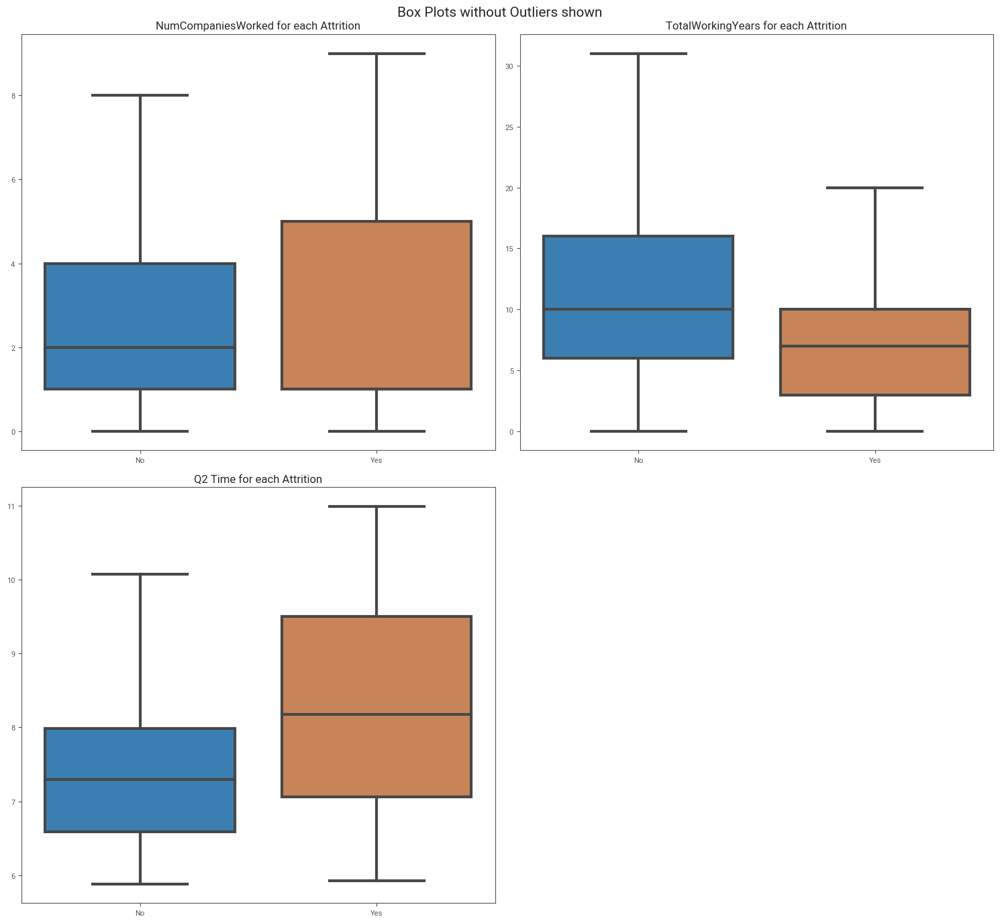

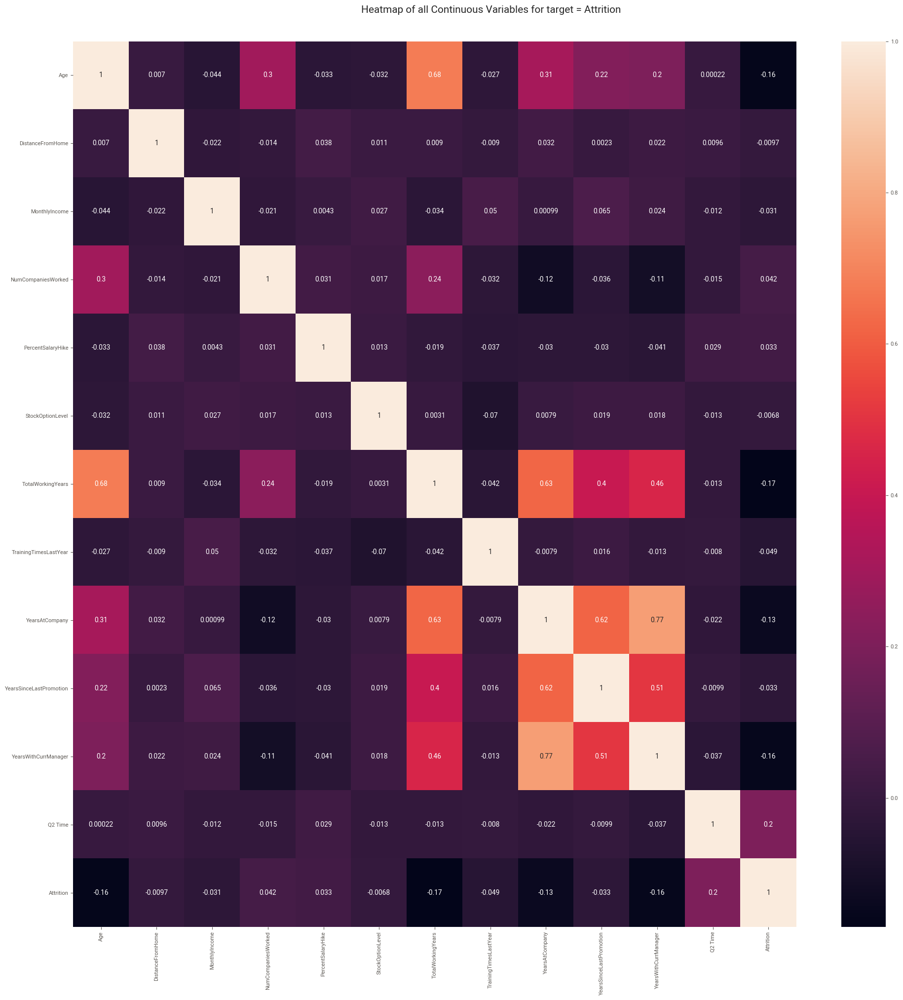

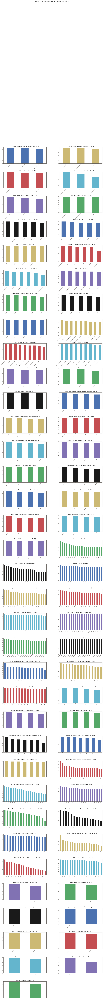

In [479]:
dft = AV.AutoViz("hr_for_data_viz.csv",depVar="Attrition",dfte=None,header=0,verbose=2,lowess=False,)

In [480]:
dtale.show(hr, ignore_duplicate=True)

## Insights

In [481]:
hr.shape

(4410, 26)

In [482]:
hr.head()

,Age,Attrition,BusinessTravel,Department,DistanceFromHome,Education,EducationField,Gender,JobLevel,JobRole,MaritalStatus,MonthlyIncome,NumCompaniesWorked,PercentSalaryHike,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,YearsAtCompany,YearsSinceLastPromotion,YearsWithCurrManager,EnvironmentSatisfaction,JobSatisfaction,WorkLifeBalance,JobInvolvement,PerformanceRating,Q2 Time
0,51,No,Travel_Rarely,Sales,6,College,Life Sciences,Female,Level_1,Healthcare Representative,Married,131160,1.0,11,0,1.0,6,1,0,0,High,Very High,Good,High,Excellent,7.365000
1,31,Yes,Travel_Frequently,Research & Development,10,Below College,Life Sciences,Female,Level_1,Research Scientist,Single,41890,0.0,23,1,6.0,3,5,1,4,High,Medium,Best,Medium,Outstanding,7.703611
2,32,No,Travel_Frequently,Research & Development,17,Master,Other,Male,Level_4,Sales Executive,Married,193280,1.0,15,3,5.0,2,5,0,3,Medium,Medium,Bad,High,Excellent,6.977500
3,38,No,Non-Travel,Research & Development,2,Doctor,Life Sciences,Male,Level_3,Human Resources,Married,83210,3.0,11,3,13.0,5,8,7,5,Very High,Very High,Better,Medium,Excellent,7.157222
4,32,No,Travel_Rarely,Research & Development,10,Below College,Medical,Male,Level_1,Sales Executive,Single,23420,4.0,12,2,9.0,2,6,0,4,Very High,Low,Better,High,Excellent,7.953611


In [483]:
target ='Attrition'

obj_cols = [col for col in hr.columns if is_object_dtype(hr[col].dtype)]
print(obj_cols)
num_cols = hr.select_dtypes(include=np.number).columns.tolist()
print(num_cols)

['Attrition', 'BusinessTravel', 'Department', 'Education', 'EducationField', 'Gender', 'JobLevel', 'JobRole', 'MaritalStatus', 'EnvironmentSatisfaction', 'JobSatisfaction', 'WorkLifeBalance', 'JobInvolvement', 'PerformanceRating']
['Age', 'DistanceFromHome', 'MonthlyIncome', 'NumCompaniesWorked', 'PercentSalaryHike', 'StockOptionLevel', 'TotalWorkingYears', 'TrainingTimesLastYear', 'YearsAtCompany', 'YearsSinceLastPromotion', 'YearsWithCurrManager', 'Q2 Time']


### Univariate Categorical Analysis

In [484]:
def barPerc(df,xVar,ax):
    '''
    barPerc(): Add percentage for hues to bar plots
    args:
        df: pandas dataframe
        xVar: (string) X variable 
        ax: Axes object (for Seaborn Countplot/Bar plot or
                         pandas bar plot)
    '''
    # 1. how many X categories
    ##   check for NaN and remove
    numX=len([x for x in df[xVar].unique() if x==x])

    # 2. The bars are created in hue order, organize them
    bars = ax.patches
    ## 2a. For each X variable
    for ind in range(numX):
        ## 2b. Get every hue bar
        ##     ex. 8 X categories, 4 hues =>
        ##    [0, 8, 16, 24] are hue bars for 1st X category
        hueBars=bars[ind:][::numX]
        ## 2c. Get the total height (for percentages)
        total = sum([x.get_height() for x in hueBars])

        # 3. Print the percentage on the bars
        for bar in hueBars:
            ax.text(bar.get_x() + bar.get_width()/2.,
                    bar.get_height(),
                    f'{bar.get_height()/total:.0%}',
                    ha="center",va="bottom")

In [485]:
def attrition_rate(col,target):
    chk = hr.loc[:,[col,target]]
    chk[target] = chk[target].replace({'Yes': 1, "No": 0})
    attr_rate = round(chk.groupby(col)[target].mean()*100,2)
    attr_rate.sort_index()
    return attr_rate


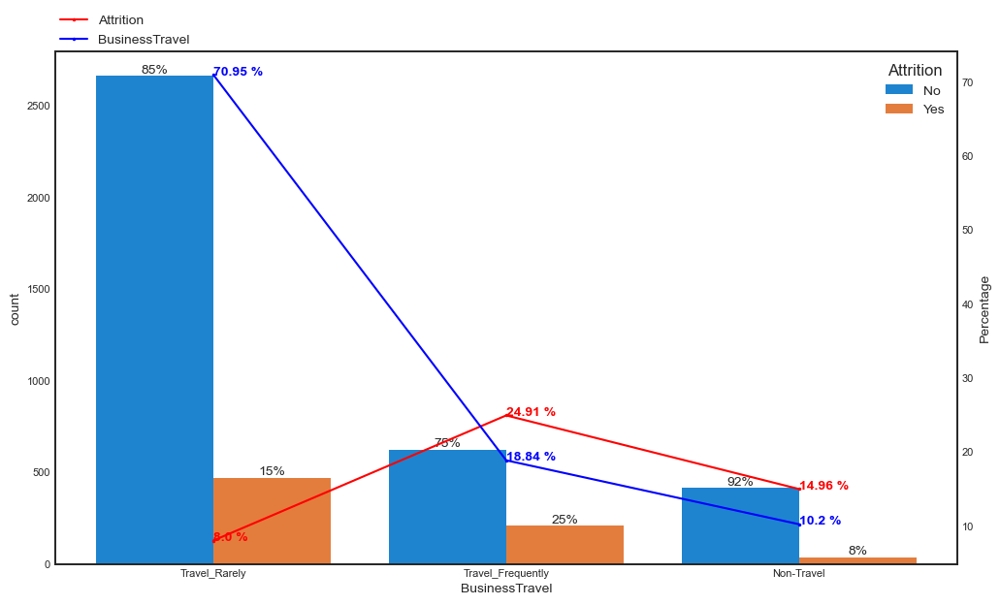

In [486]:
column = obj_cols[1]
plt.style.use('seaborn-white')
plt.figure(figsize=[12,7])
ax1=sns.countplot(column,hue=target,data=hr,  order = hr[column].value_counts().index)
barPerc(hr,column,ax1)
ax2 = ax1.twinx()
attr_rate = attrition_rate(column,target)
attr_rate.plot.line(style='.-', color='red', ax=ax2)
for index,data in enumerate(attr_rate.values):
    plt.text(x=index , y =data ,  color='red', fontweight='bold', s=f"{data} %" )

prop = round(hr[column].value_counts(normalize=True)*100,2)
prop.sort_index()
prop.plot.line(style='.-', color='blue', ax=ax2)
for index,data in enumerate(prop.values):
    plt.text(x=index , y =data ,  color='blue', fontweight='bold', s=f"{data} %" )
#ax1.legend(loc=[1,1])
ax2.legend(loc=[0,1])
ax2.set_ylabel("Percentage")
ax2.grid(False)


- Most of the employees just `Travel Rarely` (almost 70.95%) and this category has the lowest attrition rate amont all the business travel levels
- As expected employee who `Travel Frequently` have the highest attrition rate

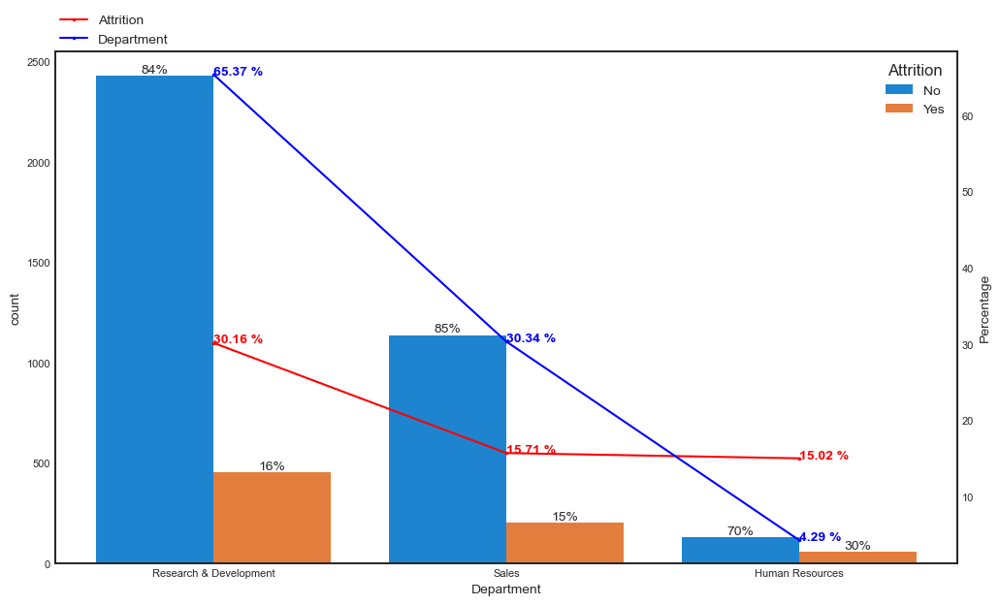

In [487]:
column = obj_cols[2]
plt.style.use('seaborn-white')
plt.figure(figsize=[12,7])
ax1=sns.countplot(column,hue=target,data=hr,  order = hr[column].value_counts().index)
barPerc(hr,column,ax1)
ax2 = ax1.twinx()
attr_rate = attrition_rate(column,target)
attr_rate.plot.line(style='.-', color='red', ax=ax2)
for index,data in enumerate(attr_rate.values):
    plt.text(x=index , y =data ,  color='red', fontweight='bold', s=f"{data} %" )

prop = round(hr[column].value_counts(normalize=True)*100,2)
prop.sort_index()
prop.plot.line(style='.-', color='blue', ax=ax2)
for index,data in enumerate(prop.values):
    plt.text(x=index , y =data ,  color='blue', fontweight='bold', s=f"{data} %" )
#ax1.legend(loc=[1,1])
ax2.legend(loc=[0,1])
ax2.set_ylabel("Percentage")
ax2.grid(False)

- From the above graph, we can see that the Deparment `Research & Development` has the highest share of employees and also a higher attrition rate compared to other departments
- `HR` department share is just 4.29% 

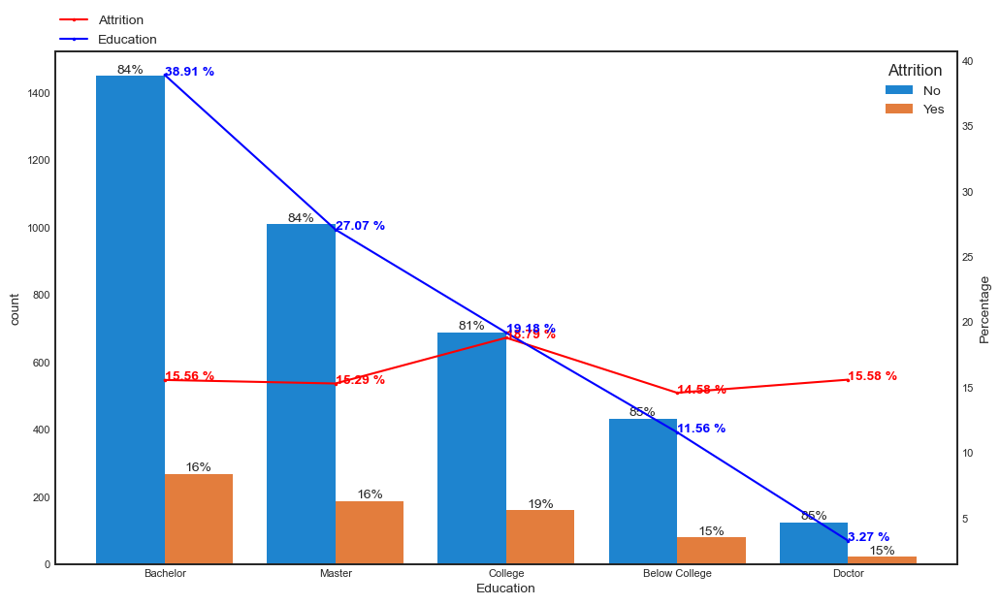

In [488]:
column = obj_cols[3]
plt.style.use('seaborn-white')
plt.figure(figsize=[12,7])
ax1=sns.countplot(column,hue=target,data=hr,  order = hr[column].value_counts().index)
barPerc(hr,column,ax1)
ax2 = ax1.twinx()
attr_rate = attrition_rate(column,target)
attr_rate.plot.line(style='.-', color='red', ax=ax2)
for index,data in enumerate(attr_rate.values):
    plt.text(x=index , y =data ,  color='red', fontweight='bold', s=f"{data} %" )

prop = round(hr[column].value_counts(normalize=True)*100,2)
prop.sort_index()
prop.plot.line(style='.-', color='blue', ax=ax2)
for index,data in enumerate(prop.values):
    plt.text(x=index , y =data ,  color='blue', fontweight='bold', s=f"{data} %" )
#ax1.legend(loc=[1,1])
ax2.legend(loc=[0,1])
ax2.set_ylabel("Percentage")
ax2.grid(False)

- Clearly `Education` doesnt have any effect on the attrition rate and is almost constant across different levels of Education
- Employees with doctorates are just 3.27% of the whole organization and the major category in Education is Bachelor with almost 38.91%

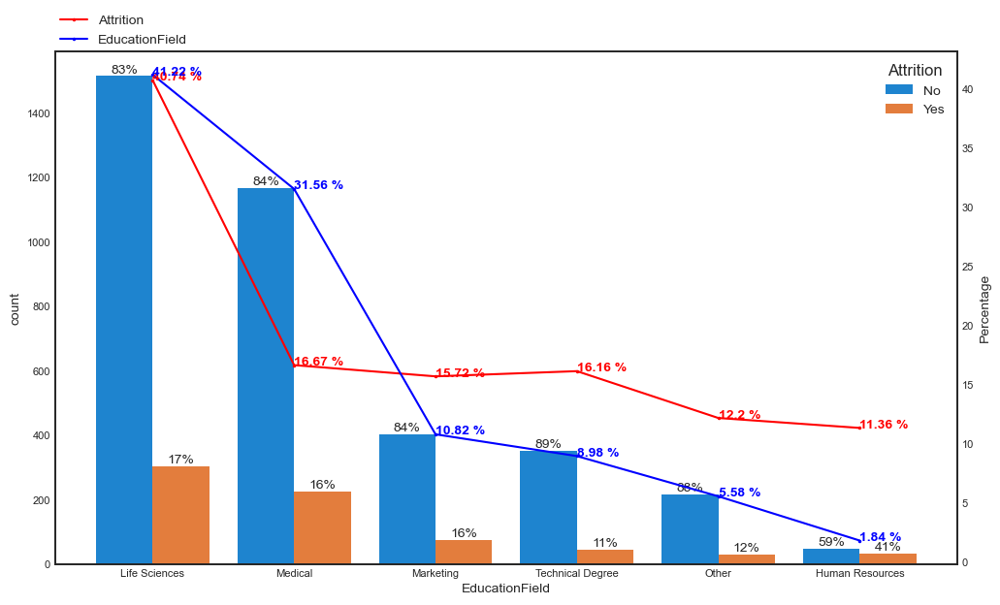

In [489]:
column = obj_cols[4]
plt.style.use('seaborn-white')
plt.figure(figsize=[12,7])
ax1=sns.countplot(column,hue=target,data=hr,  order = hr[column].value_counts().index)
barPerc(hr,column,ax1)
ax2 = ax1.twinx()
attr_rate = attrition_rate(column,target)
attr_rate.plot.line(style='.-', color='red', ax=ax2)
for index,data in enumerate(attr_rate.values):
    plt.text(x=index , y =data ,  color='red', fontweight='bold', s=f"{data} %" )

prop = round(hr[column].value_counts(normalize=True)*100,2)
prop.sort_index()
prop.plot.line(style='.-', color='blue', ax=ax2)
for index,data in enumerate(prop.values):
    plt.text(x=index , y =data ,  color='blue', fontweight='bold', s=f"{data} %" )
#ax1.legend(loc=[1,1])
ax2.legend(loc=[0,1])
ax2.set_ylabel("Percentage")
ax2.grid(False)

- There is a high attrition rate of 40.74% in Employees who come from `EducationField` of Life Sciences
- Attrition rate is almost constant among the remaining Education Fields

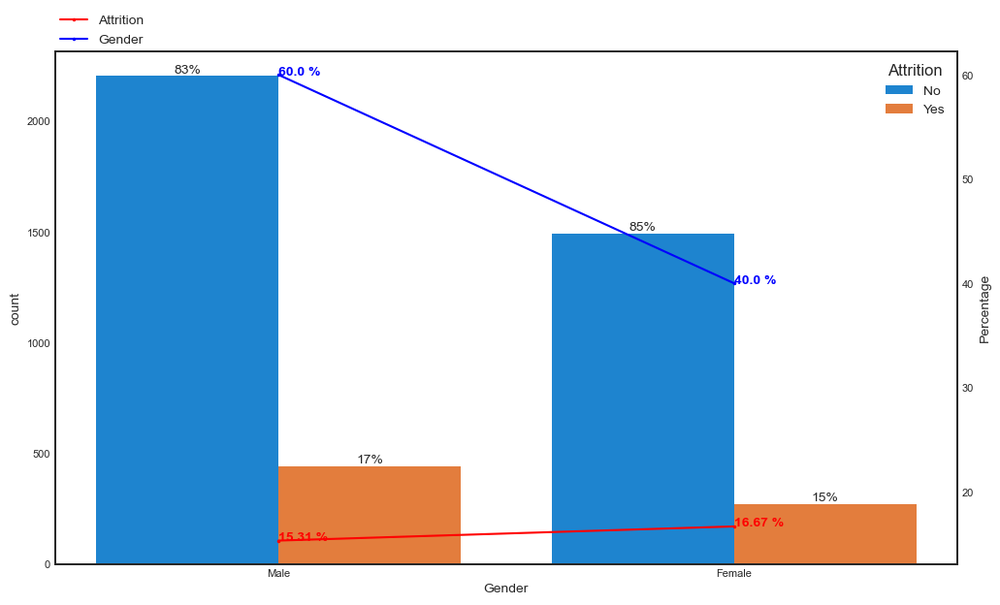

In [490]:
column = obj_cols[5]
plt.style.use('seaborn-white')
plt.figure(figsize=[12,7])
ax1=sns.countplot(column,hue=target,data=hr,  order = hr[column].value_counts().index)
barPerc(hr,column,ax1)
ax2 = ax1.twinx()
attr_rate = attrition_rate(column,target)
attr_rate.plot.line(style='.-', color='red', ax=ax2)
for index,data in enumerate(attr_rate.values):
    plt.text(x=index , y =data ,  color='red', fontweight='bold', s=f"{data} %" )

prop = round(hr[column].value_counts(normalize=True)*100,2)
prop.sort_index()
prop.plot.line(style='.-', color='blue', ax=ax2)
for index,data in enumerate(prop.values):
    plt.text(x=index , y =data ,  color='blue', fontweight='bold', s=f"{data} %" )
#ax1.legend(loc=[1,1])
ax2.legend(loc=[0,1])
ax2.set_ylabel("Percentage")
ax2.grid(False)

- The organization has a male-female ratio of 60: 40 and the attrition rate is almost same among both genders. 

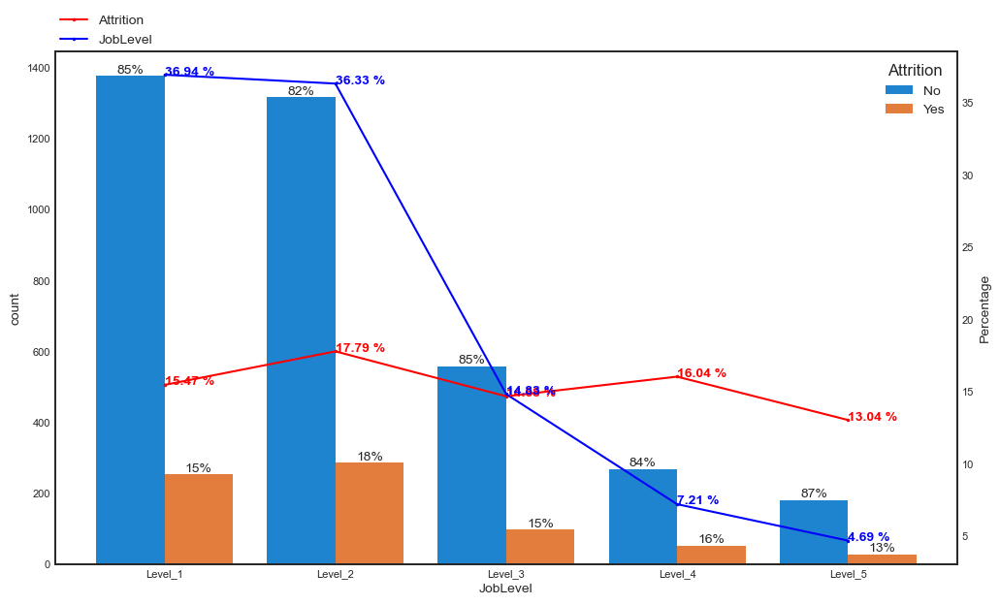

In [491]:
column = obj_cols[6]
plt.style.use('seaborn-white')
plt.figure(figsize=[12,7])
ax1=sns.countplot(column,hue=target,data=hr,  order = hr[column].value_counts().index)
barPerc(hr,column,ax1)
ax2 = ax1.twinx()
attr_rate = attrition_rate(column,target)
attr_rate.plot.line(style='.-', color='red', ax=ax2)
for index,data in enumerate(attr_rate.values):
    plt.text(x=index , y =data ,  color='red', fontweight='bold', s=f"{data} %" )

prop = round(hr[column].value_counts(normalize=True)*100,2)
prop.sort_index()
prop.plot.line(style='.-', color='blue', ax=ax2)
for index,data in enumerate(prop.values):
    plt.text(x=index , y =data ,  color='blue', fontweight='bold', s=f"{data} %" )
#ax1.legend(loc=[1,1])
ax2.legend(loc=[0,1])
ax2.set_ylabel("Percentage")
ax2.grid(False)

- Attrition rate is almost constant across all joblevels

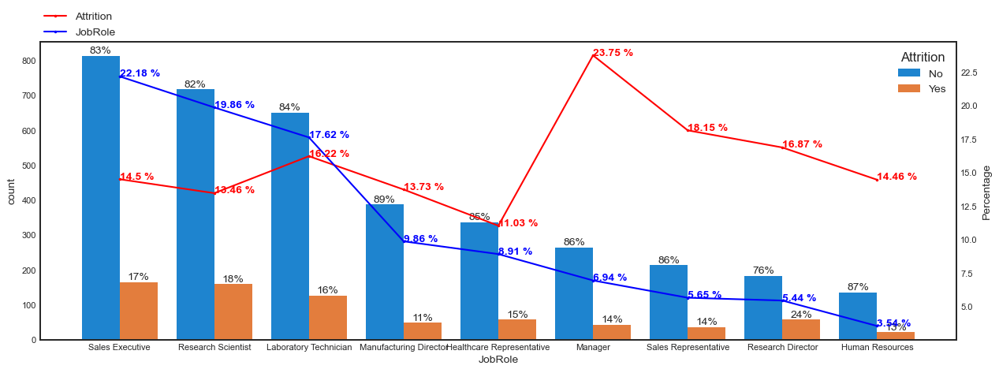

In [492]:
column = obj_cols[7]
plt.style.use('seaborn-white')
plt.figure(figsize=[15,5])
ax1=sns.countplot(column,hue=target,data=hr,  order = hr[column].value_counts().index)
barPerc(hr,column,ax1)
ax2 = ax1.twinx()
attr_rate = attrition_rate(column,target)
attr_rate.plot.line(style='.-', color='red', ax=ax2)
for index,data in enumerate(attr_rate.values):
    plt.text(x=index , y =data ,  color='red', fontweight='bold', s=f"{data} %" )

prop = round(hr[column].value_counts(normalize=True)*100,2)
prop.sort_index()
prop.plot.line(style='.-', color='blue', ax=ax2)
for index,data in enumerate(prop.values):
    plt.text(x=index , y =data ,  color='blue', fontweight='bold', s=f"{data} %" )
#ax1.legend(loc=[1,1])
ax2.legend(loc=[0,1])
ax2.set_ylabel("Percentage")
ax2.grid(False)

- SalesExecutives have the highest share in employees (22.18%) and has a attrition rate close to 15%
- Though Managers account to only 6.94% of the total population, they have a marginally higher attrition rate of 23.75%

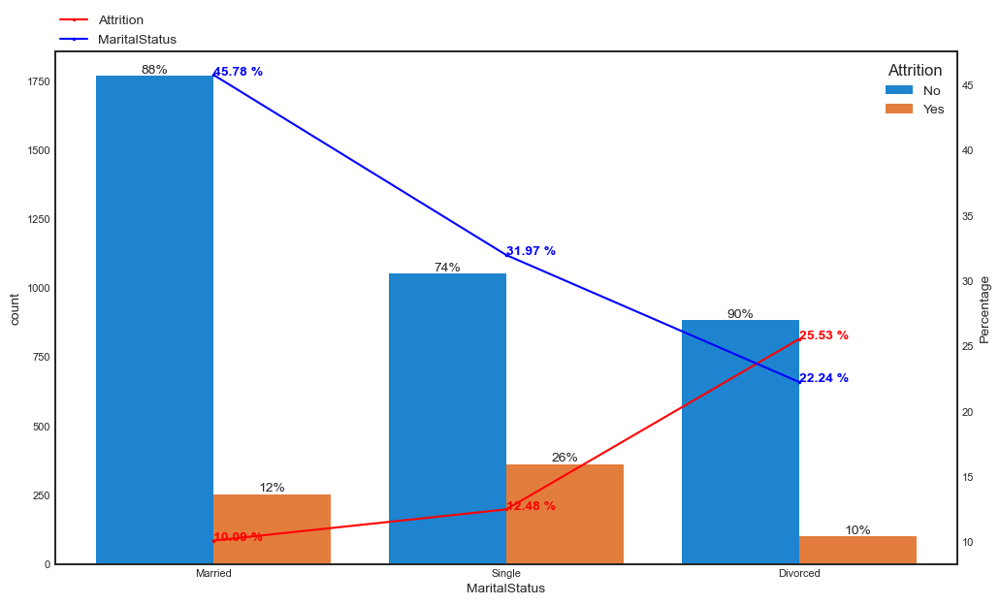

In [493]:
column = obj_cols[8]
plt.style.use('seaborn-white')
plt.figure(figsize=[12,7])
ax1=sns.countplot(column,hue=target,data=hr,  order = hr[column].value_counts().index)
barPerc(hr,column,ax1)
ax2 = ax1.twinx()
attr_rate = attrition_rate(column,target)
attr_rate.plot.line(style='.-', color='red', ax=ax2)
for index,data in enumerate(attr_rate.values):
    plt.text(x=index , y =data ,  color='red', fontweight='bold', s=f"{data} %" )

prop = round(hr[column].value_counts(normalize=True)*100,2)
prop.sort_index()
prop.plot.line(style='.-', color='blue', ax=ax2)
for index,data in enumerate(prop.values):
    plt.text(x=index , y =data ,  color='blue', fontweight='bold', s=f"{data} %" )
#ax1.legend(loc=[1,1])
ax2.legend(loc=[0,1])
ax2.set_ylabel("Percentage")
ax2.grid(False)

- Attrition rate is lowest among `Married` employees and it is highest among `Divorced` employees

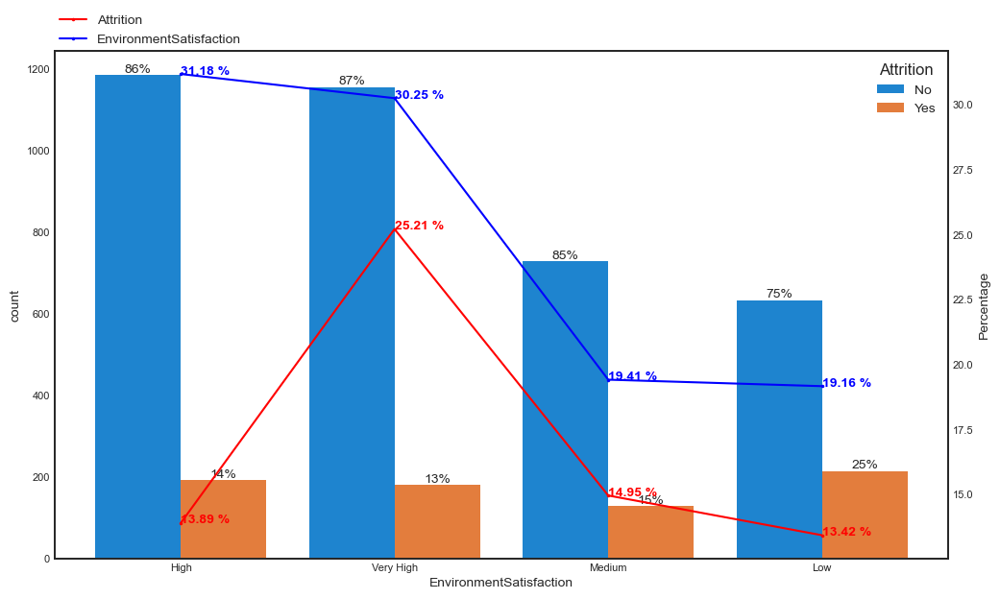

In [494]:
column = obj_cols[9]
plt.style.use('seaborn-white')
plt.figure(figsize=[12,7])
ax1=sns.countplot(column,hue=target,data=hr,  order = hr[column].value_counts().index)
barPerc(hr,column,ax1)
ax2 = ax1.twinx()
attr_rate = attrition_rate(column,target)
attr_rate.plot.line(style='.-', color='red', ax=ax2)
for index,data in enumerate(attr_rate.values):
    plt.text(x=index , y =data ,  color='red', fontweight='bold', s=f"{data} %" )

prop = round(hr[column].value_counts(normalize=True)*100,2)
prop.sort_index()
prop.plot.line(style='.-', color='blue', ax=ax2)
for index,data in enumerate(prop.values):
    plt.text(x=index , y =data ,  color='blue', fontweight='bold', s=f"{data} %" )
#ax1.legend(loc=[1,1])
ax2.legend(loc=[0,1])
ax2.set_ylabel("Percentage")
ax2.grid(False)

- Surprisingly even though employees who rate the `EnvironmentSatisfcation` are almost same in terms of total proportion (31% and 30.25% respectively), there is a start difference of almost 20% in attrition rate. Employees who rated `EnvironmentSatisfication` as Very High has a high attrition rate of 30.25%
- There is a constant lower attritionrate with levels Medium and Low

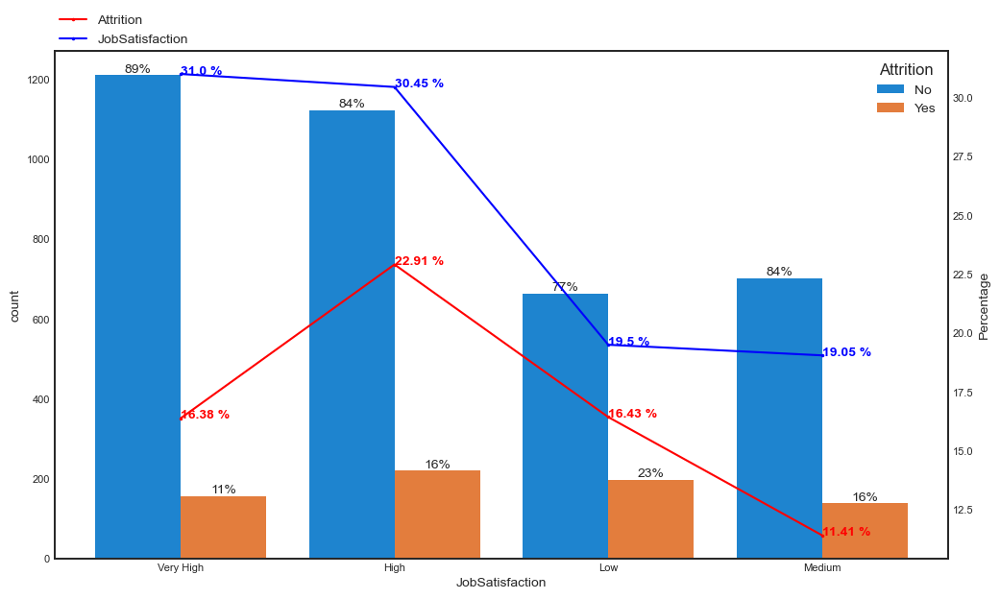

In [495]:
column = obj_cols[10]
plt.style.use('seaborn-white')
plt.figure(figsize=[12,7])
ax1=sns.countplot(column,hue=target,data=hr,  order = hr[column].value_counts().index)
barPerc(hr,column,ax1)
ax2 = ax1.twinx()
attr_rate = attrition_rate(column,target)
attr_rate.plot.line(style='.-', color='red', ax=ax2)
for index,data in enumerate(attr_rate.values):
    plt.text(x=index , y =data ,  color='red', fontweight='bold', s=f"{data} %" )

prop = round(hr[column].value_counts(normalize=True)*100,2)
prop.sort_index()
prop.plot.line(style='.-', color='blue', ax=ax2)
for index,data in enumerate(prop.values):
    plt.text(x=index , y =data ,  color='blue', fontweight='bold', s=f"{data} %" )
#ax1.legend(loc=[1,1])
ax2.legend(loc=[0,1])
ax2.set_ylabel("Percentage")
ax2.grid(False)

-  Employees with a High `Jobsatisfaction` have a marginally higher attrition rate compared to other satisfaction levels. 

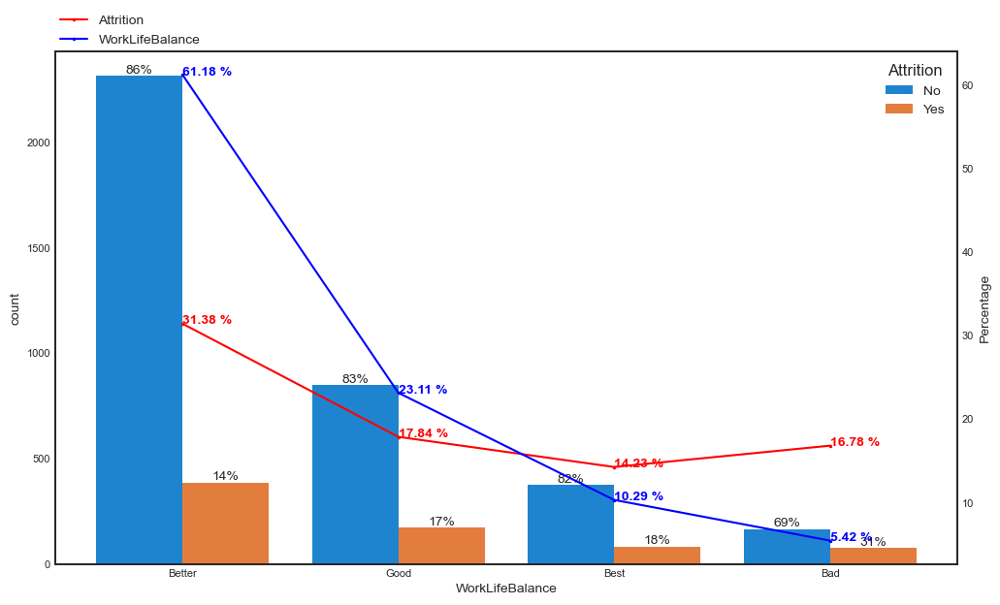

In [496]:
column = obj_cols[11]
plt.style.use('seaborn-white')
plt.figure(figsize=[12,7])
ax1=sns.countplot(column,hue=target,data=hr,  order = hr[column].value_counts().index)
barPerc(hr,column,ax1)
ax2 = ax1.twinx()
attr_rate = attrition_rate(column,target)
attr_rate.plot.line(style='.-', color='red', ax=ax2)
for index,data in enumerate(attr_rate.values):
    plt.text(x=index , y =data ,  color='red', fontweight='bold', s=f"{data} %" )

prop = round(hr[column].value_counts(normalize=True)*100,2)
prop.sort_index()
prop.plot.line(style='.-', color='blue', ax=ax2)
for index,data in enumerate(prop.values):
    plt.text(x=index , y =data ,  color='blue', fontweight='bold', s=f"{data} %" )
#ax1.legend(loc=[1,1])
ax2.legend(loc=[0,1])
ax2.set_ylabel("Percentage")
ax2.grid(False)

- People who say have that they have a Bad `WorkLifeBalance` still do not tend to leave the company
- Attrition rates are lowest among employees who have Best `WorkLifeBalance`
- Majority of the employees say that have Better `WorklifeBalance` (almost 61.18%), however the attrition rate is also the highest in this category.

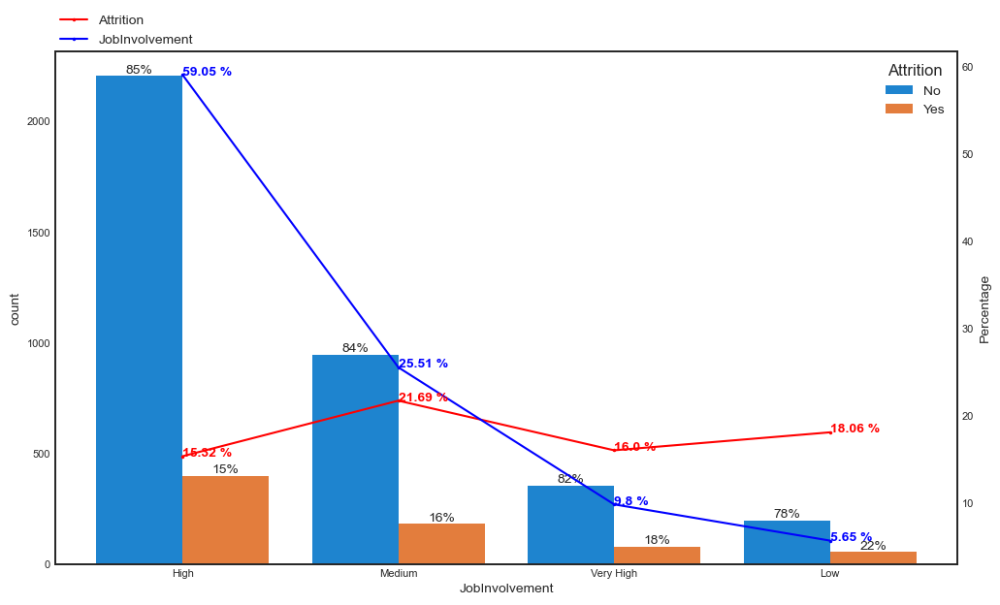

In [497]:
column = obj_cols[12]
plt.style.use('seaborn-white')
plt.figure(figsize=[12,7])
ax1=sns.countplot(column,hue=target,data=hr,  order = hr[column].value_counts().index)
barPerc(hr,column,ax1)
ax2 = ax1.twinx()
attr_rate = attrition_rate(column,target)
attr_rate.plot.line(style='.-', color='red', ax=ax2)
for index,data in enumerate(attr_rate.values):
    plt.text(x=index , y =data ,  color='red', fontweight='bold', s=f"{data} %" )

prop = round(hr[column].value_counts(normalize=True)*100,2)
prop.sort_index()
prop.plot.line(style='.-', color='blue', ax=ax2)
for index,data in enumerate(prop.values):
    plt.text(x=index , y =data ,  color='blue', fontweight='bold', s=f"{data} %" )
#ax1.legend(loc=[1,1])
ax2.legend(loc=[0,1])
ax2.set_ylabel("Percentage")
ax2.grid(False)

`- From the above graph we can see that employees with `JobInvolvment` High are more in the company and the attrition rate is more or less uniform across all the levels of `JobInvolvement`

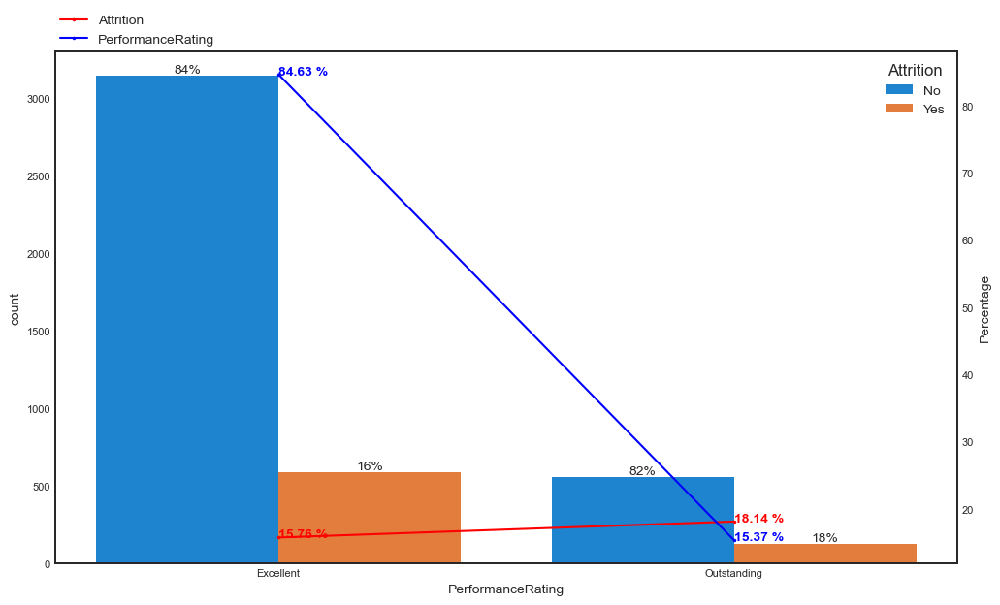

In [498]:
column = obj_cols[13]
plt.style.use('seaborn-white')
plt.figure(figsize=[12,7])
ax1=sns.countplot(column,hue=target,data=hr,  order = hr[column].value_counts().index)
barPerc(hr,column,ax1)
ax2 = ax1.twinx()
attr_rate = attrition_rate(column,target)
attr_rate.plot.line(style='.-', color='red', ax=ax2)
for index,data in enumerate(attr_rate.values):
    plt.text(x=index , y =data ,  color='red', fontweight='bold', s=f"{data} %" )

prop = round(hr[column].value_counts(normalize=True)*100,2)
prop.sort_index()
prop.plot.line(style='.-', color='blue', ax=ax2)
for index,data in enumerate(prop.values):
    plt.text(x=index , y =data ,  color='blue', fontweight='bold', s=f"{data} %" )
#ax1.legend(loc=[1,1])
ax2.legend(loc=[0,1])
ax2.set_ylabel("Percentage")
ax2.grid(False)

- Even for the variable `PerformanceRating` the attrition rate is steady across these the two levels `Excellent` and `Outstanding`

## Univariate Numerical Column Analysis

<AxesSubplot:xlabel='Attrition', ylabel='Age'>

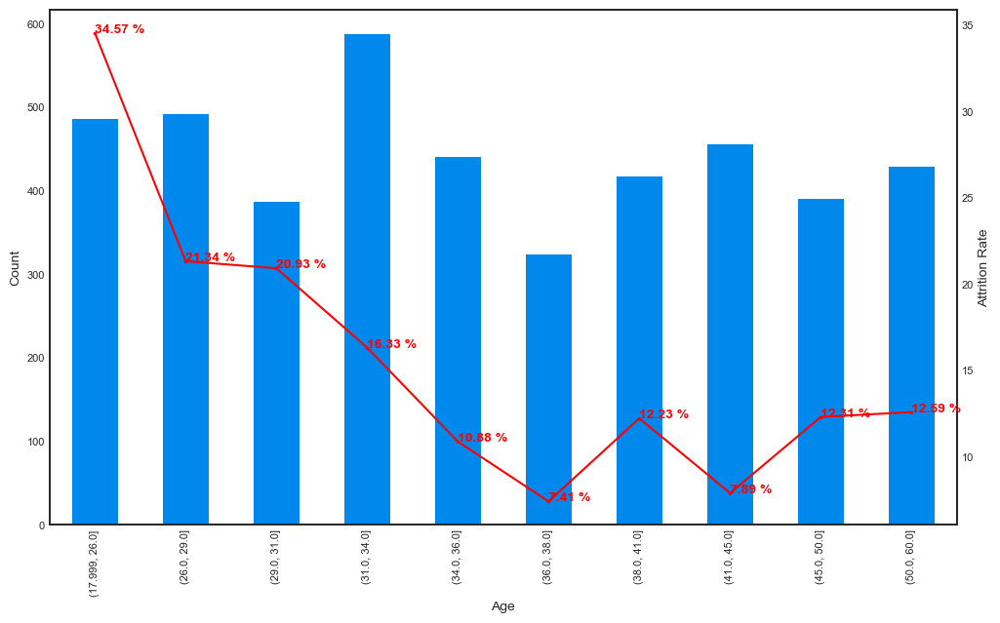

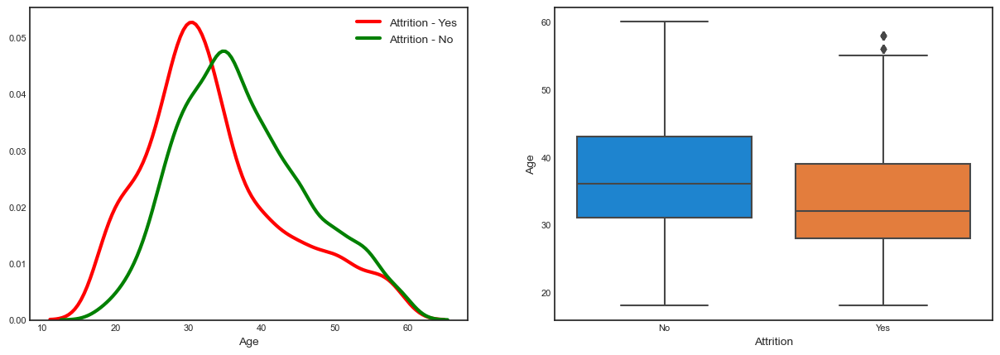

In [499]:
attrition_yes = hr.loc[hr["Attrition"]=="Yes"]
attrition_no  = hr.loc[hr["Attrition"]=="No"]

num_col = num_cols[0]

plt.figure(figsize=[12,7])
bins = pd.qcut(hr[num_col], 10,duplicates='drop') 

df = pd.crosstab(bins, hr[target],).reset_index()
df['Attrition_rate'] = round(df['Yes']*100/(df['Yes']+df['No']),2)
df.head()
df= df.set_index(num_col)
df['Count'] = df['Yes']+df['No']
ax1 = df['Count'].plot(kind='bar')
ax2 = ax1.twinx()
df['Attrition_rate'].plot(kind='line', style='.-',color='red', ax=ax2)
for index,data in enumerate(df['Attrition_rate'].values):
    plt.text(x=index , y =data ,  color='red', fontweight='bold', s=f"{data} %" )

ax1.set_ylabel("Count")
ax2.set_ylabel("Attrition Rate")

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 5))
sns.distplot(attrition_yes[num_col], ax=axes[0], hist=False, kde_kws={"color": "red", "lw": 3, "label": "Attrition - Yes"},)
sns.distplot(attrition_no[num_col], ax=axes[0], hist =False, kde_kws={"color": "green", "lw": 3, "label": "Attrition - No"},)
sns.boxplot(x="Attrition", y= num_col,data=hr,ax=axes[1])




- Attrition rate decreases with increase in age till 35 and then afterwards follow a zig zag trend

<AxesSubplot:xlabel='Attrition', ylabel='DistanceFromHome'>

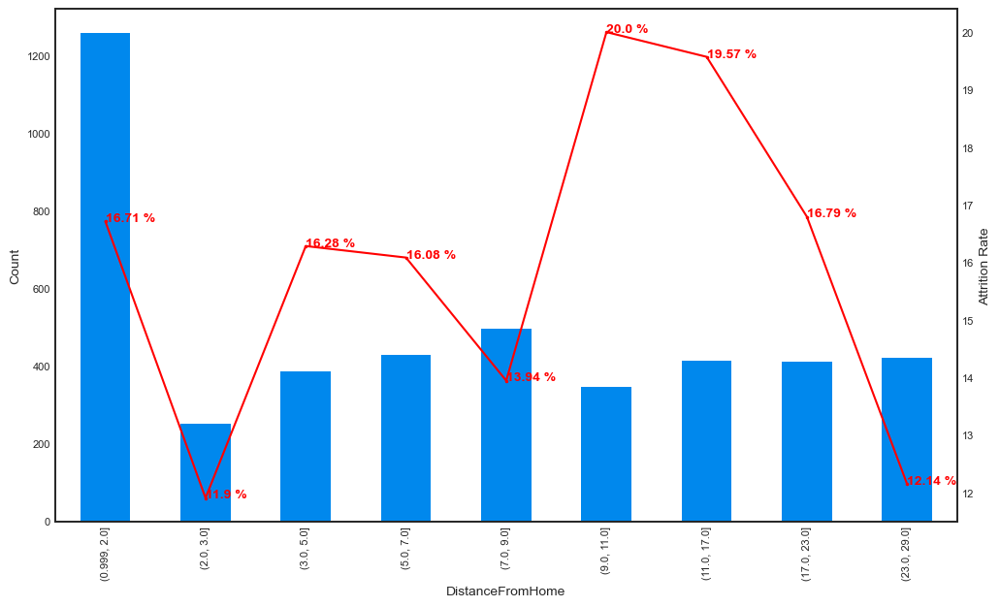

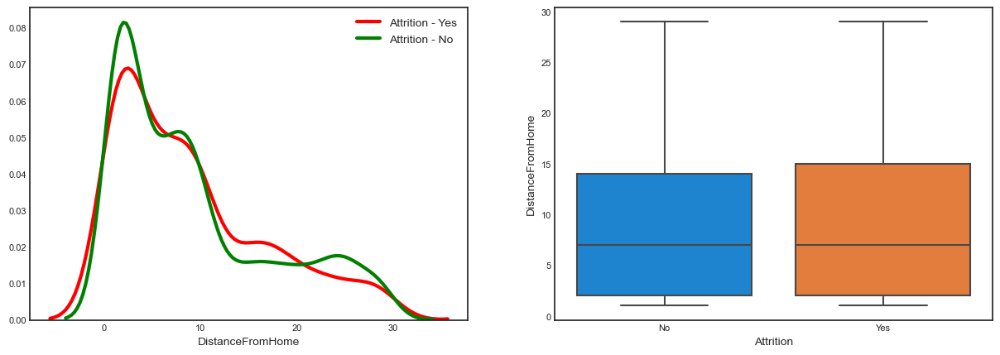

In [500]:
num_col = num_cols[1]

plt.figure(figsize=[12,7])
bins = pd.qcut(hr[num_col], 10,duplicates='drop') 

df = pd.crosstab(bins, hr[target],).reset_index()
df['Attrition_rate'] = round(df['Yes']*100/(df['Yes']+df['No']),2)
df.head()
df= df.set_index(num_col)
df['Count'] = df['Yes']+df['No']
ax1 = df['Count'].plot(kind='bar')
ax2 = ax1.twinx()
df['Attrition_rate'].plot(kind='line', style='.-',color='red', ax=ax2)
for index,data in enumerate(df['Attrition_rate'].values):
    plt.text(x=index , y =data ,  color='red', fontweight='bold', s=f"{data} %" )

ax1.set_ylabel("Count")
ax2.set_ylabel("Attrition Rate")

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 5))
sns.distplot(attrition_yes[num_col], ax=axes[0], hist=False, kde_kws={"color": "red", "lw": 3, "label": "Attrition - Yes"},)
sns.distplot(attrition_no[num_col], ax=axes[0], hist =False, kde_kws={"color": "green", "lw": 3, "label": "Attrition - No"},)
sns.boxplot(x="Attrition", y= num_col,data=hr,ax=axes[1])



- There is no clear trend between Attrition rate and DistanceFromHome. However, the rate is high among who are almost 10km away from home.

<AxesSubplot:xlabel='Attrition', ylabel='MonthlyIncome'>

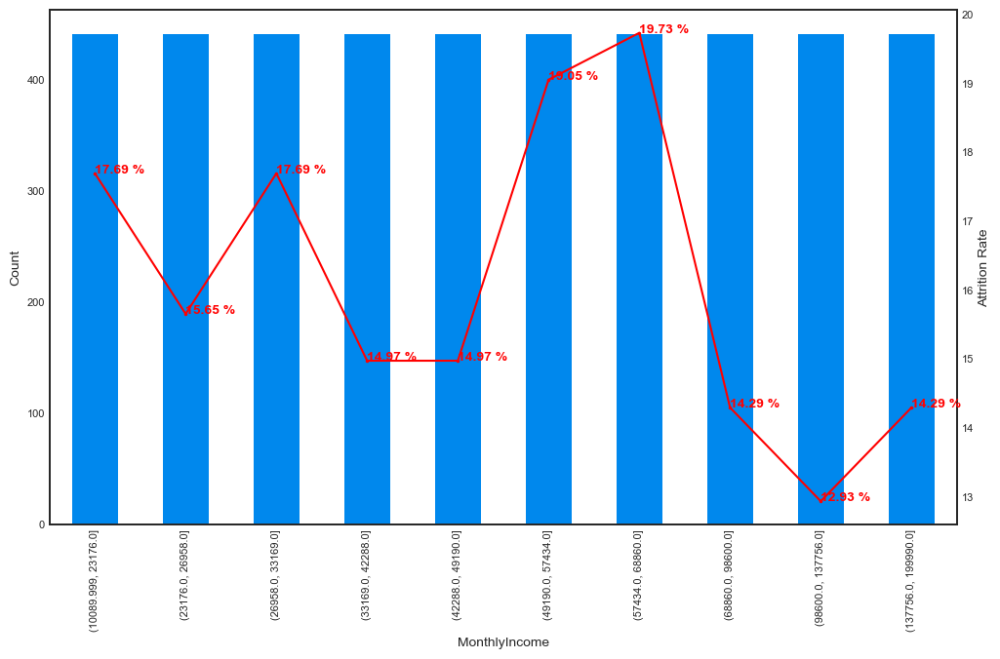

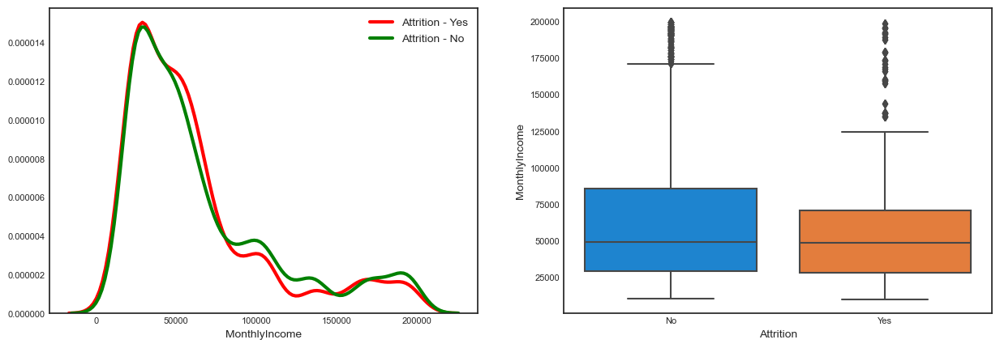

In [501]:
num_col = num_cols[2]

plt.figure(figsize=[12,7])
bins = pd.qcut(hr[num_col], 10,duplicates='drop') 

df = pd.crosstab(bins, hr[target],).reset_index()
df['Attrition_rate'] = round(df['Yes']*100/(df['Yes']+df['No']),2)
df.head()
df= df.set_index(num_col)
df['Count'] = df['Yes']+df['No']
ax1 = df['Count'].plot(kind='bar')
ax2 = ax1.twinx()
df['Attrition_rate'].plot(kind='line', style='.-',color='red', ax=ax2)
for index,data in enumerate(df['Attrition_rate'].values):
    plt.text(x=index , y =data ,  color='red', fontweight='bold', s=f"{data} %" )

ax1.set_ylabel("Count")
ax2.set_ylabel("Attrition Rate")

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 5))
sns.distplot(attrition_yes[num_col], ax=axes[0], hist=False, kde_kws={"color": "red", "lw": 3, "label": "Attrition - Yes"},)
sns.distplot(attrition_no[num_col], ax=axes[0], hist =False, kde_kws={"color": "green", "lw": 3, "label": "Attrition - No"},)
sns.boxplot(x="Attrition", y= num_col,data=hr,ax=axes[1])



- Attrition rate is high among employees who earn between 49k to 68k

<AxesSubplot:xlabel='Attrition', ylabel='NumCompaniesWorked'>

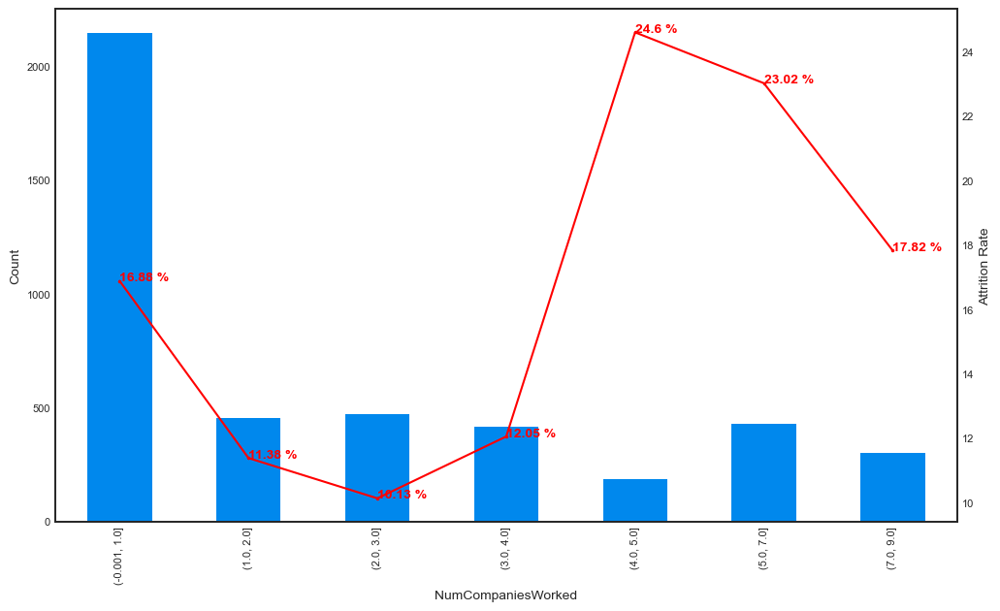

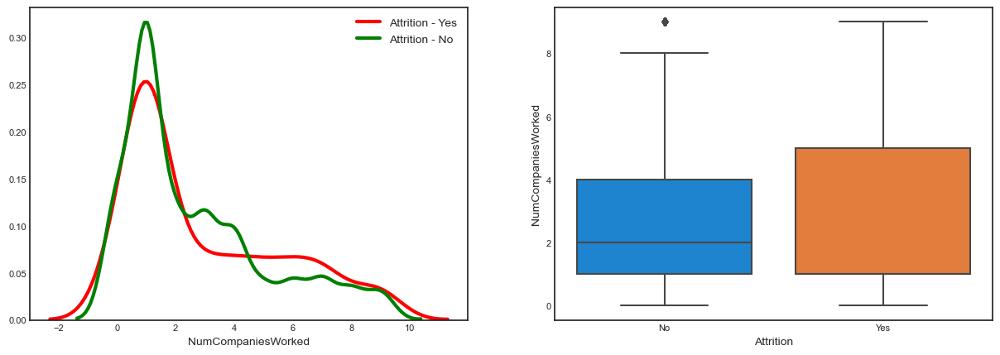

In [502]:
num_col = num_cols[3]

plt.figure(figsize=[12,7])
bins = pd.qcut(hr[num_col], 10,duplicates='drop') 

df = pd.crosstab(bins, hr[target],).reset_index()
df['Attrition_rate'] = round(df['Yes']*100/(df['Yes']+df['No']),2)
df.head()
df= df.set_index(num_col)
df['Count'] = df['Yes']+df['No']
ax1 = df['Count'].plot(kind='bar')
ax2 = ax1.twinx()
df['Attrition_rate'].plot(kind='line', style='.-',color='red', ax=ax2)
for index,data in enumerate(df['Attrition_rate'].values):
    plt.text(x=index , y =data ,  color='red', fontweight='bold', s=f"{data} %" )

ax1.set_ylabel("Count")
ax2.set_ylabel("Attrition Rate")

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 5))
sns.distplot(attrition_yes[num_col], ax=axes[0], hist=False, kde_kws={"color": "red", "lw": 3, "label": "Attrition - Yes"},)
sns.distplot(attrition_no[num_col], ax=axes[0], hist =False, kde_kws={"color": "green", "lw": 3, "label": "Attrition - No"},)
sns.boxplot(x="Attrition", y= num_col,data=hr,ax=axes[1])



- People who use to switch companies in the past show high attrition rate. This is the lowest among employees who have worked in just 2 to 3 companies. 
- Freshers contribute the highest to the population share and have a attrition rate of 16%

<AxesSubplot:xlabel='Attrition', ylabel='PercentSalaryHike'>

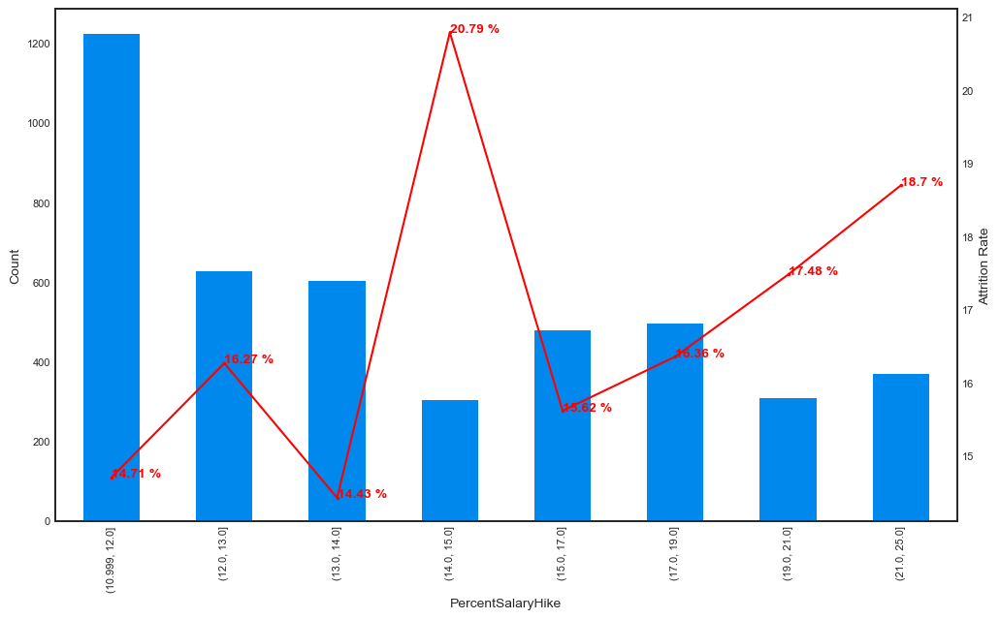

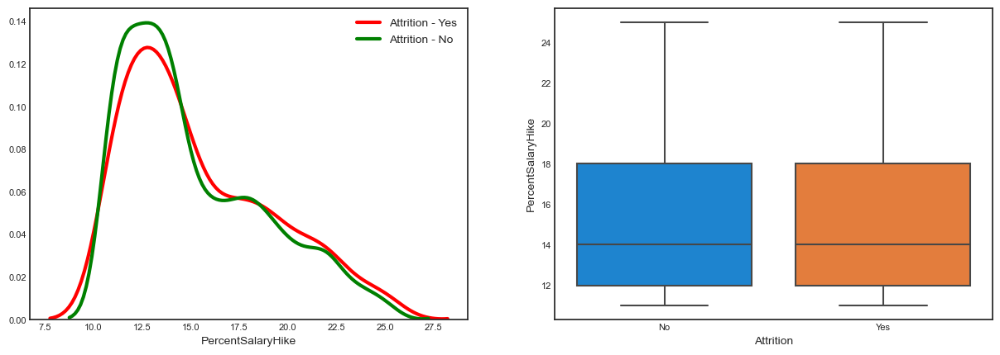

In [503]:
num_col = num_cols[4]

plt.figure(figsize=[12,7])
bins = pd.qcut(hr[num_col], 10,duplicates='drop') 

df = pd.crosstab(bins, hr[target],).reset_index()
df['Attrition_rate'] = round(df['Yes']*100/(df['Yes']+df['No']),2)
df.head()
df= df.set_index(num_col)
df['Count'] = df['Yes']+df['No']
ax1 = df['Count'].plot(kind='bar')
ax2 = ax1.twinx()
df['Attrition_rate'].plot(kind='line', style='.-',color='red', ax=ax2)
for index,data in enumerate(df['Attrition_rate'].values):
    plt.text(x=index , y =data ,  color='red', fontweight='bold', s=f"{data} %" )

ax1.set_ylabel("Count")
ax2.set_ylabel("Attrition Rate")

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 5))
sns.distplot(attrition_yes[num_col], ax=axes[0], hist=False, kde_kws={"color": "red", "lw": 3, "label": "Attrition - Yes"},)
sns.distplot(attrition_no[num_col], ax=axes[0], hist =False, kde_kws={"color": "green", "lw": 3, "label": "Attrition - No"},)
sns.boxplot(x="Attrition", y= num_col,data=hr,ax=axes[1])



- Usually majority of the employees a hike of 11% to 14% and the attrition tend to get increase with a hike of more than 17%
- Attrition is the highest among the employees who have received a hik eof 15%

<AxesSubplot:xlabel='Attrition', ylabel='StockOptionLevel'>

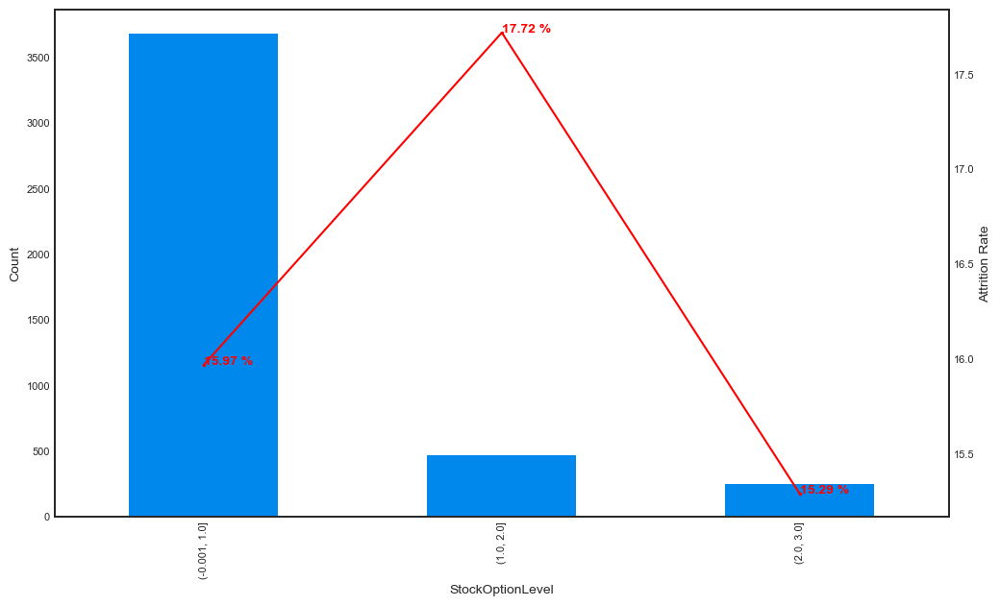

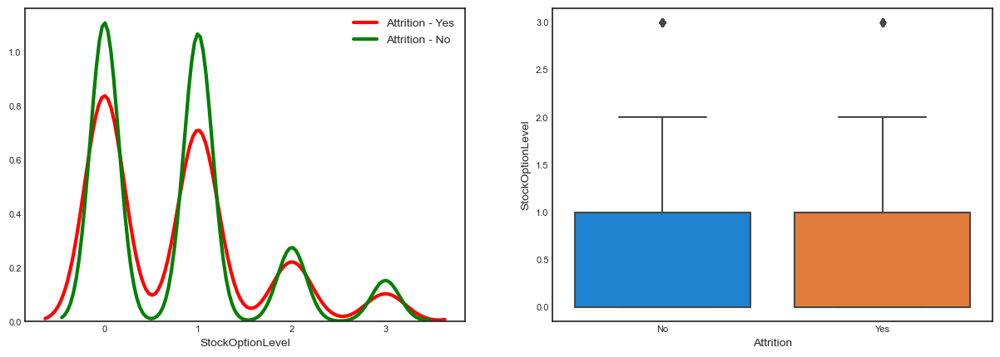

In [504]:
num_col = num_cols[5]

plt.figure(figsize=[12,7])
bins = pd.qcut(hr[num_col], 10,duplicates='drop') 

df = pd.crosstab(bins, hr[target],).reset_index()
df['Attrition_rate'] = round(df['Yes']*100/(df['Yes']+df['No']),2)
df.head()
df= df.set_index(num_col)
df['Count'] = df['Yes']+df['No']
ax1 = df['Count'].plot(kind='bar')
ax2 = ax1.twinx()
df['Attrition_rate'].plot(kind='line', style='.-',color='red', ax=ax2)
for index,data in enumerate(df['Attrition_rate'].values):
    plt.text(x=index , y =data ,  color='red', fontweight='bold', s=f"{data} %" )

ax1.set_ylabel("Count")
ax2.set_ylabel("Attrition Rate")

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 5))
sns.distplot(attrition_yes[num_col], ax=axes[0], hist=False, kde_kws={"color": "red", "lw": 3, "label": "Attrition - Yes"},)
sns.distplot(attrition_no[num_col], ax=axes[0], hist =False, kde_kws={"color": "green", "lw": 3, "label": "Attrition - No"},)
sns.boxplot(x="Attrition", y= num_col,data=hr,ax=axes[1])



- `StockOptionLevel` has almost no effect on attrition rate. It appears to be almost constant across different levels
-  Most of the employees have a `StockOptionLevel` of 1

<AxesSubplot:xlabel='Attrition', ylabel='TotalWorkingYears'>

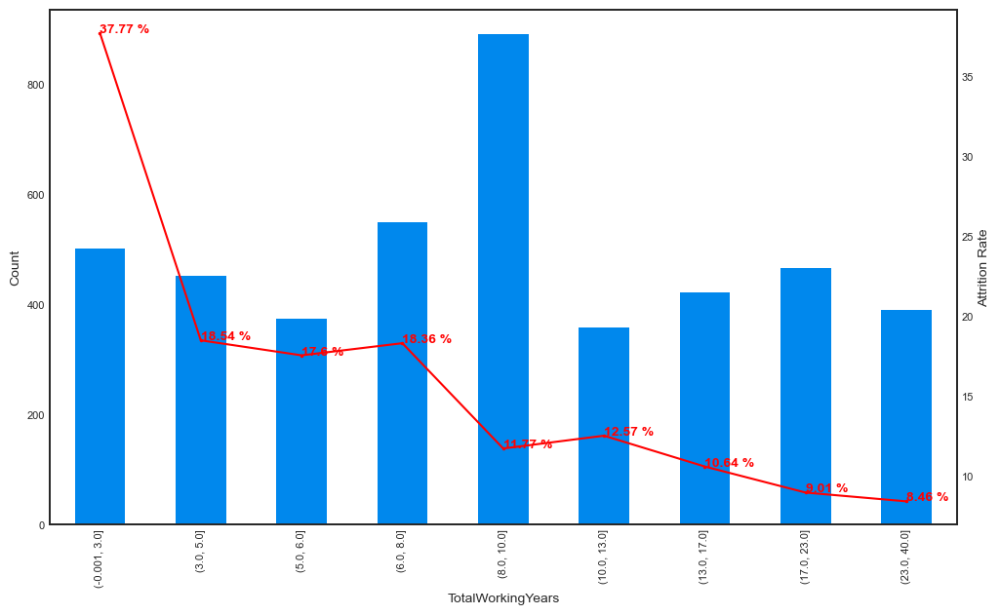

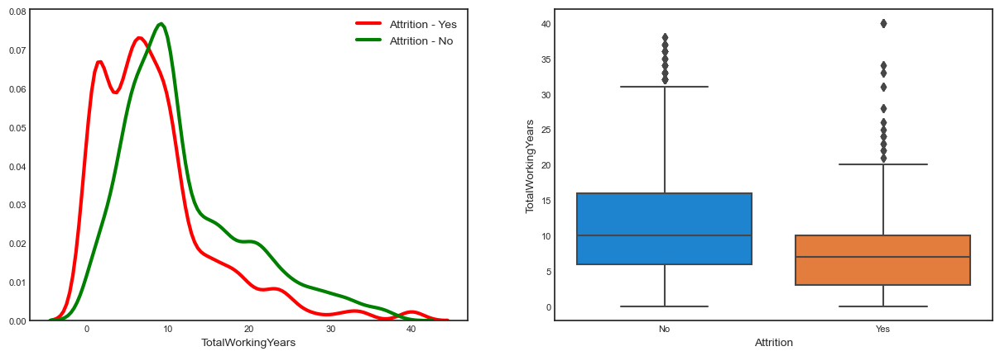

In [505]:
num_col = num_cols[6]

plt.figure(figsize=[12,7])
bins = pd.qcut(hr[num_col], 10,duplicates='drop') 

df = pd.crosstab(bins, hr[target],).reset_index()
df['Attrition_rate'] = round(df['Yes']*100/(df['Yes']+df['No']),2)
df.head()
df= df.set_index(num_col)
df['Count'] = df['Yes']+df['No']
ax1 = df['Count'].plot(kind='bar')
ax2 = ax1.twinx()
df['Attrition_rate'].plot(kind='line', style='.-',color='red', ax=ax2)
for index,data in enumerate(df['Attrition_rate'].values):
    plt.text(x=index , y =data ,  color='red', fontweight='bold', s=f"{data} %" )

ax1.set_ylabel("Count")
ax2.set_ylabel("Attrition Rate")

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 5))
sns.distplot(attrition_yes[num_col], ax=axes[0], hist=False, kde_kws={"color": "red", "lw": 3, "label": "Attrition - Yes"},)
sns.distplot(attrition_no[num_col], ax=axes[0], hist =False, kde_kws={"color": "green", "lw": 3, "label": "Attrition - No"},)
sns.boxplot(x="Attrition", y= num_col,data=hr,ax=axes[1])



- Attrition rate tends to decrease with increase in `TotalWorkingYears`
- It is highest among employees who have less than 3 years of Workexperience and the lowest among employees with more than 23 years of work experience.

<AxesSubplot:xlabel='Attrition', ylabel='TrainingTimesLastYear'>

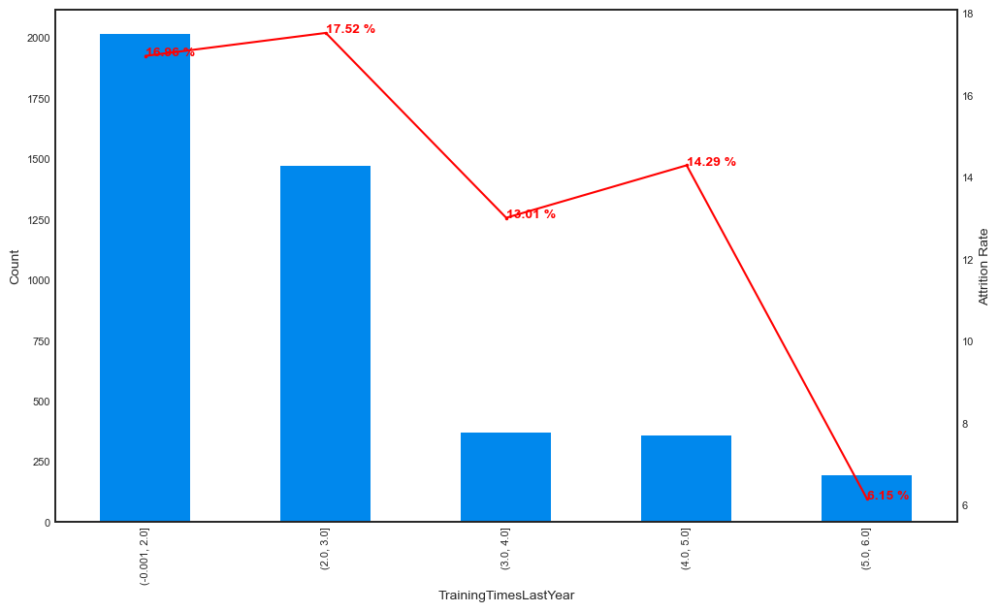

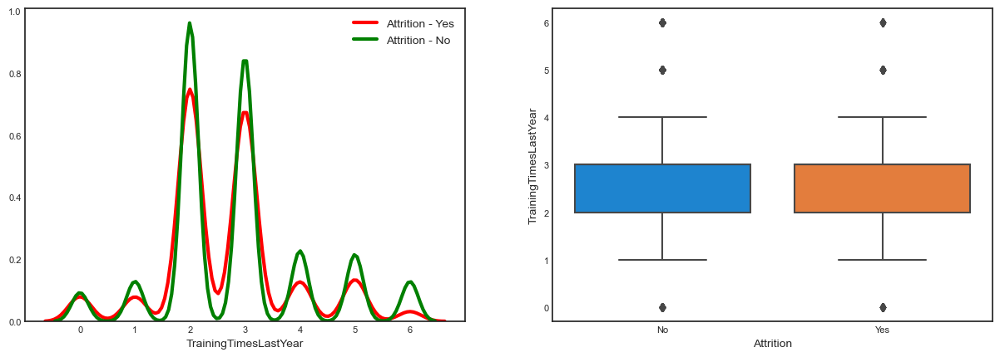

In [506]:
num_col = num_cols[7]

plt.figure(figsize=[12,7])
bins = pd.qcut(hr[num_col], 10,duplicates='drop') 

df = pd.crosstab(bins, hr[target],).reset_index()
df['Attrition_rate'] = round(df['Yes']*100/(df['Yes']+df['No']),2)
df.head()
df= df.set_index(num_col)
df['Count'] = df['Yes']+df['No']
ax1 = df['Count'].plot(kind='bar')
ax2 = ax1.twinx()
df['Attrition_rate'].plot(kind='line', style='.-',color='red', ax=ax2)
for index,data in enumerate(df['Attrition_rate'].values):
    plt.text(x=index , y =data ,  color='red', fontweight='bold', s=f"{data} %" )

ax1.set_ylabel("Count")
ax2.set_ylabel("Attrition Rate")

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 5))
sns.distplot(attrition_yes[num_col], ax=axes[0], hist=False, kde_kws={"color": "red", "lw": 3, "label": "Attrition - Yes"},)
sns.distplot(attrition_no[num_col], ax=axes[0], hist =False, kde_kws={"color": "green", "lw": 3, "label": "Attrition - No"},)
sns.boxplot(x="Attrition", y= num_col,data=hr,ax=axes[1])



- Employees who frequently get upskilled tend to stay with the company more and those who had a limited exposure to training (less than 3 `TrainingTimesLastYear`) tend to leave the company soon. 

<AxesSubplot:xlabel='Attrition', ylabel='YearsAtCompany'>

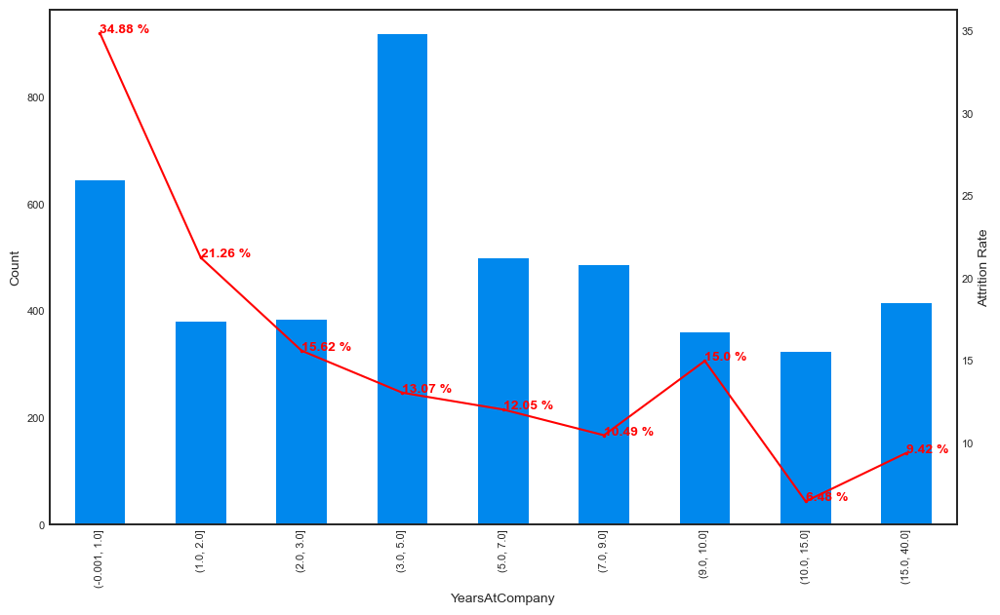

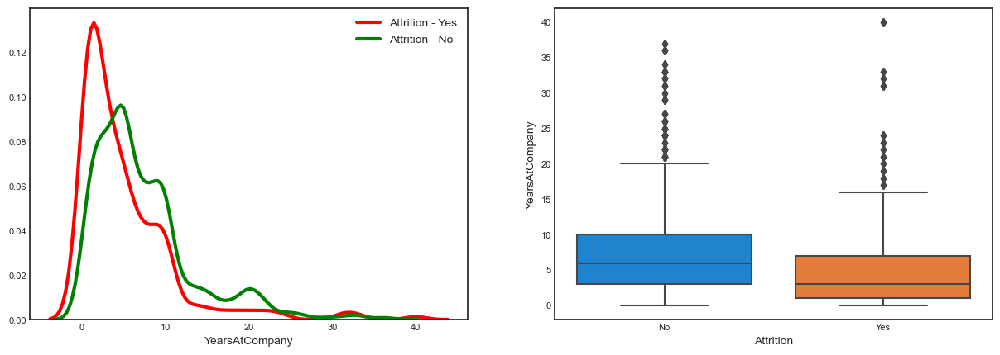

In [507]:
num_col = num_cols[8]

plt.figure(figsize=[12,7])
bins = pd.qcut(hr[num_col], 10,duplicates='drop') 

df = pd.crosstab(bins, hr[target],).reset_index()
df['Attrition_rate'] = round(df['Yes']*100/(df['Yes']+df['No']),2)
df.head()
df= df.set_index(num_col)
df['Count'] = df['Yes']+df['No']
ax1 = df['Count'].plot(kind='bar')
ax2 = ax1.twinx()
df['Attrition_rate'].plot(kind='line', style='.-',color='red', ax=ax2)
for index,data in enumerate(df['Attrition_rate'].values):
    plt.text(x=index , y =data ,  color='red', fontweight='bold', s=f"{data} %" )

ax1.set_ylabel("Count")
ax2.set_ylabel("Attrition Rate")

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 5))
sns.distplot(attrition_yes[num_col], ax=axes[0], hist=False, kde_kws={"color": "red", "lw": 3, "label": "Attrition - Yes"},)
sns.distplot(attrition_no[num_col], ax=axes[0], hist =False, kde_kws={"color": "green", "lw": 3, "label": "Attrition - No"},)
sns.boxplot(x="Attrition", y= num_col,data=hr,ax=axes[1])



- Employees who were loyal to the company and stayed for a long time tend to remain in the company 
- Attrition rate is highest for emloyees (almost 34.88%) who have stayed just an year or less with company

<AxesSubplot:xlabel='Attrition', ylabel='YearsSinceLastPromotion'>

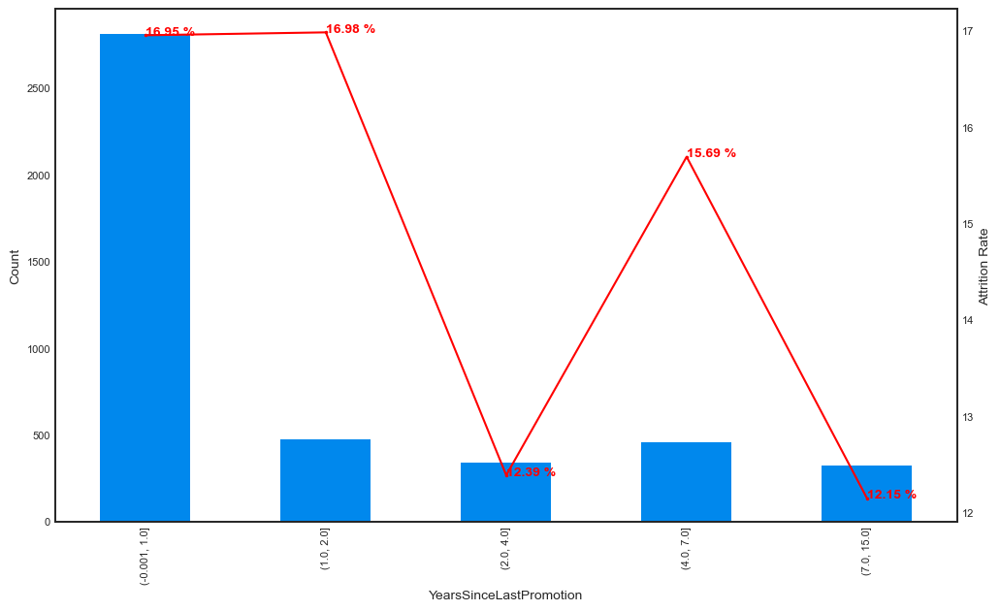

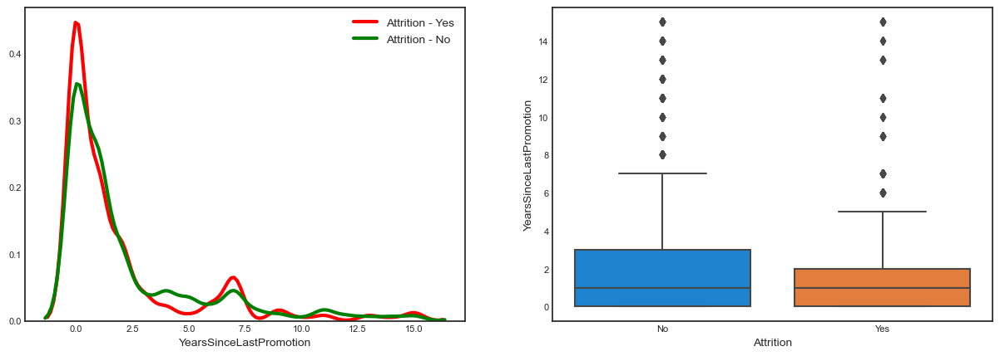

In [508]:
num_col = num_cols[9]

plt.figure(figsize=[12,7])
bins = pd.qcut(hr[num_col], 10,duplicates='drop') 

df = pd.crosstab(bins, hr[target],).reset_index()
df['Attrition_rate'] = round(df['Yes']*100/(df['Yes']+df['No']),2)
df.head()
df= df.set_index(num_col)
df['Count'] = df['Yes']+df['No']
ax1 = df['Count'].plot(kind='bar')
ax2 = ax1.twinx()
df['Attrition_rate'].plot(kind='line', style='.-',color='red', ax=ax2)
for index,data in enumerate(df['Attrition_rate'].values):
    plt.text(x=index , y =data ,  color='red', fontweight='bold', s=f"{data} %" )

ax1.set_ylabel("Count")
ax2.set_ylabel("Attrition Rate")

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 5))
sns.distplot(attrition_yes[num_col], ax=axes[0], hist=False, kde_kws={"color": "red", "lw": 3, "label": "Attrition - Yes"},)
sns.distplot(attrition_no[num_col], ax=axes[0], hist =False, kde_kws={"color": "green", "lw": 3, "label": "Attrition - No"},)
sns.boxplot(x="Attrition", y= num_col,data=hr,ax=axes[1])



- Employees who received a promotion last year of the year before tend to have a higher attrition rates

<AxesSubplot:xlabel='Attrition', ylabel='YearsWithCurrManager'>

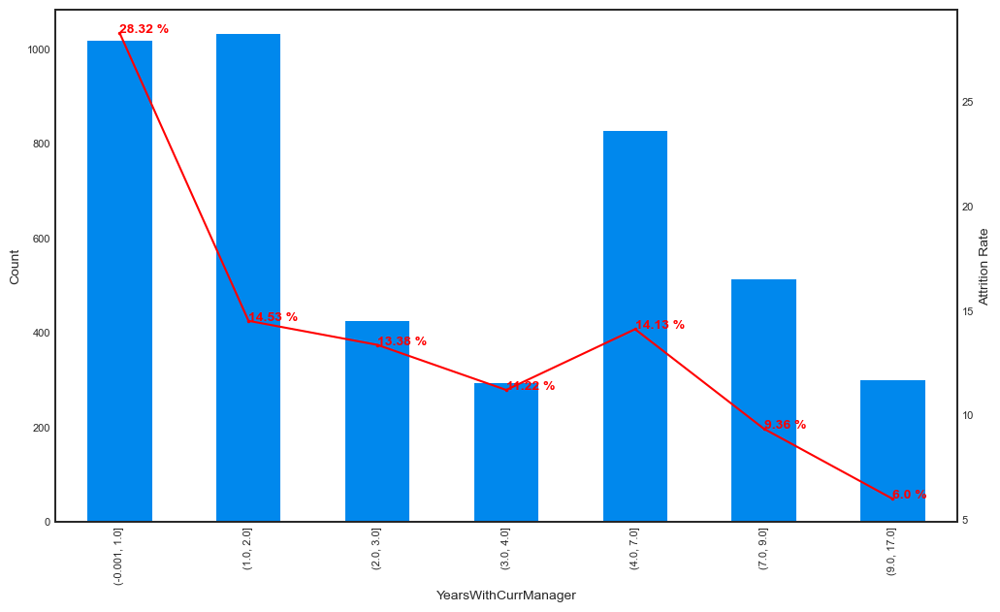

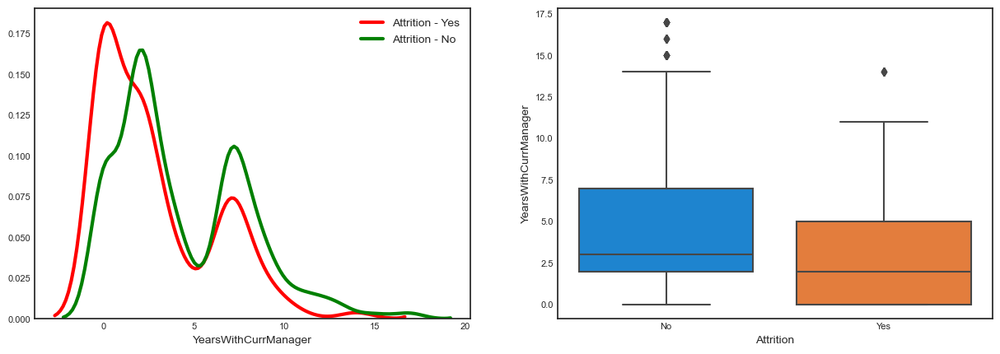

In [509]:
num_col = num_cols[10]

plt.figure(figsize=[12,7])
bins = pd.qcut(hr[num_col], 10,duplicates='drop') 

df = pd.crosstab(bins, hr[target],).reset_index()
df['Attrition_rate'] = round(df['Yes']*100/(df['Yes']+df['No']),2)
df.head()
df= df.set_index(num_col)
df['Count'] = df['Yes']+df['No']
ax1 = df['Count'].plot(kind='bar')
ax2 = ax1.twinx()
df['Attrition_rate'].plot(kind='line', style='.-',color='red', ax=ax2)
for index,data in enumerate(df['Attrition_rate'].values):
    plt.text(x=index , y =data ,  color='red', fontweight='bold', s=f"{data} %" )

ax1.set_ylabel("Count")
ax2.set_ylabel("Attrition Rate")

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 5))
sns.distplot(attrition_yes[num_col], ax=axes[0], hist=False, kde_kws={"color": "red", "lw": 3, "label": "Attrition - Yes"},)
sns.distplot(attrition_no[num_col], ax=axes[0], hist =False, kde_kws={"color": "green", "lw": 3, "label": "Attrition - No"},)
sns.boxplot(x="Attrition", y= num_col,data=hr,ax=axes[1])



- As one stays more years under the current manager, they tend to do not leave the organization
- Attrition rates are highest among the employees who have stayed less than a year with their current manager (almost 28.32%)

<AxesSubplot:xlabel='Attrition', ylabel='Q2 Time'>

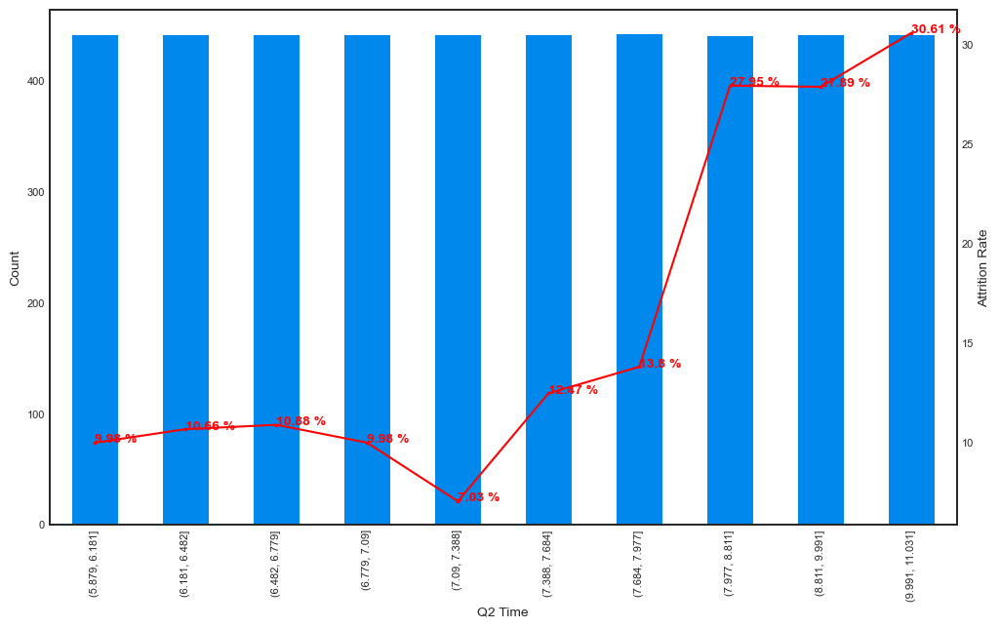

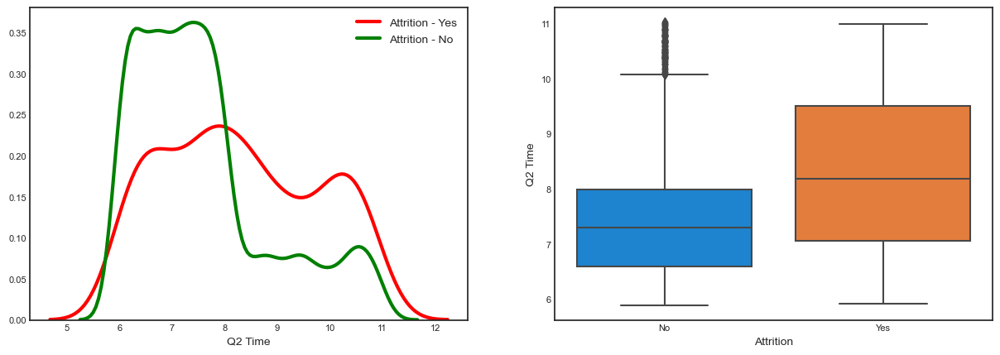

In [510]:
num_col = num_cols[11]

plt.figure(figsize=[12,7])
bins = pd.qcut(hr[num_col], 10,duplicates='drop') 

df = pd.crosstab(bins, hr[target],).reset_index()
df['Attrition_rate'] = round(df['Yes']*100/(df['Yes']+df['No']),2)
df.head()
df= df.set_index(num_col)
df['Count'] = df['Yes']+df['No']
ax1 = df['Count'].plot(kind='bar')
ax2 = ax1.twinx()
df['Attrition_rate'].plot(kind='line', style='.-',color='red', ax=ax2)
for index,data in enumerate(df['Attrition_rate'].values):
    plt.text(x=index , y =data ,  color='red', fontweight='bold', s=f"{data} %" )

ax1.set_ylabel("Count")
ax2.set_ylabel("Attrition Rate")

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 5))
sns.distplot(attrition_yes[num_col], ax=axes[0], hist=False, kde_kws={"color": "red", "lw": 3, "label": "Attrition - Yes"},)
sns.distplot(attrition_no[num_col], ax=axes[0], hist =False, kde_kws={"color": "green", "lw": 3, "label": "Attrition - No"},)
sns.boxplot(x="Attrition", y= num_col,data=hr,ax=axes[1])



- As expected employees who work more than 8 hrs have a higher risk of attrition

<AxesSubplot:>

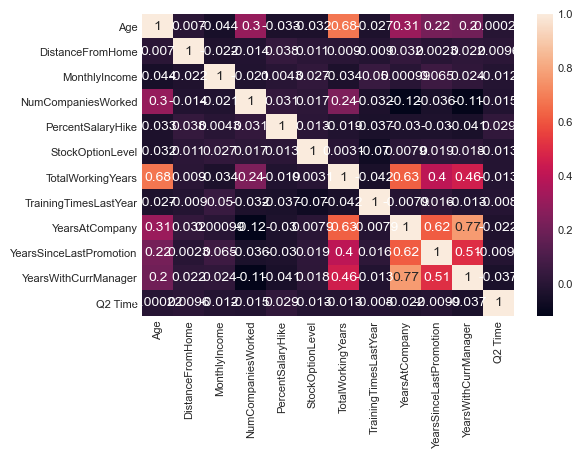

In [511]:
sns.heatmap(hr[num_cols].corr(),annot=True)

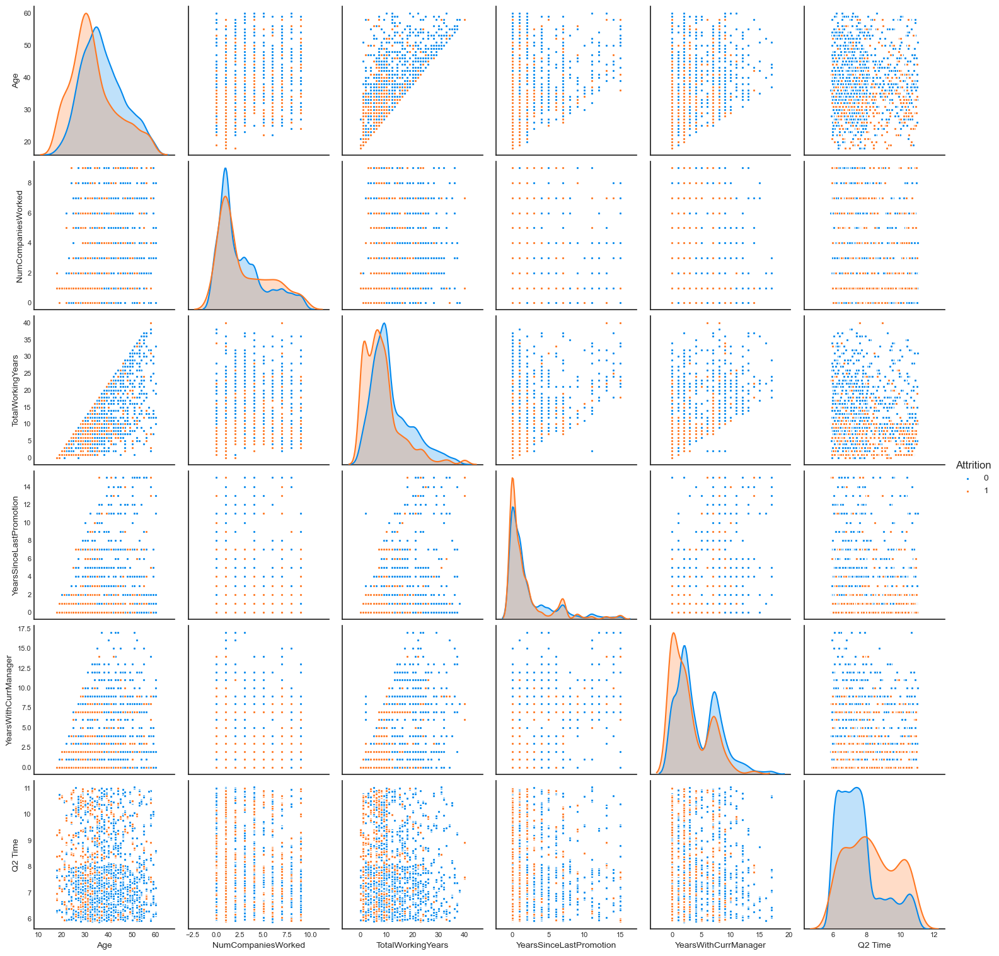

In [512]:
df_bivar_num = hr[num_cols]
df_bivar_num = df_bivar_num[['Age','NumCompaniesWorked','TotalWorkingYears','YearsSinceLastPromotion','YearsWithCurrManager','Q2 Time']]
df_bivar_num['Attrition'] = hr["Attrition"].replace({'Yes': 1, "No": 0})
sns.pairplot(df_bivar_num, hue='Attrition')

<AxesSubplot:>

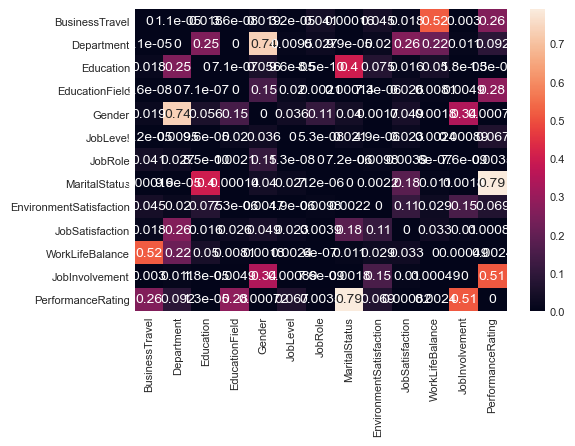

In [513]:

df = hr[obj_cols]
df.drop('Attrition',axis=1, inplace=True)
factors_paired = [(i,j) for i in df.columns.values for j in df.columns.values] 

chi2, p_values =[], []

for f in factors_paired:
    if f[0] != f[1]:
        chitest = chi2_contingency(pd.crosstab(df[f[0]], df[f[1]]))   
        chi2.append(chitest[0])
        p_values.append(chitest[1])
    else:      # for same factor pair
        chi2.append(0)
        p_values.append(0)

chi2 = np.array(chi2).reshape((13,13)) # shape it as a matrix
chi2 = pd.DataFrame(chi2, index=df.columns.values, columns=df.columns)


p_val = np.array(p_values).reshape((13,13)) # shape it as a matrix
p_val = pd.DataFrame(p_val, index=df.columns.values, columns=df.columns)

sns.heatmap(p_val, annot=True)

## Step 3: Data Preparation

In [514]:
round(hr[num_cols].describe(percentiles=[0.15,0.25,0.35,0.55,0.75,0.95]),2)

,Age,DistanceFromHome,MonthlyIncome,NumCompaniesWorked,PercentSalaryHike,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,YearsAtCompany,YearsSinceLastPromotion,YearsWithCurrManager,Q2 Time
count,4410.00,4410.00,4410.00,4410.00,4410.00,4410.00,4410.00,4410.00,4410.00,4410.00,4410.00,4410.00
mean,36.92,9.19,65029.31,2.69,15.21,0.79,11.26,2.80,7.01,2.19,4.12,7.68
std,9.13,8.11,47068.89,2.49,3.66,0.85,7.79,1.29,6.13,3.22,3.57,1.34
min,18.00,1.00,10090.00,0.00,11.00,0.00,0.00,0.00,0.00,0.00,0.00,5.88
15%,28.00,2.00,24760.00,1.00,12.00,0.00,4.00,2.00,2.00,0.00,0.00,6.32
25%,30.00,2.00,29110.00,1.00,12.00,0.00,6.00,2.00,3.00,0.00,2.00,6.65
35%,32.00,4.00,38120.00,1.00,13.00,0.00,7.00,2.00,4.00,0.00,2.00,6.93
50%,36.00,7.00,49190.00,2.00,14.00,1.00,10.00,3.00,5.00,1.00,3.00,7.39
55%,37.00,8.00,53290.00,2.00,14.00,1.00,10.00,3.00,6.00,1.00,3.00,7.56
75%,43.00,14.00,83800.00,4.00,18.00,1.00,15.00,3.00,9.00,3.00,7.00,8.34


In [515]:
Q1 = hr[num_cols].quantile(0.25)
Q3 = hr[num_cols].quantile(0.75)
IQR = Q3 - Q1
lowerwhisker=(Q1 - 1.5 * IQR)
upperwhisker=(Q3 + 1.5 * IQR)

outlier_count = ((hr[num_cols] < (Q1 - 1.5 * IQR)) | (hr[num_cols] > (Q3 + 1.5 * IQR))).sum()
print(outlier_count)

Age                          0
DistanceFromHome             0
MonthlyIncome              342
NumCompaniesWorked         156
PercentSalaryHike            0
StockOptionLevel           255
TotalWorkingYears          189
TrainingTimesLastYear      714
YearsAtCompany             312
YearsSinceLastPromotion    321
YearsWithCurrManager        42
Q2 Time                     51
dtype: int64


In [516]:
hr.to_csv("final_dataset_hr.csv",index=False)


In [517]:
hr =pd.read_csv("final_dataset_hr.csv")

### One Hot Encoding of Categorical variables

In [518]:
# Creating a dummy variable for some of the categorical variables and dropping the first one.
obj_cols.remove('Attrition')
dummy1 = pd.get_dummies(hr[obj_cols], prefix= obj_cols, drop_first=True)

# Adding the results to the master dataframe
hr = pd.concat([hr, dummy1], axis=1)
hr.shape

(4410, 67)

In [519]:
hr.head()

,Age,Attrition,BusinessTravel,Department,DistanceFromHome,Education,EducationField,Gender,JobLevel,JobRole,MaritalStatus,MonthlyIncome,NumCompaniesWorked,PercentSalaryHike,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,YearsAtCompany,YearsSinceLastPromotion,YearsWithCurrManager,EnvironmentSatisfaction,JobSatisfaction,WorkLifeBalance,JobInvolvement,PerformanceRating,Q2 Time,BusinessTravel_Travel_Frequently,BusinessTravel_Travel_Rarely,Department_Research & Development,Department_Sales,Education_Below College,Education_College,Education_Doctor,Education_Master,EducationField_Life Sciences,EducationField_Marketing,EducationField_Medical,EducationField_Other,EducationField_Technical Degree,Gender_Male,JobLevel_Level_2,JobLevel_Level_3,JobLevel_Level_4,JobLevel_Level_5,JobRole_Human Resources,JobRole_Laboratory Technician,JobRole_Manager,JobRole_Manufacturing Director,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative,MaritalStatus_Married,MaritalStatus_Single,EnvironmentSatisfaction_Low,EnvironmentSatisfaction_Medium,EnvironmentSatisfaction_Very High,JobSatisfaction_Low,JobSatisfaction_Medium,JobSatisfaction_Very High,WorkLifeBalance_Best,WorkLifeBalance_Better,WorkLifeBalance_Good,JobInvolvement_Low,JobInvolvement_Medium,JobInvolvement_Very High,PerformanceRating_Outstanding
0,51,No,Travel_Rarely,Sales,6,College,Life Sciences,Female,Level_1,Healthcare Representative,Married,131160,1.0,11,0,1.0,6,1,0,0,High,Very High,Good,High,Excellent,7.365000,0,1,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0
1,31,Yes,Travel_Frequently,Research & Development,10,Below College,Life Sciences,Female,Level_1,Research Scientist,Single,41890,0.0,23,1,6.0,3,5,1,4,High,Medium,Best,Medium,Outstanding,7.703611,1,0,1,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,1,0,0,0,1,0,1
2,32,No,Travel_Frequently,Research & Development,17,Master,Other,Male,Level_4,Sales Executive,Married,193280,1.0,15,3,5.0,2,5,0,3,Medium,Medium,Bad,High,Excellent,6.977500,1,0,1,0,0,0,0,1,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0
3,38,No,Non-Travel,Research & Development,2,Doctor,Life Sciences,Male,Level_3,Human Resources,Married,83210,3.0,11,3,13.0,5,8,7,5,Very High,Very High,Better,Medium,Excellent,7.157222,0,0,1,0,0,0,1,0,1,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,1,0,0
4,32,No,Travel_Rarely,Research & Development,10,Below College,Medical,Male,Level_1,Sales Executive,Single,23420,4.0,12,2,9.0,2,6,0,4,Very High,Low,Better,High,Excellent,7.953611,0,1,1,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,1,0,0,0,1,0,0,0,0,0


In [520]:
#We have created dummies for the below variables, so we can drop them
hr = hr.drop(columns= obj_cols, axis=1)
hr.shape

(4410, 54)

In [521]:
hr.head()

,Age,Attrition,DistanceFromHome,MonthlyIncome,NumCompaniesWorked,PercentSalaryHike,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,YearsAtCompany,YearsSinceLastPromotion,YearsWithCurrManager,Q2 Time,BusinessTravel_Travel_Frequently,BusinessTravel_Travel_Rarely,Department_Research & Development,Department_Sales,Education_Below College,Education_College,Education_Doctor,Education_Master,EducationField_Life Sciences,EducationField_Marketing,EducationField_Medical,EducationField_Other,EducationField_Technical Degree,Gender_Male,JobLevel_Level_2,JobLevel_Level_3,JobLevel_Level_4,JobLevel_Level_5,JobRole_Human Resources,JobRole_Laboratory Technician,JobRole_Manager,JobRole_Manufacturing Director,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative,MaritalStatus_Married,MaritalStatus_Single,EnvironmentSatisfaction_Low,EnvironmentSatisfaction_Medium,EnvironmentSatisfaction_Very High,JobSatisfaction_Low,JobSatisfaction_Medium,JobSatisfaction_Very High,WorkLifeBalance_Best,WorkLifeBalance_Better,WorkLifeBalance_Good,JobInvolvement_Low,JobInvolvement_Medium,JobInvolvement_Very High,PerformanceRating_Outstanding
0,51,No,6,131160,1.0,11,0,1.0,6,1,0,0,7.365000,0,1,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0
1,31,Yes,10,41890,0.0,23,1,6.0,3,5,1,4,7.703611,1,0,1,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,1,0,0,0,1,0,1
2,32,No,17,193280,1.0,15,3,5.0,2,5,0,3,6.977500,1,0,1,0,0,0,0,1,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0
3,38,No,2,83210,3.0,11,3,13.0,5,8,7,5,7.157222,0,0,1,0,0,0,1,0,1,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,1,0,0
4,32,No,10,23420,4.0,12,2,9.0,2,6,0,4,7.953611,0,1,1,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,1,0,0,0,1,0,0,0,0,0


## Mapping Attrition to 1/0 

In [522]:
hr['Attrition'] = hr['Attrition'].replace({'Yes': 1, "No": 0})

In [523]:
hr.head()

,Age,Attrition,DistanceFromHome,MonthlyIncome,NumCompaniesWorked,PercentSalaryHike,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,YearsAtCompany,YearsSinceLastPromotion,YearsWithCurrManager,Q2 Time,BusinessTravel_Travel_Frequently,BusinessTravel_Travel_Rarely,Department_Research & Development,Department_Sales,Education_Below College,Education_College,Education_Doctor,Education_Master,EducationField_Life Sciences,EducationField_Marketing,EducationField_Medical,EducationField_Other,EducationField_Technical Degree,Gender_Male,JobLevel_Level_2,JobLevel_Level_3,JobLevel_Level_4,JobLevel_Level_5,JobRole_Human Resources,JobRole_Laboratory Technician,JobRole_Manager,JobRole_Manufacturing Director,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative,MaritalStatus_Married,MaritalStatus_Single,EnvironmentSatisfaction_Low,EnvironmentSatisfaction_Medium,EnvironmentSatisfaction_Very High,JobSatisfaction_Low,JobSatisfaction_Medium,JobSatisfaction_Very High,WorkLifeBalance_Best,WorkLifeBalance_Better,WorkLifeBalance_Good,JobInvolvement_Low,JobInvolvement_Medium,JobInvolvement_Very High,PerformanceRating_Outstanding
0,51,0,6,131160,1.0,11,0,1.0,6,1,0,0,7.365000,0,1,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0
1,31,1,10,41890,0.0,23,1,6.0,3,5,1,4,7.703611,1,0,1,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,1,0,0,0,1,0,1
2,32,0,17,193280,1.0,15,3,5.0,2,5,0,3,6.977500,1,0,1,0,0,0,0,1,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0
3,38,0,2,83210,3.0,11,3,13.0,5,8,7,5,7.157222,0,0,1,0,0,0,1,0,1,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,1,0,0
4,32,0,10,23420,4.0,12,2,9.0,2,6,0,4,7.953611,0,1,1,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,1,0,0,0,1,0,0,0,0,0


In [524]:
hr.shape

(4410, 54)

## Step 4: Splitting the Data into Training and Testing Sets


In [525]:

# Putting feature variable to X
X = hr.drop(['Attrition'], axis=1)

X.head()

,Age,DistanceFromHome,MonthlyIncome,NumCompaniesWorked,PercentSalaryHike,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,YearsAtCompany,YearsSinceLastPromotion,YearsWithCurrManager,Q2 Time,BusinessTravel_Travel_Frequently,BusinessTravel_Travel_Rarely,Department_Research & Development,Department_Sales,Education_Below College,Education_College,Education_Doctor,Education_Master,EducationField_Life Sciences,EducationField_Marketing,EducationField_Medical,EducationField_Other,EducationField_Technical Degree,Gender_Male,JobLevel_Level_2,JobLevel_Level_3,JobLevel_Level_4,JobLevel_Level_5,JobRole_Human Resources,JobRole_Laboratory Technician,JobRole_Manager,JobRole_Manufacturing Director,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative,MaritalStatus_Married,MaritalStatus_Single,EnvironmentSatisfaction_Low,EnvironmentSatisfaction_Medium,EnvironmentSatisfaction_Very High,JobSatisfaction_Low,JobSatisfaction_Medium,JobSatisfaction_Very High,WorkLifeBalance_Best,WorkLifeBalance_Better,WorkLifeBalance_Good,JobInvolvement_Low,JobInvolvement_Medium,JobInvolvement_Very High,PerformanceRating_Outstanding
0,51,6,131160,1.0,11,0,1.0,6,1,0,0,7.365000,0,1,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0
1,31,10,41890,0.0,23,1,6.0,3,5,1,4,7.703611,1,0,1,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,1,0,0,0,1,0,1
2,32,17,193280,1.0,15,3,5.0,2,5,0,3,6.977500,1,0,1,0,0,0,0,1,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0
3,38,2,83210,3.0,11,3,13.0,5,8,7,5,7.157222,0,0,1,0,0,0,1,0,1,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,1,0,0
4,32,10,23420,4.0,12,2,9.0,2,6,0,4,7.953611,0,1,1,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,1,0,0,0,1,0,0,0,0,0


In [526]:
X.shape

(4410, 53)

In [527]:
# Putting response variable to y
y = hr['Attrition']

y.head()

0    0
1    1
2    0
3    0
4    0
Name: Attrition, dtype: int64

In [528]:
y.shape

(4410,)

In [529]:
# Splitting the data into train and test
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.7, test_size=0.3, random_state=100,stratify=y,shuffle=True)

### Class imbalance

In [530]:
y_train_rows = y_train.shape[0]
y_train_0 = y_train[y_train==0].shape[0]
y_train_1 = y_train[y_train==1].shape[0]
print("Class 0 proportion : ", round((y_train_0*100/y_train_rows),2)," %")
print("Class 1 proportion : ", round((y_train_1*100/y_train_rows),2)," %")

Class 0 proportion :  83.87  %
Class 1 proportion :  16.13  %


In [531]:
y_test_rows = y_test.shape[0]
y_test_0 = y_test[y_test==0].shape[0]
y_test_1 = y_test[y_test==1].shape[0]
print("Class 0 proportion : ", round((y_test_0*100/y_test_rows),2)," %")
print("Class 1 proportion : ", round((y_test_1*100/y_test_rows),2)," %")

Class 0 proportion :  83.9  %
Class 1 proportion :  16.1  %


## Step 5: Scaling the train data

In [532]:

scaler = RobustScaler()
scale_cols = num_cols

In [533]:
X_train[scale_cols]=scaler.fit_transform(X_train[scale_cols])

In [534]:
X_train.head()

,Age,DistanceFromHome,MonthlyIncome,NumCompaniesWorked,PercentSalaryHike,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,YearsAtCompany,YearsSinceLastPromotion,YearsWithCurrManager,Q2 Time,BusinessTravel_Travel_Frequently,BusinessTravel_Travel_Rarely,Department_Research & Development,Department_Sales,Education_Below College,Education_College,Education_Doctor,Education_Master,EducationField_Life Sciences,EducationField_Marketing,EducationField_Medical,EducationField_Other,EducationField_Technical Degree,Gender_Male,JobLevel_Level_2,JobLevel_Level_3,JobLevel_Level_4,JobLevel_Level_5,JobRole_Human Resources,JobRole_Laboratory Technician,JobRole_Manager,JobRole_Manufacturing Director,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative,MaritalStatus_Married,MaritalStatus_Single,EnvironmentSatisfaction_Low,EnvironmentSatisfaction_Medium,EnvironmentSatisfaction_Very High,JobSatisfaction_Low,JobSatisfaction_Medium,JobSatisfaction_Very High,WorkLifeBalance_Best,WorkLifeBalance_Better,WorkLifeBalance_Good,JobInvolvement_Low,JobInvolvement_Medium,JobInvolvement_Very High,PerformanceRating_Outstanding
3818,-0.615385,-0.500000,-0.479373,-0.333333,0.333333,0.0,-0.888889,-1.0,-0.666667,-0.5,-0.6,0.601334,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0
1575,-0.230769,1.750000,0.137580,-0.333333,1.166667,0.0,-1.000000,0.0,-0.666667,-0.5,-0.6,1.826122,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,1,0,0,1
1167,-0.230769,-0.333333,-0.636551,-0.666667,0.000000,-1.0,0.000000,-1.0,0.666667,3.5,-0.4,0.998048,0,1,0,1,0,0,0,1,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,1,0,0,1,0,0
518,-1.230769,0.083333,-0.273395,-0.333333,1.000000,-1.0,-0.888889,0.0,-0.500000,-0.5,-0.2,1.009759,1,0,0,1,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,0,0,1,0,1,0,0,1,0,1
2315,0.923077,0.416667,0.137776,2.000000,-0.166667,0.0,0.888889,-1.0,0.500000,3.0,0.8,0.278790,0,1,1,0,0,0,0,1,0,0,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0


## Step 6: Building a linear model

### Visualising train data with PCA

In [535]:
#Obtain principal components
pca = PCA().fit(X_train)

pc = pca.transform(X_train)
df=pd.DataFrame(pc)
df.head()



,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52
0,-1.917977,-0.773513,-0.828727,-0.595051,-0.612808,-0.043614,0.296735,-0.220006,-0.228794,-0.016413,-0.629964,0.623573,-1.100909,0.058310,0.008790,-0.448256,-0.627246,0.563895,0.328572,-0.160670,0.118729,0.494858,-0.622717,0.559201,0.253055,0.458245,-0.092839,-0.379945,-0.361567,-0.138924,0.310547,0.220174,-0.108842,-0.104005,-0.036514,0.237823,-0.269484,0.384058,-0.087350,-0.030815,0.013708,0.198164,-0.046687,-0.069194,-0.099403,0.036413,-0.005255,0.102545,-0.050515,0.567174,-0.018985,-0.012597,0.214155
1,-1.958076,0.219563,-0.790197,-0.274571,-0.329985,-0.059728,1.868232,1.390071,1.177336,-0.015425,0.506687,0.311568,-0.125390,-0.598000,-0.853421,0.470559,-0.377622,-0.358054,0.581507,-0.120238,0.073243,0.324048,-0.281882,-0.408272,0.006904,-0.135990,-0.396517,0.372344,0.576873,0.135142,-0.221437,-0.148118,0.057031,-0.658696,0.184903,0.418990,0.739240,-0.431574,0.157861,-0.563643,-0.351667,0.066666,-0.361616,0.534466,-0.115304,-0.303676,-0.072484,0.675283,0.166898,0.645543,0.013258,-0.021050,-0.183815
2,2.166176,-0.558932,-1.615236,-0.799150,-1.186146,-1.355317,0.660124,-0.812120,0.255374,0.060705,-1.062783,0.625441,-0.662722,-0.269893,-0.281418,-0.206530,1.289463,-0.107131,-0.065816,0.265945,-0.241455,-0.033500,0.572720,0.766107,0.048585,-0.513903,-0.093354,-0.174247,0.134877,-0.536319,0.285292,0.560279,0.098227,0.151858,-0.242516,0.068541,-0.245772,-0.281137,0.272537,0.094872,0.146230,-0.100549,0.022706,0.050126,-0.039029,0.057576,0.055879,0.062696,-0.048698,-0.103905,0.041171,0.305397,-0.007001
3,-1.901850,0.323300,-1.069005,-1.076358,-0.247609,-0.803354,0.786077,0.275541,0.763597,1.594952,0.550342,0.197072,-0.238192,0.204497,0.248575,1.198459,0.779505,-0.314701,0.073248,-0.159326,0.506252,-0.587058,0.590309,0.220864,0.097168,-0.192893,0.502739,0.547614,-0.276100,0.080079,0.130343,0.457500,0.164154,-0.237366,0.042458,-0.491721,-0.227719,-0.002400,-0.117211,-0.106668,-0.145511,-0.238824,0.174365,0.031195,0.042414,-0.313245,-0.111240,0.045538,-0.033539,-0.053648,0.002483,-0.019704,0.004275
4,2.467245,-0.839065,0.572730,1.222428,-1.397247,-0.184734,0.023081,0.061190,0.026652,-0.674750,0.466459,0.567099,-0.227096,0.498963,-0.261637,-0.279480,0.615429,-0.043770,-0.750464,0.531995,-0.050763,0.022227,-0.390079,0.380493,-0.390468,0.569101,-0.593431,-0.178278,-0.198957,-0.013771,0.173608,-0.090992,-0.315847,0.284337,0.226075,0.112557,0.378734,0.116175,-0.392085,0.104971,-0.065962,0.143805,-0.107975,-0.170160,-0.072493,-0.110030,-0.050778,-0.068820,0.013908,0.033138,-0.016275,-0.018518,0.002386


Text(0, 0.5, 'PC2')

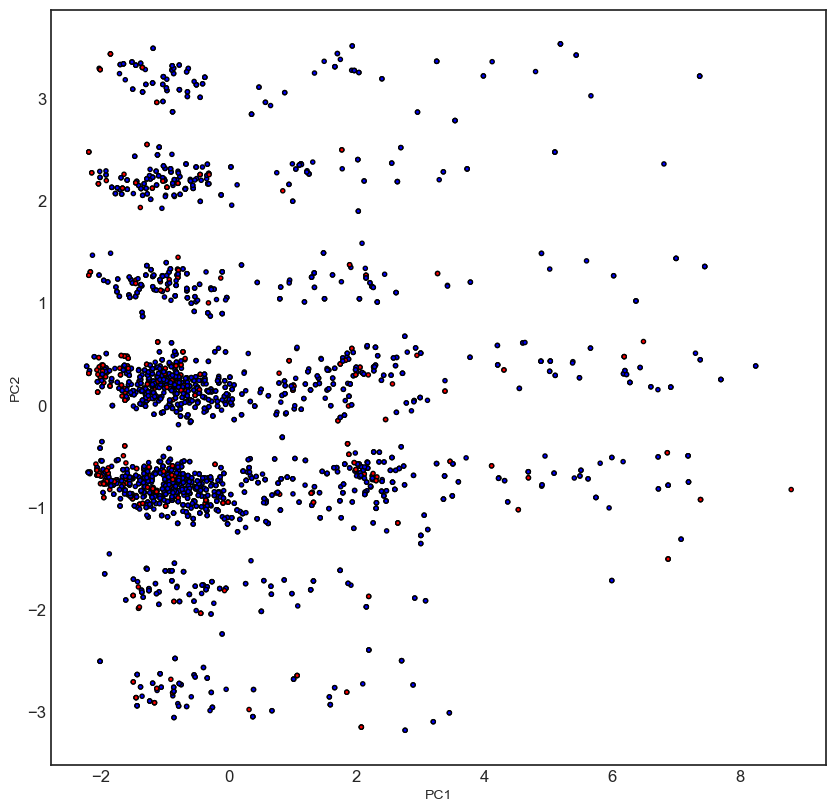

In [536]:
pc1 = pc[:,0]
pc2 = pc[:,1]

#Plot principal components
plt.figure(figsize=(10,10))

colour = ['red' if attr == 1 else 'blue' for attr in y_train]
plt.scatter(pc1,pc2 ,c=colour,edgecolors='#000000')
plt.yticks(size=12)
plt.xticks(size=12)
plt.xlabel('PC1')
plt.ylabel('PC2')

In [537]:

tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_results = tsne.fit_transform(X_train)


[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 3087 samples in 0.118s...
[t-SNE] Computed neighbors for 3087 samples in 1.768s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3087
[t-SNE] Computed conditional probabilities for sample 2000 / 3087
[t-SNE] Computed conditional probabilities for sample 3000 / 3087
[t-SNE] Computed conditional probabilities for sample 3087 / 3087
[t-SNE] Mean sigma: 1.785047
[t-SNE] KL divergence after 250 iterations with early exaggeration: 78.484512
[t-SNE] KL divergence after 300 iterations: 2.344920


Text(0, 0.5, 'PC2')

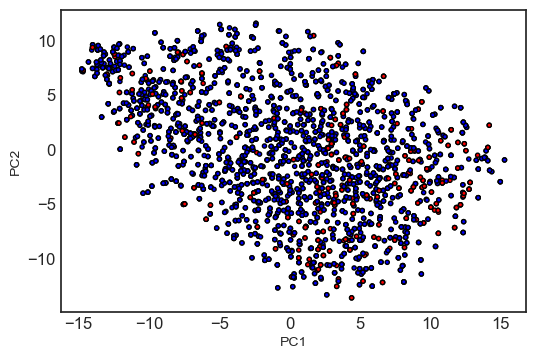

In [538]:

tsne1= tsne_results[:,0]
tsne2 = tsne_results[:,1]

colour = ['red' if attr == 1 else 'blue' for attr in y_train]
plt.scatter(tsne1,tsne2 ,c=colour,edgecolors='#000000')
plt.yticks(size=12)
plt.xticks(size=12)
plt.xlabel('PC1')
plt.ylabel('PC2')

### Feature Selection

In [539]:


#  Create a logistic regression estimator 
logreg = lm.LogisticRegression()

# Use RFECV to pick best features, using Stratified Kfold
rfecv =   RFECV(logreg, cv=5, scoring='roc_auc')


In [540]:

selector = rfecv.fit(X_train, y_train)
selector.support_


array([ True,  True, False,  True, False, False,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True, False,  True,
        True, False,  True,  True,  True,  True,  True, False,  True,
       False, False,  True,  True,  True, False,  True,  True,  True,
        True,  True,  True,  True,  True, False,  True,  True, False,
        True,  True,  True,  True, False,  True,  True, False])

In [541]:
selector.ranking_

array([ 1,  1, 13,  1, 11,  6,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1, 10,
        1,  1,  8,  1,  1,  1,  1,  1,  2,  1,  4, 14,  1,  1,  1,  9,  1,
        1,  1,  1,  1,  1,  1,  1,  7,  1,  1,  5,  1,  1,  1,  1,  3,  1,
        1, 12])

In [542]:
list(zip(X_train.columns,rfecv.support_,rfecv.ranking_))

[('Age', True, 1),
 ('DistanceFromHome', True, 1),
 ('MonthlyIncome', False, 13),
 ('NumCompaniesWorked', True, 1),
 ('PercentSalaryHike', False, 11),
 ('StockOptionLevel', False, 6),
 ('TotalWorkingYears', True, 1),
 ('TrainingTimesLastYear', True, 1),
 ('YearsAtCompany', True, 1),
 ('YearsSinceLastPromotion', True, 1),
 ('YearsWithCurrManager', True, 1),
 ('Q2 Time', True, 1),
 ('BusinessTravel_Travel_Frequently', True, 1),
 ('BusinessTravel_Travel_Rarely', True, 1),
 ('Department_Research & Development', True, 1),
 ('Department_Sales', True, 1),
 ('Education_Below College', False, 10),
 ('Education_College', True, 1),
 ('Education_Doctor', True, 1),
 ('Education_Master', False, 8),
 ('EducationField_Life Sciences', True, 1),
 ('EducationField_Marketing', True, 1),
 ('EducationField_Medical', True, 1),
 ('EducationField_Other', True, 1),
 ('EducationField_Technical Degree', True, 1),
 ('Gender_Male', False, 2),
 ('JobLevel_Level_2', True, 1),
 ('JobLevel_Level_3', False, 4),
 ('JobLe

In [543]:
print("Optimal number of features from RFECV :")
print(selector.n_features_)

Optimal number of features from RFECV :
40


### Method 2: Feature selection  using cross val

In [544]:

cv_scores =[]

In [545]:
total_cols = len(X_train.columns)

In [546]:
for features in range(1,total_cols+1):
    rfe = RFE(logreg, features)
    scores = cross_val_score(rfe, X_train, y_train,cv= 5) # consists of array of 5 values for 5 folds at each iteration
    cv_scores.append(scores)

In [547]:
cv_scores

[array([0.8381877 , 0.8381877 , 0.83792545, 0.83954619, 0.83954619]),
 array([0.8381877 , 0.8381877 , 0.83792545, 0.83954619, 0.83954619]),
 array([0.8381877 , 0.8381877 , 0.83792545, 0.84278768, 0.83954619]),
 array([0.83980583, 0.83333333, 0.83792545, 0.83954619, 0.84116694]),
 array([0.83980583, 0.83495146, 0.83792545, 0.83954619, 0.83792545]),
 array([0.84142395, 0.83495146, 0.83792545, 0.83792545, 0.84116694]),
 array([0.85113269, 0.83495146, 0.83954619, 0.83468395, 0.84278768]),
 array([0.84466019, 0.83656958, 0.84278768, 0.8363047 , 0.84927066]),
 array([0.84304207, 0.8381877 , 0.83954619, 0.83306321, 0.84764992]),
 array([0.83980583, 0.83980583, 0.84116694, 0.84116694, 0.8541329 ]),
 array([0.83980583, 0.85436893, 0.84440843, 0.83954619, 0.84764992]),
 array([0.85275081, 0.85598706, 0.84116694, 0.83954619, 0.8541329 ]),
 array([0.85113269, 0.85598706, 0.8541329 , 0.84116694, 0.85575365]),
 array([0.85598706, 0.85275081, 0.85575365, 0.8541329 , 0.86223663]),
 array([0.85760518, 

In [548]:
mean_cv_score =[]
for score in cv_scores:
    mean_cv_score.append(score.mean())

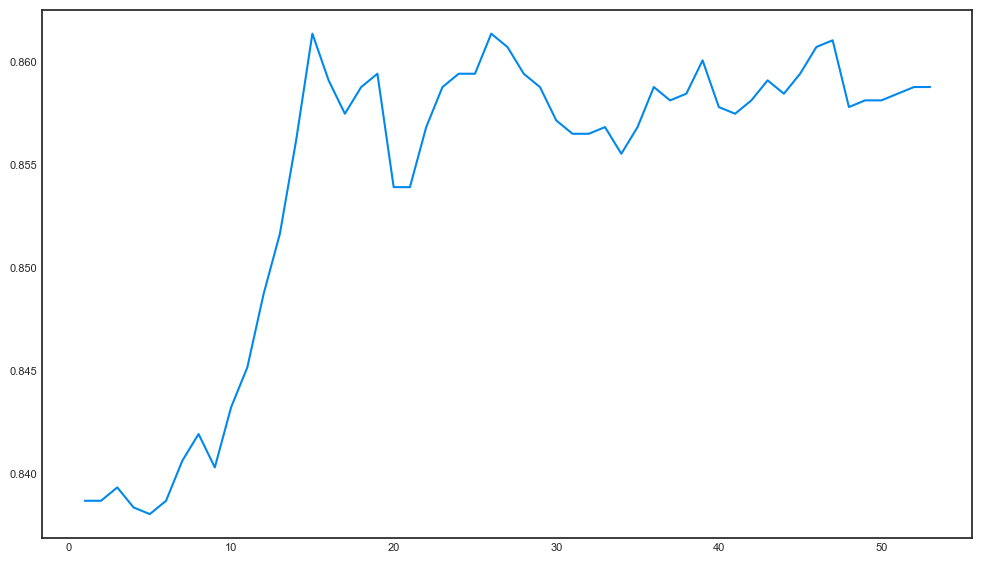

In [549]:
plt.figure(figsize=[12,7])
plt.plot(range(1,total_cols+1),mean_cv_score)

### Method 3: Feature Importance using DecisionTreeClassifier, RandomForestClassifier

<AxesSubplot:>

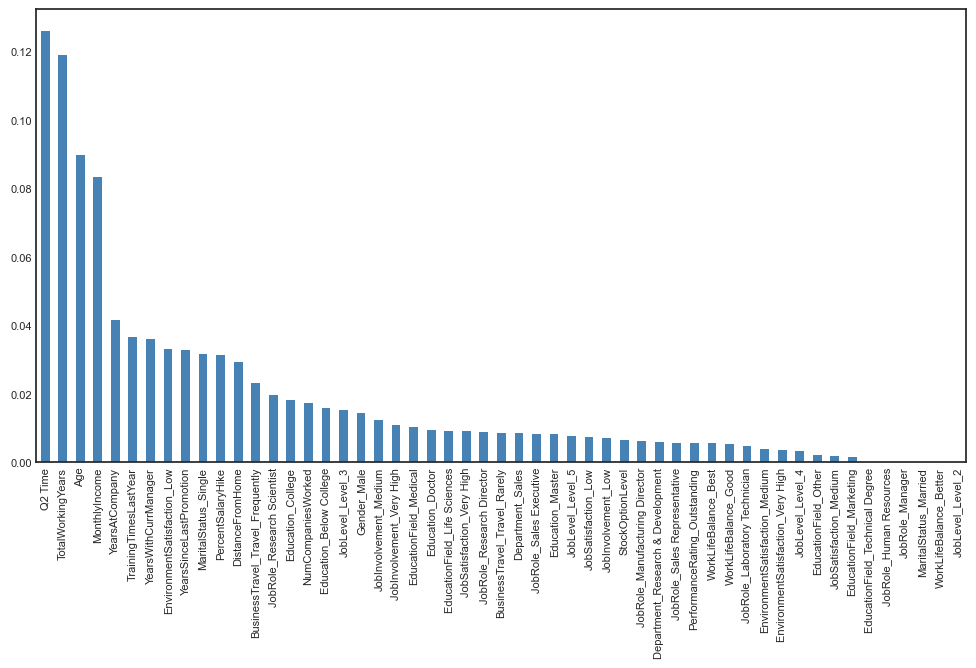

In [550]:

clf = DecisionTreeClassifier()
clf.fit(X_train, y_train)

feat_imp = pd.Series(clf.feature_importances_, index=X_train.columns).sort_values(ascending=False)

feat_imp.plot.bar(color='steelblue', figsize=(12, 6))

<AxesSubplot:>

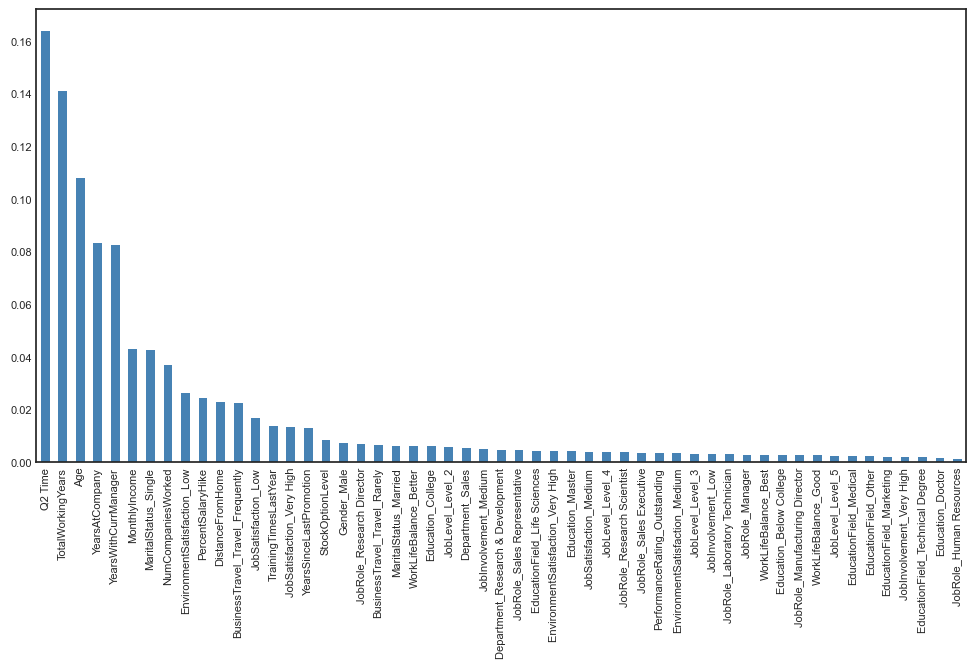

In [551]:

rand_clf = RandomForestClassifier(n_estimators = 100, max_depth=5)
rand_clf.fit(X_train, y_train)

rand_feat_imp = pd.Series(rand_clf.feature_importances_, index=X_train.columns).sort_values(ascending=False)

rand_feat_imp.plot.bar(color='steelblue', figsize=(12, 6))

### Final Feature selection for our model

In [552]:
rfe = RFE(logreg, 20)
rfe.fit(X_train, y_train)

RFE(estimator=LogisticRegression(), n_features_to_select=20)

In [553]:
rfe.support_

array([False, False, False, False, False, False,  True, False,  True,
       False,  True,  True,  True,  True,  True,  True, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False,  True, False,  True, False, False,  True,  True,
        True, False, False,  True,  True, False, False,  True, False,
        True,  True,  True,  True, False, False, False, False])

In [554]:
final_cols = list(X_train.columns[rfe.support_])
print(final_cols)

['TotalWorkingYears', 'YearsAtCompany', 'YearsWithCurrManager', 'Q2 Time', 'BusinessTravel_Travel_Frequently', 'BusinessTravel_Travel_Rarely', 'Department_Research & Development', 'Department_Sales', 'JobLevel_Level_5', 'JobRole_Laboratory Technician', 'JobRole_Research Director', 'JobRole_Research Scientist', 'JobRole_Sales Executive', 'MaritalStatus_Single', 'EnvironmentSatisfaction_Low', 'JobSatisfaction_Low', 'JobSatisfaction_Very High', 'WorkLifeBalance_Best', 'WorkLifeBalance_Better', 'WorkLifeBalance_Good']


In [555]:
# selecting columns only which are 'True' in rfecv.support_ i.e True columns were selected for creating a model

X_train_col=X_train[final_cols]
X_train_1=sm.add_constant(X_train_col)    # Adding constant
X_train_1.shape

(3087, 21)

### Model 1

In [556]:
# creating 1st model after RFE

lr1=sm.GLM(y_train,X_train_1,family=sm.families.Binomial())
reg1=lr1.fit()
reg1.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:              Attrition   No. Observations:                 3087
Model:                            GLM   Df Residuals:                     3066
Model Family:                Binomial   Df Model:                           20
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -1074.2
Date:                Sat, 17 Jul 2021   Deviance:                       2148.4
Time:                        17:07:10   Pearson chi2:                 3.74e+03
No. Iterations:                     6                                         
Covariance Type:            nonrobust                                         
=====================================================================================================
                                        coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------
const                                -1.5875      0.382     -4.159      0.000      -2.336      -0.839
TotalWorkingYears                    -0.7237      0.106     -6.833      0.000      -0.931      -0.516
YearsAtCompany                        0.4559      0.117      3.912      0.000       0.227       0.684
YearsWithCurrManager                 -0.9000      0.145     -6.194      0.000      -1.185      -0.615
Q2 Time                               0.7911      0.068     11.683      0.000       0.658       0.924
BusinessTravel_Travel_Frequently      1.5198      0.259      5.859      0.000       1.011       2.028
BusinessTravel_Travel_Rarely          0.8342      0.244      3.414      0.001       0.355       1.313
Department_Research & Development    -1.0759      0.220     -4.883      0.000      -1.508      -0.644
Department_Sales                     -1.2097      0.234     -5.178      0.000      -1.668      -0.752
JobLevel_Level_5                     -1.0077      0.315     -3.202      0.001      -1.625      -0.391
JobRole_Laboratory Technician         0.4666      0.163      2.859      0.004       0.147       0.787
JobRole_Research Director             0.8200      0.235      3.492      0.000       0.360       1.280
JobRole_Research Scientist            0.4659      0.158      2.953      0.003       0.157       0.775
JobRole_Sales Executive               0.5356      0.154      3.484      0.000       0.234       0.837
MaritalStatus_Single                  0.9996      0.114      8.804      0.000       0.777       1.222
EnvironmentSatisfaction_Low           1.0326      0.130      7.940      0.000       0.778       1.287
JobSatisfaction_Low                   0.6977      0.137      5.085      0.000       0.429       0.967
JobSatisfaction_Very High            -0.4837      0.136     -3.549      0.000      -0.751      -0.217
WorkLifeBalance_Best                 -1.1718      0.256     -4.582      0.000      -1.673      -0.671
WorkLifeBalance_Better               -1.3339      0.205     -6.492      0.000      -1.737      -0.931
WorkLifeBalance_Good                 -1.0898      0.221     -4.937      0.000      -1.522      -0.657
=====================================================================================================
"""

### Calculating VIF

In [557]:
vif = pd.DataFrame()
X= X_train_col
vif['Features'] = X.columns
vif['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif 

,Features,VIF
6,Department_Research & Development,8.93
18,WorkLifeBalance_Better,8.38
5,BusinessTravel_Travel_Rarely,6.61
7,Department_Sales,4.88
19,WorkLifeBalance_Good,3.85
1,YearsAtCompany,3.62
2,YearsWithCurrManager,2.78
4,BusinessTravel_Travel_Frequently,2.58
17,WorkLifeBalance_Best,2.24
0,TotalWorkingYears,1.73


In [558]:
#COLUMN Department_Research & Development HAS A VERY HIGH VIF SO WE NEED TO DROP IT
X_train_2=X_train_col.drop(['Department_Research & Development'],axis=1)

### Model 2

In [559]:
# creating 2nd model after RFE

lr2=sm.GLM(y_train,sm.add_constant(X_train_2),family=sm.families.Binomial())
reg2=lr2.fit()
reg2.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:              Attrition   No. Observations:                 3087
Model:                            GLM   Df Residuals:                     3067
Model Family:                Binomial   Df Model:                           19
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -1085.2
Date:                Sat, 17 Jul 2021   Deviance:                       2170.5
Time:                        17:07:10   Pearson chi2:                 3.72e+03
No. Iterations:                     6                                         
Covariance Type:            nonrobust                                         
====================================================================================================
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const                               -2.6343      0.319     -8.265      0.000      -3.259      -2.010
TotalWorkingYears                   -0.7240      0.105     -6.863      0.000      -0.931      -0.517
YearsAtCompany                       0.4512      0.115      3.912      0.000       0.225       0.677
YearsWithCurrManager                -0.9126      0.144     -6.329      0.000      -1.195      -0.630
Q2 Time                              0.7824      0.067     11.629      0.000       0.651       0.914
BusinessTravel_Travel_Frequently     1.5349      0.258      5.941      0.000       1.029       2.041
BusinessTravel_Travel_Rarely         0.8788      0.243      3.615      0.000       0.402       1.355
Department_Sales                    -0.2249      0.122     -1.839      0.066      -0.465       0.015
JobLevel_Level_5                    -0.9005      0.306     -2.942      0.003      -1.501      -0.301
JobRole_Laboratory Technician        0.4824      0.163      2.966      0.003       0.164       0.801
JobRole_Research Director            0.7727      0.233      3.322      0.001       0.317       1.229
JobRole_Research Scientist           0.4654      0.158      2.954      0.003       0.157       0.774
JobRole_Sales Executive              0.5657      0.152      3.722      0.000       0.268       0.864
MaritalStatus_Single                 0.9817      0.113      8.704      0.000       0.761       1.203
EnvironmentSatisfaction_Low          1.0170      0.129      7.869      0.000       0.764       1.270
JobSatisfaction_Low                  0.6993      0.136      5.142      0.000       0.433       0.966
JobSatisfaction_Very High           -0.4823      0.136     -3.550      0.000      -0.749      -0.216
WorkLifeBalance_Best                -1.1381      0.256     -4.447      0.000      -1.640      -0.636
WorkLifeBalance_Better              -1.2924      0.206     -6.285      0.000      -1.695      -0.889
WorkLifeBalance_Good                -1.0629      0.221     -4.808      0.000      -1.496      -0.630
====================================================================================================
"""

In [560]:
vif = pd.DataFrame()
X= X_train_2
vif['Features'] = X.columns
vif['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif 

,Features,VIF
5,BusinessTravel_Travel_Rarely,5.85
17,WorkLifeBalance_Better,5.64
1,YearsAtCompany,3.62
18,WorkLifeBalance_Good,2.80
2,YearsWithCurrManager,2.78
4,BusinessTravel_Travel_Frequently,2.38
16,WorkLifeBalance_Best,1.78
0,TotalWorkingYears,1.73
15,JobSatisfaction_Very High,1.62
11,JobRole_Sales Executive,1.60


In [561]:
#COLUMN BusinessTravel_Travel_Rarely a Phone Conversation HAS A VERY HIGH VIF SO WE NEED TO DROP IT
X_train_3=X_train_2.drop(['BusinessTravel_Travel_Rarely'],axis=1)

### Model 3

In [562]:
# creating 3rd model after RFE

lr3=sm.GLM(y_train,sm.add_constant(X_train_3),family=sm.families.Binomial())
reg3=lr3.fit()
reg3.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:              Attrition   No. Observations:                 3087
Model:                            GLM   Df Residuals:                     3068
Model Family:                Binomial   Df Model:                           18
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -1093.0
Date:                Sat, 17 Jul 2021   Deviance:                       2186.0
Time:                        17:07:11   Pearson chi2:                 3.91e+03
No. Iterations:                     6                                         
Covariance Type:            nonrobust                                         
====================================================================================================
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const                               -1.8456      0.225     -8.192      0.000      -2.287      -1.404
TotalWorkingYears                   -0.7068      0.105     -6.736      0.000      -0.913      -0.501
YearsAtCompany                       0.4260      0.113      3.754      0.000       0.204       0.648
YearsWithCurrManager                -0.9071      0.142     -6.396      0.000      -1.185      -0.629
Q2 Time                              0.7840      0.067     11.703      0.000       0.653       0.915
BusinessTravel_Travel_Frequently     0.7435      0.127      5.844      0.000       0.494       0.993
Department_Sales                    -0.2145      0.122     -1.760      0.078      -0.454       0.024
JobLevel_Level_5                    -0.8650      0.305     -2.841      0.005      -1.462      -0.268
JobRole_Laboratory Technician        0.5048      0.162      3.115      0.002       0.187       0.822
JobRole_Research Director            0.7785      0.232      3.362      0.001       0.325       1.232
JobRole_Research Scientist           0.4777      0.157      3.038      0.002       0.170       0.786
JobRole_Sales Executive              0.5635      0.152      3.717      0.000       0.266       0.861
MaritalStatus_Single                 0.9775      0.112      8.699      0.000       0.757       1.198
EnvironmentSatisfaction_Low          1.0022      0.128      7.801      0.000       0.750       1.254
JobSatisfaction_Low                  0.7256      0.136      5.351      0.000       0.460       0.991
JobSatisfaction_Very High           -0.4703      0.135     -3.474      0.001      -0.736      -0.205
WorkLifeBalance_Best                -1.1544      0.255     -4.520      0.000      -1.655      -0.654
WorkLifeBalance_Better              -1.2978      0.205     -6.345      0.000      -1.699      -0.897
WorkLifeBalance_Good                -1.0718      0.220     -4.873      0.000      -1.503      -0.641
====================================================================================================
"""

In [563]:
vif = pd.DataFrame()
X= X_train_3
vif['Features'] = X.columns
vif['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
1,YearsAtCompany,3.62
16,WorkLifeBalance_Better,3.16
2,YearsWithCurrManager,2.78
17,WorkLifeBalance_Good,1.86
0,TotalWorkingYears,1.73
10,JobRole_Sales Executive,1.59
14,JobSatisfaction_Very High,1.59
9,JobRole_Research Scientist,1.52
11,MaritalStatus_Single,1.49
7,JobRole_Laboratory Technician,1.45


In [564]:
#COLUMN YearsAtCompany HAS A VERY HIGH P-VALUE SO WE NEED TO DROP IT
X_train_4=X_train_3.drop(['YearsAtCompany'],axis=1)

### Model 4

In [565]:
# creating 4th model after RFE

lr4=sm.GLM(y_train,sm.add_constant(X_train_4),family=sm.families.Binomial())
reg4=lr4.fit()
reg4.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:              Attrition   No. Observations:                 3087
Model:                            GLM   Df Residuals:                     3069
Model Family:                Binomial   Df Model:                           17
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -1099.5
Date:                Sat, 17 Jul 2021   Deviance:                       2199.1
Time:                        17:07:11   Pearson chi2:                 4.98e+03
No. Iterations:                     6                                         
Covariance Type:            nonrobust                                         
====================================================================================================
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const                               -1.7878      0.224     -7.985      0.000      -2.227      -1.349
TotalWorkingYears                   -0.5325      0.088     -6.035      0.000      -0.705      -0.360
YearsWithCurrManager                -0.5354      0.102     -5.232      0.000      -0.736      -0.335
Q2 Time                              0.7765      0.067     11.641      0.000       0.646       0.907
BusinessTravel_Travel_Frequently     0.7462      0.127      5.878      0.000       0.497       0.995
Department_Sales                    -0.2111      0.122     -1.737      0.082      -0.449       0.027
JobLevel_Level_5                    -0.8388      0.299     -2.804      0.005      -1.425      -0.253
JobRole_Laboratory Technician        0.4898      0.161      3.034      0.002       0.173       0.806
JobRole_Research Director            0.7880      0.231      3.406      0.001       0.335       1.241
JobRole_Research Scientist           0.4394      0.156      2.812      0.005       0.133       0.746
JobRole_Sales Executive              0.5361      0.151      3.552      0.000       0.240       0.832
MaritalStatus_Single                 0.9539      0.112      8.535      0.000       0.735       1.173
EnvironmentSatisfaction_Low          0.9640      0.127      7.561      0.000       0.714       1.214
JobSatisfaction_Low                  0.6788      0.134      5.047      0.000       0.415       0.942
JobSatisfaction_Very High           -0.4717      0.135     -3.497      0.000      -0.736      -0.207
WorkLifeBalance_Best                -1.1011      0.254     -4.333      0.000      -1.599      -0.603
WorkLifeBalance_Better              -1.2588      0.204     -6.185      0.000      -1.658      -0.860
WorkLifeBalance_Good                -1.0456      0.219     -4.769      0.000      -1.475      -0.616
====================================================================================================
"""

In [566]:
vif = pd.DataFrame()
X= X_train_4
vif['Features'] = X.columns
vif['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif 

,Features,VIF
15,WorkLifeBalance_Better,3.12
16,WorkLifeBalance_Good,1.85
9,JobRole_Sales Executive,1.59
13,JobSatisfaction_Very High,1.59
8,JobRole_Research Scientist,1.51
10,MaritalStatus_Single,1.49
6,JobRole_Laboratory Technician,1.45
4,Department_Sales,1.44
1,YearsWithCurrManager,1.42
14,WorkLifeBalance_Best,1.37


In [567]:
#COLUMN WorkLifeBalance_Better HAS A VERY HIGH P-VALUE SO WE NEED TO DROP IT
X_train_5=X_train_4.drop(['WorkLifeBalance_Better'],axis=1)

In [568]:
# creating 5th model after RFE

lr5=sm.GLM(y_train,sm.add_constant(X_train_5),family=sm.families.Binomial())
reg5=lr5.fit()
reg5.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:              Attrition   No. Observations:                 3087
Model:                            GLM   Df Residuals:                     3070
Model Family:                Binomial   Df Model:                           16
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -1117.2
Date:                Sat, 17 Jul 2021   Deviance:                       2234.3
Time:                        17:07:11   Pearson chi2:                 4.71e+03
No. Iterations:                     6                                         
Covariance Type:            nonrobust                                         
====================================================================================================
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const                               -2.8881      0.148    -19.546      0.000      -3.178      -2.598
TotalWorkingYears                   -0.5122      0.087     -5.919      0.000      -0.682      -0.343
YearsWithCurrManager                -0.5481      0.101     -5.418      0.000      -0.746      -0.350
Q2 Time                              0.7741      0.066     11.687      0.000       0.644       0.904
BusinessTravel_Travel_Frequently     0.7041      0.126      5.602      0.000       0.458       0.950
Department_Sales                    -0.2284      0.121     -1.894      0.058      -0.465       0.008
JobLevel_Level_5                    -0.7953      0.292     -2.722      0.006      -1.368      -0.223
JobRole_Laboratory Technician        0.5030      0.160      3.143      0.002       0.189       0.817
JobRole_Research Director            0.7461      0.227      3.281      0.001       0.300       1.192
JobRole_Research Scientist           0.4424      0.155      2.855      0.004       0.139       0.746
JobRole_Sales Executive              0.5027      0.150      3.355      0.001       0.209       0.796
MaritalStatus_Single                 0.9340      0.111      8.443      0.000       0.717       1.151
EnvironmentSatisfaction_Low          0.9717      0.126      7.704      0.000       0.724       1.219
JobSatisfaction_Low                  0.6787      0.133      5.084      0.000       0.417       0.940
JobSatisfaction_Very High           -0.4326      0.133     -3.251      0.001      -0.693      -0.172
WorkLifeBalance_Best                 0.0267      0.180      0.148      0.882      -0.326       0.380
WorkLifeBalance_Good                 0.0734      0.130      0.565      0.572      -0.181       0.328
====================================================================================================
"""

In [569]:
vif = pd.DataFrame()
X= X_train_5
vif['Features'] = X.columns
vif['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif 

,Features,VIF
13,JobSatisfaction_Very High,1.45
1,YearsWithCurrManager,1.41
10,MaritalStatus_Single,1.40
4,Department_Sales,1.36
9,JobRole_Sales Executive,1.35
8,JobRole_Research Scientist,1.34
0,TotalWorkingYears,1.32
15,WorkLifeBalance_Good,1.28
6,JobRole_Laboratory Technician,1.27
12,JobSatisfaction_Low,1.25


In [570]:
#COLUMN WorkLifeBalance_Best HAS A VERY HIGH P-VALUE SO WE NEED TO DROP IT
X_train_6=X_train_5.drop(['WorkLifeBalance_Best'],axis=1)

### Model 6

In [571]:
# creating 6th model after RFE

lr6=sm.GLM(y_train,sm.add_constant(X_train_6),family=sm.families.Binomial())
reg6=lr6.fit()
reg6.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:              Attrition   No. Observations:                 3087
Model:                            GLM   Df Residuals:                     3071
Model Family:                Binomial   Df Model:                           15
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -1117.2
Date:                Sat, 17 Jul 2021   Deviance:                       2234.3
Time:                        17:07:12   Pearson chi2:                 4.71e+03
No. Iterations:                     6                                         
Covariance Type:            nonrobust                                         
====================================================================================================
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const                               -2.8849      0.146    -19.740      0.000      -3.171      -2.598
TotalWorkingYears                   -0.5122      0.087     -5.920      0.000      -0.682      -0.343
YearsWithCurrManager                -0.5485      0.101     -5.424      0.000      -0.747      -0.350
Q2 Time                              0.7741      0.066     11.686      0.000       0.644       0.904
BusinessTravel_Travel_Frequently     0.7043      0.126      5.604      0.000       0.458       0.951
Department_Sales                    -0.2289      0.121     -1.899      0.058      -0.465       0.007
JobLevel_Level_5                    -0.7964      0.292     -2.726      0.006      -1.369      -0.224
JobRole_Laboratory Technician        0.5024      0.160      3.140      0.002       0.189       0.816
JobRole_Research Director            0.7463      0.227      3.282      0.001       0.301       1.192
JobRole_Research Scientist           0.4423      0.155      2.854      0.004       0.139       0.746
JobRole_Sales Executive              0.5042      0.149      3.373      0.001       0.211       0.797
MaritalStatus_Single                 0.9340      0.111      8.443      0.000       0.717       1.151
EnvironmentSatisfaction_Low          0.9723      0.126      7.712      0.000       0.725       1.219
JobSatisfaction_Low                  0.6790      0.133      5.087      0.000       0.417       0.941
JobSatisfaction_Very High           -0.4322      0.133     -3.249      0.001      -0.693      -0.172
WorkLifeBalance_Good                 0.0697      0.127      0.547      0.584      -0.180       0.319
====================================================================================================
"""

In [572]:
#COLUMN WorkLifeBalance_Good HAS A VERY HIGH P-VALUE SO WE NEED TO DROP IT
X_train_7=X_train_6.drop(['WorkLifeBalance_Good'],axis=1)

### Model 7

In [573]:
# creating 7th model after RFE

lr7=sm.GLM(y_train,sm.add_constant(X_train_7),family=sm.families.Binomial())
reg7=lr7.fit()
reg7.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:              Attrition   No. Observations:                 3087
Model:                            GLM   Df Residuals:                     3072
Model Family:                Binomial   Df Model:                           14
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -1117.3
Date:                Sat, 17 Jul 2021   Deviance:                       2234.6
Time:                        17:07:12   Pearson chi2:                 4.69e+03
No. Iterations:                     6                                         
Covariance Type:            nonrobust                                         
====================================================================================================
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const                               -2.8677      0.143    -20.122      0.000      -3.147      -2.588
TotalWorkingYears                   -0.5103      0.086     -5.903      0.000      -0.680      -0.341
YearsWithCurrManager                -0.5500      0.101     -5.441      0.000      -0.748      -0.352
Q2 Time                              0.7750      0.066     11.701      0.000       0.645       0.905
BusinessTravel_Travel_Frequently     0.7047      0.126      5.606      0.000       0.458       0.951
Department_Sales                    -0.2312      0.120     -1.920      0.055      -0.467       0.005
JobLevel_Level_5                    -0.7906      0.292     -2.709      0.007      -1.363      -0.219
JobRole_Laboratory Technician        0.5024      0.160      3.141      0.002       0.189       0.816
JobRole_Research Director            0.7454      0.228      3.276      0.001       0.299       1.191
JobRole_Research Scientist           0.4457      0.155      2.878      0.004       0.142       0.749
JobRole_Sales Executive              0.5044      0.149      3.375      0.001       0.211       0.797
MaritalStatus_Single                 0.9306      0.110      8.427      0.000       0.714       1.147
EnvironmentSatisfaction_Low          0.9706      0.126      7.699      0.000       0.724       1.218
JobSatisfaction_Low                  0.6785      0.134      5.082      0.000       0.417       0.940
JobSatisfaction_Very High           -0.4290      0.133     -3.230      0.001      -0.689      -0.169
====================================================================================================
"""

In [574]:
#COLUMN Department_Sales HAS A VERY HIGH P-VALUE SO WE NEED TO DROP IT
X_train_8=X_train_7.drop(['Department_Sales'],axis=1)

### Model 8

In [575]:
# creating 8th model after RFE

lr8=sm.GLM(y_train,sm.add_constant(X_train_8),family=sm.families.Binomial())
reg8=lr8.fit()
reg8.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:              Attrition   No. Observations:                 3087
Model:                            GLM   Df Residuals:                     3073
Model Family:                Binomial   Df Model:                           13
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -1119.2
Date:                Sat, 17 Jul 2021   Deviance:                       2238.4
Time:                        17:07:12   Pearson chi2:                 4.64e+03
No. Iterations:                     6                                         
Covariance Type:            nonrobust                                         
====================================================================================================
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const                               -2.9241      0.140    -20.895      0.000      -3.198      -2.650
TotalWorkingYears                   -0.5043      0.086     -5.848      0.000      -0.673      -0.335
YearsWithCurrManager                -0.5520      0.101     -5.469      0.000      -0.750      -0.354
Q2 Time                              0.7771      0.066     11.741      0.000       0.647       0.907
BusinessTravel_Travel_Frequently     0.6794      0.125      5.441      0.000       0.435       0.924
JobLevel_Level_5                    -0.7900      0.291     -2.715      0.007      -1.360      -0.220
JobRole_Laboratory Technician        0.4856      0.160      3.042      0.002       0.173       0.798
JobRole_Research Director            0.7368      0.227      3.249      0.001       0.292       1.181
JobRole_Research Scientist           0.4309      0.155      2.786      0.005       0.128       0.734
JobRole_Sales Executive              0.5053      0.149      3.385      0.001       0.213       0.798
MaritalStatus_Single                 0.9303      0.110      8.431      0.000       0.714       1.147
EnvironmentSatisfaction_Low          0.9752      0.126      7.746      0.000       0.728       1.222
JobSatisfaction_Low                  0.6754      0.133      5.061      0.000       0.414       0.937
JobSatisfaction_Very High           -0.4286      0.133     -3.230      0.001      -0.689      -0.169
====================================================================================================
"""

In [576]:
vif = pd.DataFrame()
X= X_train_8
vif['Features'] = X.columns
vif['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif 

,Features,VIF
1,YearsWithCurrManager,1.40
12,JobSatisfaction_Very High,1.40
9,MaritalStatus_Single,1.38
0,TotalWorkingYears,1.32
7,JobRole_Research Scientist,1.27
8,JobRole_Sales Executive,1.26
11,JobSatisfaction_Low,1.23
5,JobRole_Laboratory Technician,1.21
3,BusinessTravel_Travel_Frequently,1.20
10,EnvironmentSatisfaction_Low,1.18


## Step 7: Model Performance on train data

In [577]:
# Predicting the train dataset with our final model
y_train_pred=reg8.predict(sm.add_constant(X_train_8))
# Creating a new dataset and saving predicted values in it
y_train_pred_final=pd.DataFrame({'Attrition':y_train.values,'Attrition_prob':y_train_pred,'ID':y_train.index})
y_train_pred_final.head()   # viewing first 5 rows


,Attrition,Attrition_prob,ID
3818,1,0.232937,3818
1575,1,0.370684,1575
1167,0,0.086559,1167
518,1,0.526372,518
2315,0,0.042625,2315


### Plotting ROC and calculating AUCROC

An ROC curve demonstrates several things:

- It shows the tradeoff between sensitivity and specificity (any increase in sensitivity will be accompanied by a decrease in specificity).
- The closer the curve follows the left-hand border and then the top border of the ROC space, the more accurate the test.
- The closer the curve comes to the 45-degree diagonal of the ROC space, the less accurate the test.

In [578]:
def draw_roc( actual, probs ):
    fpr, tpr, thresholds = metrics.roc_curve( actual, probs,
                                              drop_intermediate = False )
    auc_score = metrics.roc_auc_score( actual, probs )
    plt.figure(figsize=(5, 5))
    plt.plot( fpr, tpr, label='ROC curve (area = %0.2f)' % auc_score )
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate or [1 - True Negative Rate]')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver operating characteristic example')
    plt.legend(loc="lower right")
    plt.grid()
    plt.show()

    return None

In [579]:
fpr, tpr, thresholds = metrics.roc_curve( y_train_pred_final.Attrition, y_train_pred_final.Attrition_prob, drop_intermediate = False )

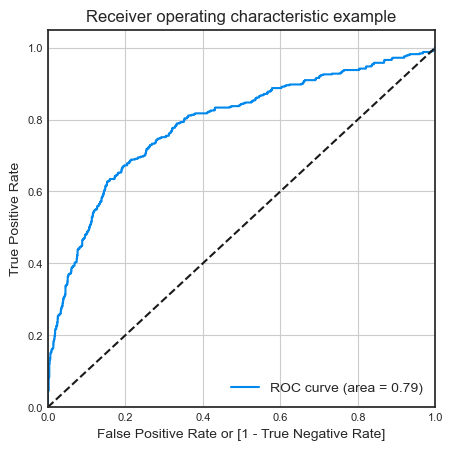

In [580]:
draw_roc(y_train_pred_final.Attrition, y_train_pred_final.Attrition_prob)

Points to be concluded from above roc curve -
- The curve is closer to the left side of the border than to the right side hence our model is having great accuracy.
- The area under the curve is 79% of the total area.

### Finding optimal probability cutoff point

In [581]:
# creating 10 points out of which one we will choose for our cutoff point

numbers=[float(5*x)/100 for x in range(20)]  # from 0 to 0.95 with set size 0.05

for i in numbers:
    y_train_pred_final[i]=y_train_pred_final['Attrition_prob'].map(lambda x:1 if x > i else 0)   #  Mapping the probablities for each 10 points
y_train_pred_final.head()   # Viewing the first 5 rows

,Attrition,Attrition_prob,ID,0.0,0.05,0.1,0.15,0.2,0.25,0.3,0.35,0.4,0.45,0.5,0.55,0.6,0.65,0.7,0.75,0.8,0.85,0.9,0.95
3818,1,0.232937,3818,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1575,1,0.370684,1575,1,1,1,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0
1167,0,0.086559,1167,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
518,1,0.526372,518,1,1,1,1,1,1,1,1,1,1,1,0,0,0,0,0,0,0,0,0
2315,0,0.042625,2315,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


Now, after creating series of points let's check the possibilities of choosing any one points from 0 to 0.95. We will do this by finding **'Accuracy'**, **'Sensitivity'** and **'Specificity'** for each points. These three methods will tell us how our model is - whether it is having low accuray or high or number of relevance data points is high or low etc.

In [582]:
# Caculating accuracy, sensitivity and specificity with probability cutoffs

# Creating a dataframe to store all the values to be created
df_cutoffs=pd.DataFrame(columns=['cut_off_Probability','Accuracy','Sensitvity','Specificity'])
# from 0 to 0.95 with set size 0.05
var=[float(5*x)/100 for x in range(20)]   
for i in var:
    cm_matrix=confusion_matrix(y_train_pred_final['Attrition'],y_train_pred_final[i])  # creating confusion matrix 
    total=sum(sum(cm_matrix))                                                          # Taking the sum of the matrix
    accuracy=(cm_matrix[0,0]+cm_matrix[1,1])/total                                     # Storing Accuracy Data 
    sensitivity=cm_matrix[1,1]/(cm_matrix[1,0]+cm_matrix[1,1])                         # Storing Sensitivity Data
    specificity=cm_matrix[0,0]/(cm_matrix[0,0]+cm_matrix[0,1])                         # Storing Specificity Data
    df_cutoffs.loc[i]=[i, accuracy, sensitivity, specificity]                          # Inserting all the data into the dataframe created earlier
df_cutoffs   # Printing the data

,cut_off_Probability,Accuracy,Sensitvity,Specificity
0.00,0.00,0.161322,1.000000,0.000000
0.05,0.05,0.389699,0.925703,0.286597
0.10,0.10,0.576288,0.835341,0.526458
0.15,0.15,0.694849,0.767068,0.680958
0.20,0.20,0.768707,0.688755,0.784087
0.25,0.25,0.815031,0.574297,0.861336
0.30,0.30,0.834791,0.469880,0.904983
0.35,0.35,0.847425,0.393574,0.934724
0.40,0.40,0.851960,0.307229,0.956740
0.45,0.45,0.855847,0.255020,0.971418


 As we can see from the above data we have created points for accuracy , sensitivity and specificity for all probability points from 0 to 0.95.
Out of this we have to choose one as a cutoff point and it is **probability cutoff = 0.20** because all the accuracy , sensitivity and specificity are having nearly same value which is an ideal point to consider for as we can't ignore any one from three.

Let's plot this data and see the convergent point or meeting point for all three point 'accuracy' , 'sensitivity' and 'specificity'

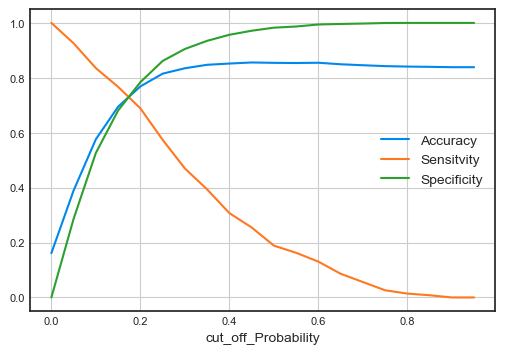

In [583]:
# Ploting 'Accuracy' , 'Sensitivity' and 'Specificity' for various probabilities(0.0 to 0.95).

df_cutoffs.plot.line(x='cut_off_Probability', y=['Accuracy','Sensitvity','Specificity'])   # line plotting
plt.grid()
plt.show()

From the above curve, 0.20 is the optimum point for taking probability cutoff as the meeting point is slightly before from 0.20 hence final cutoff we choose is **0.20**. Also we can see that there is a trade off between sensitivity and specificity.

In [584]:
# Predicting the outcomes with probability cutoff as 0.20 by creating new columns in the final dataset

y_train_pred_final['Predicted']=y_train_pred_final['Attrition_prob'].map(lambda x:1 if x >0.20 else 0 )  # Predicted value 

y_train_pred_final.head()

,Attrition,Attrition_prob,ID,0.0,0.05,0.1,0.15,0.2,0.25,0.3,0.35,0.4,0.45,0.5,0.55,0.6,0.65,0.7,0.75,0.8,0.85,0.9,0.95,Predicted
3818,1,0.232937,3818,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
1575,1,0.370684,1575,1,1,1,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1
1167,0,0.086559,1167,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
518,1,0.526372,518,1,1,1,1,1,1,1,1,1,1,1,0,0,0,0,0,0,0,0,0,1
2315,0,0.042625,2315,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


### Precision & Recall

Let's create precision and recall using confusion matrix for the final dataset ass we know that to attain more stability and predict successfully in our model one needs to check these two important methods which not only will tell us how our model is but also it will show us some insight like what is the score for result relevancy and how many truly relevant results are returned. 

In [585]:
# Creating confusion matrix to find precision and recall score

confusion_pr=confusion_matrix(y_train_pred_final.Attrition,y_train_pred_final.Predicted)
confusion_pr

array([[2030,  559],
       [ 155,  343]], dtype=int64)

In [586]:
print('Precision :',round(confusion_pr[1,1]/(confusion_pr[0,1]+confusion_pr[1,1]),2))   # Printing Pecision score
print('Recall    :',round(confusion_pr[1,1]/(confusion_pr[1,0]+confusion_pr[1,1]),2))       # Printing Recall score

Precision : 0.38
Recall    : 0.69


Important point to be noted from the outcomes for precision and recall score -
- Our precison percentage is 38% approximately and recall  percentage is 69%
- This means we have very good model which explains relevancy of 69% and true relevant results about 38%.


### Precision and Recall trade-off

As we all know that Precision and Recall are inversely related means if one increases other will genuinely decrease. Hence we need to see the trade off between these two.
Let's check that in below graph.

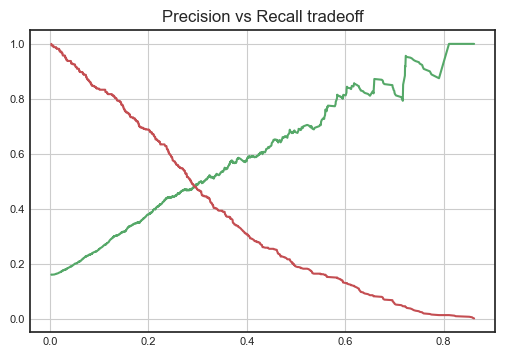

In [587]:
# Creating precision recall curve by creating three points and plotting

p ,r, thresholds=precision_recall_curve(y_train_pred_final.Attrition,y_train_pred_final.Attrition_prob)
plt.title('Precision vs Recall tradeoff')
plt.plot(thresholds, p[:-1], "g-")    # Plotting precision
plt.plot(thresholds, r[:-1], "r-")    # Plotting Recall
plt.grid()
plt.show()

**As we can see that there is a trade off between Precision and Recall and the meeting point is nearly at 0.3**

## Step 8: Model Validation on test data

Now that we have fitted the model it's time to go ahead and make predictions using the final, i.e. Model 8

### Scaling the test dataset

In [588]:
X_test[scale_cols]=scaler.transform(X_test[scale_cols])

In [589]:
# Predicting the test dataset with our final model

test_cols=X_train_8.columns                                   # Taking the same column train set has
X_test_final=X_test[test_cols]                                # Updating it in the final test set
y_pred_test=reg8.predict(sm.add_constant(X_test_final))       # Predicting the final test set

### Model Evaluation

In [590]:
# Creating a new dataset and saving the prediction values in it

y_test_pred_final=pd.DataFrame({'Attrition':y_test.values,'Attrition_prob':y_pred_test,'ID':y_test.index})

y_test_pred_final.head()   # viewing first 5 rows

,Attrition,Attrition_prob,ID
2778,0,0.289612,2778
410,0,0.078698,410
3423,0,0.075758,3423
2170,0,0.050637,2170
4341,0,0.092136,4341


In [591]:
# Predicting the outcomes with probability cutoff as 0.20 by creating new columns in the final test dataset

y_test_pred_final['Predicted']=y_test_pred_final['Attrition_prob'].map(lambda x:1 if x >0.2 else 0 )  # Predicted value 

y_test_pred_final.head()

,Attrition,Attrition_prob,ID,Predicted
2778,0,0.289612,2778,1
410,0,0.078698,410,0
3423,0,0.075758,3423,0
2170,0,0.050637,2170,0
4341,0,0.092136,4341,0


In [592]:
# Checking the accuracy of the test dataset.
from sklearn import metrics    # Imprting metrics from sklearn
print('Accuracy score in test dataset :', round(metrics.accuracy_score(y_test_pred_final.Attrition, y_test_pred_final.Predicted),3))   # Printing the score

Accuracy score in test dataset : 0.764


In [593]:

tn, fp, fn, tp = confusion_matrix(y_test_pred_final.Attrition, y_test_pred_final.Predicted).ravel()
sensitivity = tp / (fn+tp)
specificity = tn / (tn+fp)
print('Sensitivity in test dataset:', round(sensitivity,2))   # Printing the sensitivity
print('Specificity in test dataset:', round(specificity,2))      # Printing specificity

Sensitivity in test dataset: 0.67
Specificity in test dataset: 0.78


In [594]:
mat = confusion_matrix(y_test_pred_final.Attrition, y_test_pred_final.Predicted)

<AxesSubplot:>

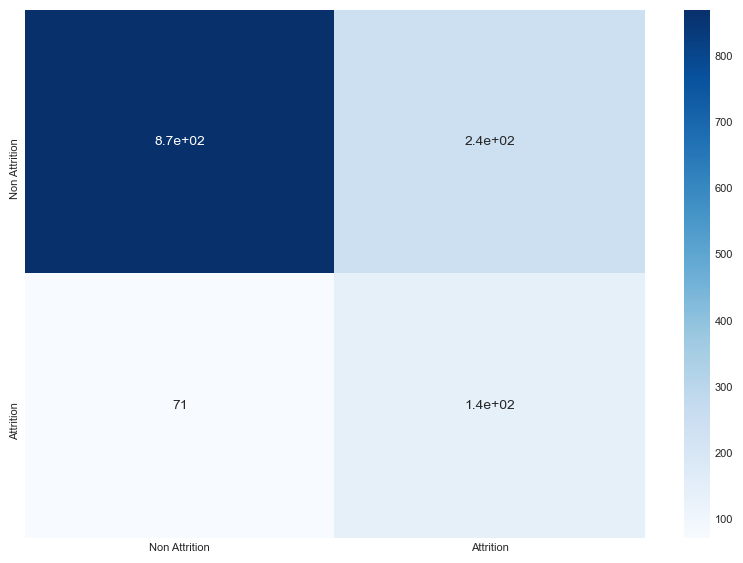

In [595]:
classes = ["Non Attrition", "Attrition"]
df_cm = pd.DataFrame(mat, index = [i for i in classes],
                  columns = [i for i in classes])
plt.figure(figsize = (10,7))
sns.heatmap(df_cm, annot=True,cmap=plt.cm.Blues)

<AxesSubplot:>

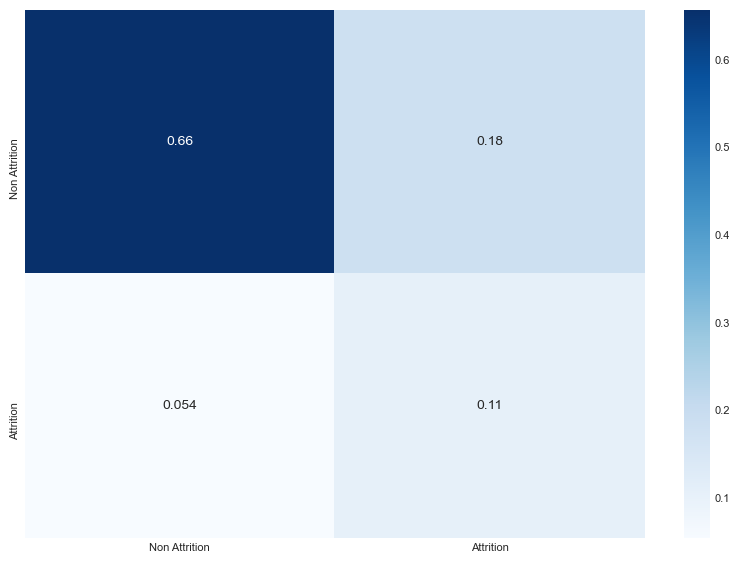

In [596]:
classes = ["Non Attrition", "Attrition"]
df_cm = pd.DataFrame(mat/sum(sum(mat)), index = [i for i in classes],
                  columns = [i for i in classes])
plt.figure(figsize = (10,7))
sns.heatmap(df_cm, annot=True,cmap=plt.cm.Blues)

In [597]:
from sklearn.metrics import precision_score, recall_score     # Importing precision and recall score from sklearn
print('Precision score in test dataset:', round(precision_score(y_test_pred_final.Attrition, y_test_pred_final.Predicted),2))   # Printing the precision score
print('Recall score in test dataset:', round(recall_score(y_test_pred_final.Attrition, y_test_pred_final.Predicted),2) )     # Printing the recall score

Precision score in test dataset: 0.37
Recall score in test dataset: 0.67


# Conclusion

Valuable Insights -
 - The Accuracy, Precision and Recall score we got from test set in aceptable range.
 - This concludes that the model is in stable state.
 - Final eatures from our model which contributes more towards the probability of a attrition are :
    - **TotalWorkingYears**
    - **YearsWithCurrManager**	
    - **Q2 Time**
    - **BusinessTravel_Travel_Frequently**	
    - **JobLevel_Level_5**	
    - **JobRole_Laboratory Technician**
    - **JobRole_Research Director**	
    - **JobRole_Research Scientist**	
    - **JobRole_Sales Executive**	
    - **MaritalStatus_Single**	
    - **EnvironmentSatisfaction_Low**	
    - **JobSatisfaction_Low**	
    - **JobSatisfaction_Very High**


# Alternative Models 

In [598]:
final_df = pd.read_csv("final_dataset_hr.csv")
final_df.head()

,Age,Attrition,BusinessTravel,Department,DistanceFromHome,Education,EducationField,Gender,JobLevel,JobRole,MaritalStatus,MonthlyIncome,NumCompaniesWorked,PercentSalaryHike,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,YearsAtCompany,YearsSinceLastPromotion,YearsWithCurrManager,EnvironmentSatisfaction,JobSatisfaction,WorkLifeBalance,JobInvolvement,PerformanceRating,Q2 Time
0,51,No,Travel_Rarely,Sales,6,College,Life Sciences,Female,Level_1,Healthcare Representative,Married,131160,1.0,11,0,1.0,6,1,0,0,High,Very High,Good,High,Excellent,7.365000
1,31,Yes,Travel_Frequently,Research & Development,10,Below College,Life Sciences,Female,Level_1,Research Scientist,Single,41890,0.0,23,1,6.0,3,5,1,4,High,Medium,Best,Medium,Outstanding,7.703611
2,32,No,Travel_Frequently,Research & Development,17,Master,Other,Male,Level_4,Sales Executive,Married,193280,1.0,15,3,5.0,2,5,0,3,Medium,Medium,Bad,High,Excellent,6.977500
3,38,No,Non-Travel,Research & Development,2,Doctor,Life Sciences,Male,Level_3,Human Resources,Married,83210,3.0,11,3,13.0,5,8,7,5,Very High,Very High,Better,Medium,Excellent,7.157222
4,32,No,Travel_Rarely,Research & Development,10,Below College,Medical,Male,Level_1,Sales Executive,Single,23420,4.0,12,2,9.0,2,6,0,4,Very High,Low,Better,High,Excellent,7.953611


In [599]:
final_df['Attrition'] = final_df['Attrition'].replace({'Yes': 1, "No": 0})
final_df.shape


(4410, 26)

In [600]:
X = final_df.drop(['Attrition'], axis=1)
y = final_df['Attrition']

In [601]:
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.7, test_size=0.3, random_state=100,stratify=y,shuffle=True)

In [602]:

obj_cols = [col for col in X_train.columns if is_object_dtype(X_train[col].dtype)] 
print(obj_cols)

['BusinessTravel', 'Department', 'Education', 'EducationField', 'Gender', 'JobLevel', 'JobRole', 'MaritalStatus', 'EnvironmentSatisfaction', 'JobSatisfaction', 'WorkLifeBalance', 'JobInvolvement', 'PerformanceRating']


### WoE Encoding

In [603]:
#https://heartbeat.fritz.ai/hands-on-with-feature-engineering-techniques-encoding-categorical-variables-be4bc0715394
# get your target variable name.
target = "Attrition"

X_train_with_y = pd.concat([X_train, y_train],axis=1)

# we loop over all the categorical variables
for variable in obj_cols:
  
    # calculating the mean of target for each category. (probability of events or p(1))
    dataframe = pd.DataFrame(X_train_with_y.groupby([variable])[target].mean())
    
    # calculating the non target probability. (probability of non-events or p(0))
    dataframe['non-target'] = 1 - dataframe[target]
    
    # calculating the WOE.
    dataframe['ratio'] = np.log(dataframe[target] / dataframe['non-target'])
    ratio_mapping = dataframe['ratio'].to_dict()
    
    # applying the WOE.
    X_train[variable] = X_train[variable].map(ratio_mapping)
    X_test[variable] = X_test[variable].map(ratio_mapping)
    
X_train.head()

,Age,BusinessTravel,Department,DistanceFromHome,Education,EducationField,Gender,JobLevel,JobRole,MaritalStatus,MonthlyIncome,NumCompaniesWorked,PercentSalaryHike,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,YearsAtCompany,YearsSinceLastPromotion,YearsWithCurrManager,EnvironmentSatisfaction,JobSatisfaction,WorkLifeBalance,JobInvolvement,PerformanceRating,Q2 Time
3818,28,-1.721583,-0.736632,1,-1.683008,-1.619514,-1.754232,-1.471043,-1.596163,-1.889023,24130,1.0,16,1,2.0,2,1,0,0,-1.844206,-1.611586,-1.772582,-1.694880,-1.674735,8.405833
1575,33,-1.721583,-0.736632,28,-1.553535,-0.251314,-1.754232,-2.125251,-1.812379,-1.098612,55610,1.0,21,1,1.0,3,1,0,0,-1.824060,-1.677282,-1.772582,-1.504077,-1.511799,10.497500
1167,33,-1.721583,-1.753881,3,-1.629241,-1.619514,-1.582582,-1.810109,-1.867520,-1.889023,16110,0.0,14,0,10.0,2,9,8,1,-1.746297,-2.013733,-1.772582,-1.633154,-1.674735,9.083333
518,20,-1.121497,-1.753881,8,-1.683008,-1.750937,-1.582582,-1.810109,-1.571762,-1.098612,34640,1.0,20,0,2.0,3,2,0,2,-1.824060,-2.013733,-1.772582,-1.633154,-1.511799,9.103333
2315,48,-1.721583,-1.684274,12,-1.629241,-1.619514,-1.582582,-1.733569,-1.596163,-2.284684,55620,8.0,13,1,18.0,2,8,7,7,-1.844206,-1.677282,-1.772582,-1.694880,-1.674735,7.855000


In [604]:
X_test.head()

,Age,BusinessTravel,Department,DistanceFromHome,Education,EducationField,Gender,JobLevel,JobRole,MaritalStatus,MonthlyIncome,NumCompaniesWorked,PercentSalaryHike,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,YearsAtCompany,YearsSinceLastPromotion,YearsWithCurrManager,EnvironmentSatisfaction,JobSatisfaction,WorkLifeBalance,JobInvolvement,PerformanceRating,Q2 Time
2778,24,-1.721583,-1.753881,6,-1.553535,-1.750937,-1.582582,-1.471043,-1.520404,-1.889023,40870,0.0,20,3,4.0,1,3,0,2,-1.087131,-1.677282,-1.664775,-1.694880,-1.511799,7.761667
410,28,-1.721583,-1.684274,10,-1.683008,-1.600136,-1.754232,-1.810109,-1.812379,-2.284684,135910,5.0,20,1,6.0,2,2,2,2,-1.844206,-1.677282,-1.772582,-1.694880,-1.511799,7.663333
3423,42,-1.721583,-1.684274,23,-1.629241,-2.140066,-1.582582,-1.733569,-1.520404,-1.889023,23730,6.0,14,1,21.0,3,1,0,0,-1.824060,-1.677282,-1.557187,-1.499954,-1.674735,7.987500
2170,34,-1.721583,-1.684274,3,-1.553535,-2.164964,-1.582582,-1.471043,-1.193922,-2.284684,26590,0.0,24,3,10.0,2,9,1,6,-1.824060,-2.013733,-1.664775,-1.694880,-1.511799,7.414167
4341,51,-1.721583,-0.736632,4,-1.553535,-0.251314,-1.582582,-1.471043,-1.987874,-1.098612,25700,3.0,18,0,21.0,2,7,1,0,-1.824060,-1.611586,-1.772582,-1.694880,-1.674735,7.359444


Optimal number of features: 21
Selected features: ['BusinessTravel', 'Department', 'Education', 'EducationField', 'Gender', 'JobRole', 'MaritalStatus', 'NumCompaniesWorked', 'PercentSalaryHike', 'StockOptionLevel', 'TotalWorkingYears', 'TrainingTimesLastYear', 'YearsAtCompany', 'YearsSinceLastPromotion', 'YearsWithCurrManager', 'EnvironmentSatisfaction', 'JobSatisfaction', 'WorkLifeBalance', 'JobInvolvement', 'PerformanceRating', 'Q2 Time']


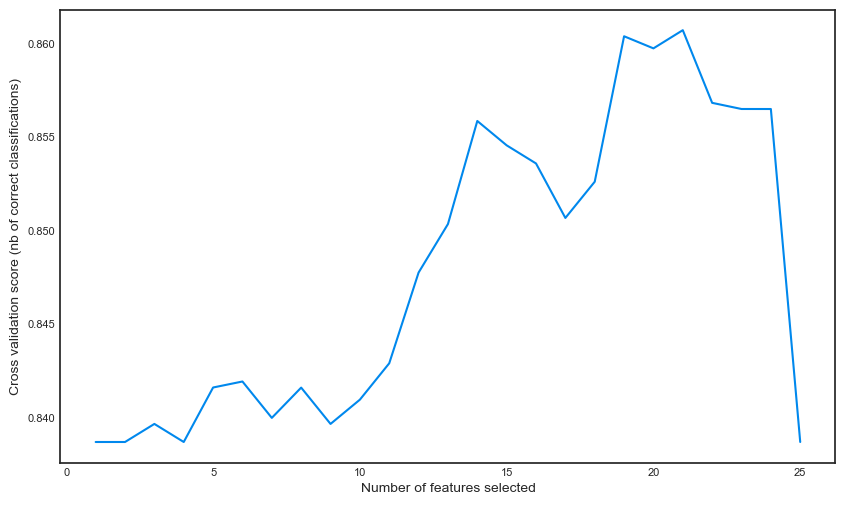

In [605]:

# Create the RFE object and compute a cross-validated score.
# The "accuracy" scoring is proportional to the number of correct classifications
rfecv = RFECV(estimator=LogisticRegression(), step=1, cv=10, scoring='accuracy')
rfecv.fit(X_train, y_train)

print("Optimal number of features: %d" % rfecv.n_features_)
print('Selected features: %s' % list(X_train.columns[rfecv.support_]))

# Plot number of features VS. cross-validation scores
plt.figure(figsize=(10,6))
plt.xlabel("Number of features selected")
plt.ylabel("Cross validation score (nb of correct classifications)")
plt.plot(range(1, len(rfecv.grid_scores_) + 1), rfecv.grid_scores_)
plt.show()

In [606]:
cols_to_keep = list(X_train.columns[rfecv.support_])

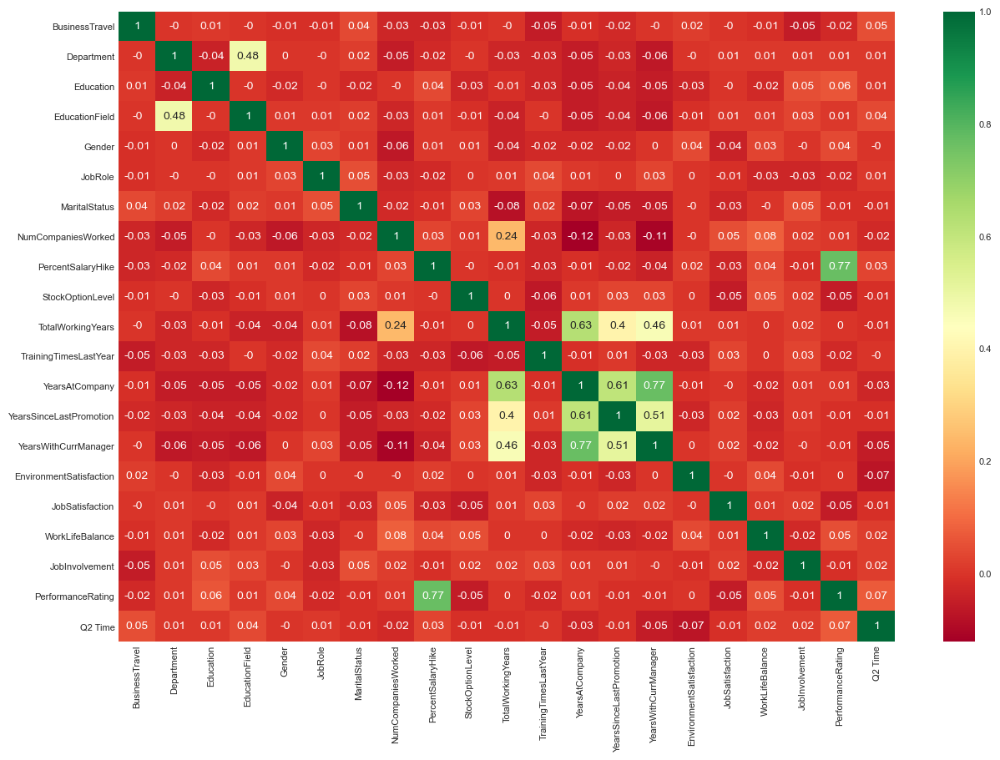

In [607]:
plt.subplots(figsize=(15, 10))
sns.heatmap(round(X_train[cols_to_keep].corr(),2), annot=True, cmap="RdYlGn")
plt.show()

In [608]:

# # Create correlation matrix
# corr_matrix = X_train[cols_to_keep].corr().abs()

# # Select upper triangle of correlation matrix
# upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))

# # Find features with correlation greater than 0.95
# to_drop = [column for column in upper.columns if any(upper[column] > 0.95)]

X_train = X_train[cols_to_keep]



In [609]:
from statsmodels.stats.outliers_influence import variance_inflation_factor    

def calculate_vif_(X, thresh=5.0):
    variables = list(range(X.shape[1]))
    dropped = True
    while dropped:
        dropped = False
        vif = [variance_inflation_factor(X.iloc[:, variables].values, ix)
               for ix in range(X.iloc[:, variables].shape[1])]

        maxloc = vif.index(max(vif))
        if max(vif) > thresh:
            print('dropping \'' + X.iloc[:, variables].columns[maxloc] +
                  '\' at index: ' + str(maxloc))
            del variables[maxloc]
            dropped = True

    print('Remaining variables:')
    print(X.columns[variables])
    return X.iloc[:, variables]


# _ = calculate_vif_(X_train,4)

In [610]:


param_grid = {'C': [0.001, 0.01, 0.1, 1, 10, 100, 1000],
             'penalty' : ['l1', 'l2', 'elasticnet'],
              'fit_intercept':[True,False],
              'class_weight':[None,'balanced'],
             'solver' : ['liblinear']}
scoring = {'Accuracy': 'accuracy', 'AUC': 'roc_auc', 'Log_loss': 'neg_log_loss'}

gs = GridSearchCV(LogisticRegression(), return_train_score=True,verbose=1,n_jobs=-1,
                  param_grid=param_grid, scoring=scoring, cv=5, refit='Accuracy')

gs.fit(X_train, y_train)
results = gs.cv_results_


print("best params: " + str(gs.best_estimator_))
print("best params: " + str(gs.best_params_))
print('best score:', gs.best_score_)





Fitting 5 folds for each of 84 candidates, totalling 420 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:   16.5s
[Parallel(n_jobs=-1)]: Done 274 tasks      | elapsed:   40.8s
[Parallel(n_jobs=-1)]: Done 420 out of 420 | elapsed:  1.4min finished


best params: LogisticRegression(C=1, penalty='l1', solver='liblinear')
best params: {'C': 1, 'class_weight': None, 'fit_intercept': True, 'penalty': 'l1', 'solver': 'liblinear'}
best score: 0.8597320786979488


In [611]:
lr = LogisticRegression(C=1000, penalty='l1', fit_intercept=True, solver='liblinear')
lr.fit(X_train,y_train)
lr.coef_

array([[ 1.14109654,  0.69201699,  0.91247413,  0.63444478,  0.8312632 ,
         1.22987051,  1.10600095,  0.11541506,  0.03100027, -0.07410821,
        -0.10980657, -0.14209963,  0.0628585 ,  0.13778996, -0.1873427 ,
         1.49037755,  1.45934287,  1.22648276,  1.27561354, -1.46553202,
         0.46615001]])

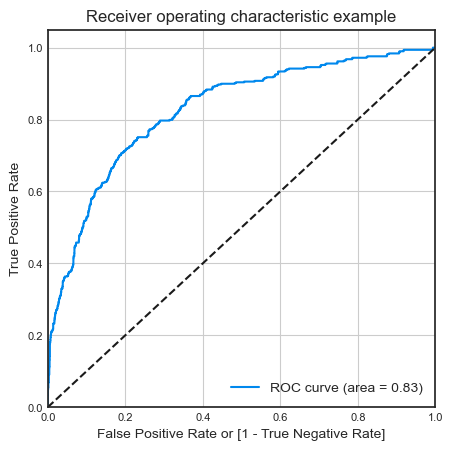

In [612]:
# Predicting the train dataset with our final model
y_train_pred=lr.predict_proba(X_train)[:,1]
# Creating a new dataset and saving predicted values in it
y_train_pred_final=pd.DataFrame({'Attrition':y_train.values,'Attrition_prob':y_train_pred,'ID':y_train.index})
y_train_pred_final.head()   # viewing first 5 rows


fpr, tpr, thresholds = metrics.roc_curve( y_train_pred_final.Attrition, y_train_pred_final.Attrition_prob, drop_intermediate = False )

draw_roc(y_train_pred_final.Attrition, y_train_pred_final.Attrition_prob)

In [613]:
# creating 10 points out of which one we will choose for our cutoff point

numbers=[float(5*x)/100 for x in range(20)]  # from 0 to 0.95 with set size 0.05

for i in numbers:
    y_train_pred_final[i]=y_train_pred_final['Attrition_prob'].map(lambda x:1 if x > i else 0)   #  Mapping the probablities for each 10 points
y_train_pred_final.head()   # Viewing the first 5 rows


# Caculating accuracy, sensitivity and specificity with probability cutoffs
# importing necessary library
from sklearn.metrics import confusion_matrix
# Creating a dataframe to store all the values to be created
df_cutoffs=pd.DataFrame(columns=['cut_off_Probability','Accuracy','Sensitvity','Specificity'])
# from 0 to 0.95 with set size 0.05
var=[float(5*x)/100 for x in range(20)]   
for i in var:
    cm_matrix=confusion_matrix(y_train_pred_final['Attrition'],y_train_pred_final[i])  # creating confusion matrix 
    total=sum(sum(cm_matrix))                                                          # Taking the sum of the matrix
    accuracy=(cm_matrix[0,0]+cm_matrix[1,1])/total                                     # Storing Accuracy Data 
    sensitivity=cm_matrix[1,1]/(cm_matrix[1,0]+cm_matrix[1,1])                         # Storing Sensitivity Data
    specificity=cm_matrix[0,0]/(cm_matrix[0,0]+cm_matrix[0,1])                         # Storing Specificity Data
    df_cutoffs.loc[i]=[i, accuracy, sensitivity, specificity]                          # Inserting all the data into the dataframe created earlier
df_cutoffs   # Printing the data



,cut_off_Probability,Accuracy,Sensitvity,Specificity
0.00,0.00,0.161322,1.000000,0.000000
0.05,0.05,0.471979,0.939759,0.382001
0.10,0.10,0.643343,0.873494,0.599073
0.15,0.15,0.732426,0.783133,0.722673
0.20,0.20,0.788792,0.710843,0.803785
0.25,0.25,0.821510,0.614458,0.861336
0.30,0.30,0.839002,0.530120,0.898416
0.35,0.35,0.851312,0.457831,0.926999
0.40,0.40,0.849692,0.377510,0.940518
0.45,0.45,0.862326,0.347390,0.961375


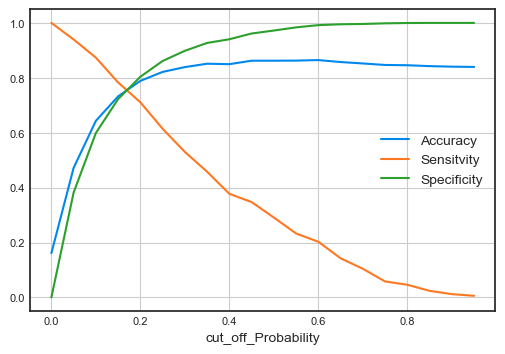

In [614]:
# Ploting 'Accuracy' , 'Sensitivity' and 'Specificity' for various probabilities(0.0 to 0.95).

df_cutoffs.plot.line(x='cut_off_Probability', y=['Accuracy','Sensitvity','Specificity'])   # line plotting
plt.grid()
plt.show()

In [615]:
y_pred_test=lr.predict_proba(X_test[X_train.columns])     # Predicting the final test set
y_pred_test = y_pred_test[:,1]

# Creating a new dataset and saving the prediction values in it

y_test_pred_final=pd.DataFrame({'Attrition':y_test.values,'Attrition_prob':y_pred_test,'ID':y_test.index})

# Predicting the outcomes with probability cutoff as 0.2 by creating new columns in the final test dataset

y_test_pred_final['Predicted']=y_test_pred_final['Attrition_prob'].map(lambda x:1 if x >0.2 else 0 )  # Predicted value 

y_test_pred_final.head()


,Attrition,Attrition_prob,ID,Predicted
0,0,0.259978,2778,1
1,0,0.063575,410,0
2,0,0.050462,3423,0
3,0,0.018719,2170,0
4,0,0.286360,4341,1


In [616]:
# Checking the accuracy of the test dataset.

print('Accuracy score in test dataset :', round(metrics.accuracy_score(y_test_pred_final.Attrition, y_test_pred_final.Predicted),3))   # Printing the score



tn, fp, fn, tp = confusion_matrix(y_test_pred_final.Attrition, y_test_pred_final.Predicted).ravel()
sensitivity = tp / (fn+tp)
specificity = tn / (tn+fp)
print('Sensitivity in test dataset:', round(sensitivity,2))   # Printing the sensitivity
print('Specificity in test dataset:', round(specificity,2))   # Printing specificity

Accuracy score in test dataset : 0.782
Sensitivity in test dataset: 0.71
Specificity in test dataset: 0.8
Executing shutdown due to inactivity...
Executing shutdown due to inactivity...
Executing shutdown due to inactivity...


2021-07-17 17:59:36,955 - INFO     - Executing shutdown due to inactivity...


Executing shutdown...
Executing shutdown...
Executing shutdown...


2021-07-17 17:59:41,232 - INFO     - Executing shutdown...
